In [23]:
from itertools import islice
import os

import torch
from torchvision import models, transforms, datasets
import numpy as np
import matplotlib.pyplot as plt

import data_util
from models.finetuned_resnet import FinetunedResnet
import constants

import torchvision.transforms.functional as F
from PIL import Image

from data_util import weeds_to_imagenet_transforms
from torch.utils.data.dataset import Subset


plt.rcParams["figure.figsize"] = (20,10)
np.set_printoptions(suppress=True)


In [4]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [6]:
final_model = FinetunedResnet(models.resnet101, constants.NUM_CLASSES, device)
final_model.model.load_state_dict(torch.load('logs/2019-06-03_00-34-42/model_dict_149.pth'))
final_model.model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [16]:
data_transform = transforms.Compose(weeds_to_imagenet_transforms)

test_dataset = datasets.ImageFolder(os.path.join(constants.DATA_DIR, 'test'), data_transform)

test_indices = range(len(test_dataset))

test_set = Subset(test_dataset, test_indices)
sets =  {'test' : test_set}

# Create training and validation dataloaders
dataloaders = {x: torch.utils.data.DataLoader(
    sets[x], batch_size=64, shuffle=False, num_workers=4)
    for x in ['test',]}

dataloader_test = dataloaders['test']

In [24]:
num_classes = constants.NUM_CLASSES
running_corrects = 0
confusion_matrix = np.zeros((num_classes, num_classes))

# Iterate over data.
for inputs, labels in dataloader_test:
    inputs = inputs.to(device)
    labels = labels.to(device)

    with torch.set_grad_enabled(False):
        # Get model outputs and calculate loss
        outputs = final_model.model(inputs)
        _, preds = torch.max(outputs, 1)

    running_corrects += torch.sum(preds == labels.data)
    for label, pred in zip(labels.data, preds):
        confusion_matrix[label, pred] += 1

accuracy = running_corrects.double() / len(dataloader_test.dataset)

print('Acc: {:.4f}'.format(accuracy))

for i in range(num_classes):
    print('Class {} ({}): Accuracy {}/{} ({}%)'.format(
        i, dataloader_test.dataset.dataset.classes[i], confusion_matrix[i,i],
        confusion_matrix[i].sum(), 100.*confusion_matrix[i,i]/confusion_matrix[i].sum()))
    
print(confusion_matrix)

Acc: 0.9635
Class 0 (chinee_apple): Accuracy 212.0/226.0 (93.80530973451327%)
Class 1 (lantana): Accuracy 203.0/213.0 (95.30516431924883%)
Class 2 (negatives): Accuracy 1800.0/1822.0 (98.79253567508233%)
Class 3 (parkinsonia): Accuracy 206.0/207.0 (99.51690821256038%)
Class 4 (parthenium): Accuracy 192.0/205.0 (93.65853658536585%)
Class 5 (prickly_acacia): Accuracy 195.0/213.0 (91.54929577464789%)
Class 6 (rubber_vine): Accuracy 195.0/202.0 (96.53465346534654%)
Class 7 (siam_weed): Accuracy 205.0/215.0 (95.34883720930233%)
Class 8 (snake_weed): Accuracy 171.0/204.0 (83.82352941176471%)
[[ 212.    0.   12.    0.    0.    0.    2.    0.    0.]
 [   0.  203.    9.    0.    0.    0.    0.    1.    0.]
 [   3.    2. 1800.    0.    0.    4.    7.    5.    1.]
 [   1.    0.    0.  206.    0.    0.    0.    0.    0.]
 [   1.    0.    7.    3.  192.    2.    0.    0.    0.]
 [   3.    0.   11.    2.    1.  195.    0.    0.    1.]
 [   0.    0.    7.    0.    0.    0.  195.    0.    0.]
 [   0. 

In [25]:
WEED_CLASS_NAMES = ['chinee_apple',
               'lantana',
               'parkinsonia',
               'parthenium',
               'prickly_acacia',
               'rubber_vine',
               'siam_weed',
               'snake_weed']

class_names = ['chinee_apple', 'lantana', 'negatives', 'parkinsonia', 'parthenium', 'prickly_acacia', 'rubber_vine', 'siam_weed', 'snake_weed']

In [38]:
xs = []
burn_ys = []
ys = []
for c in WEED_CLASS_NAMES:
    with open('deep_weeds_dataset/test/{}/burn_labels.txt'.format(c)) as f:
        lines = f.readlines()
    for i in range(5):
        ys.append(class_names.index(c))
        xs.append(lines[i*9].strip())
        labels = np.zeros((7,7))
        for j in range(7):
            #print(lines[i*9 + j + 1].split('\t'))
            labels[j] = lines[i*9 + j + 1].split('\t')
        burn_ys.append(labels)


In [36]:
transform = transforms.Compose(weeds_to_imagenet_transforms)


def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')

40
torch.Size([9, 7, 7])
Class predictions:  tensor([9.9539e-01, 1.2515e-03, 2.6569e-03, 1.1556e-04, 6.7734e-06, 2.5577e-04,
        1.1345e-04, 1.0299e-04, 1.0875e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.5048, 0.0094, 0.2144, 0.0326, 0.0006, 0.0993, 0.0969, 0.0367, 0.0053],
       device='cuda:0')
Class predictions according to model:  tensor([9.9539e-01, 1.2515e-03, 2.6569e-03, 1.1556e-04, 6.7734e-06, 2.5577e-04,
        1.1345e-04, 1.0299e-04, 1.0875e-04], device='cuda:0')
tensor([[0.1615, 0.1615, 0.1615,  ..., 0.9202, 0.9202, 0.9202],
        [0.1615, 0.1615, 0.1615,  ..., 0.9202, 0.9202, 0.9202],
        [0.1615, 0.1615, 0.1615,  ..., 0.9202, 0.9202, 0.9202],
        ...,
        [0.9999, 0.9999, 0.9999,  ..., 0.1136, 0.1136, 0.1136],
        [0.9999, 0.9999, 0.9999,  ..., 0.1136, 0.1136, 0.1136],
        [0.9999, 0.9999, 0.9999,  ..., 0.1136, 0.1136, 0.1136]]) tensor(0.7856)


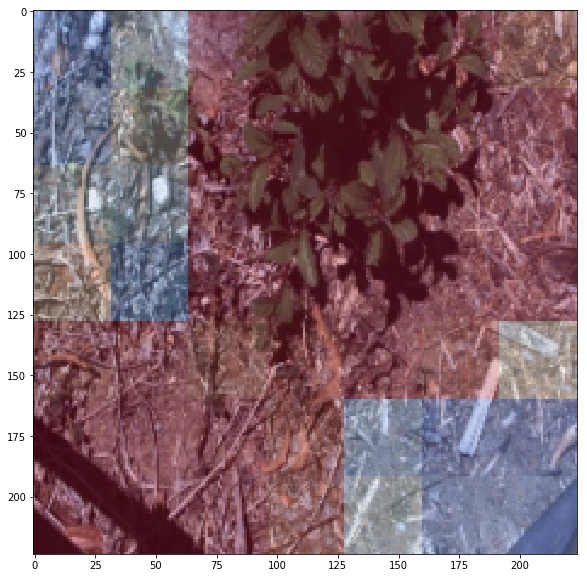

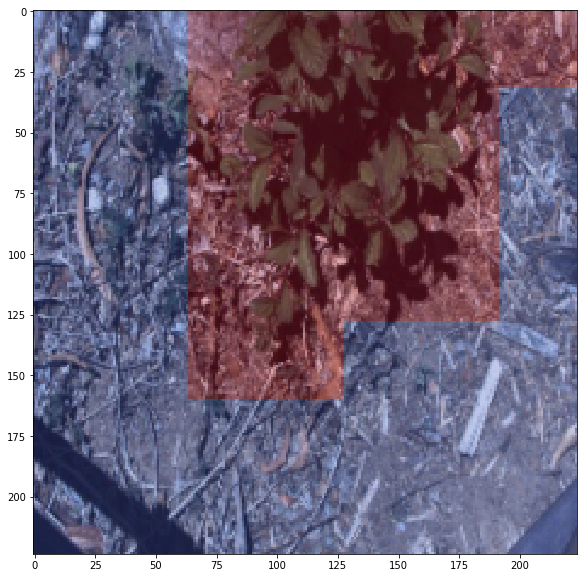

torch.Size([9, 7, 7])
Class predictions:  tensor([9.6670e-01, 1.9464e-04, 3.2927e-02, 2.5909e-05, 3.0859e-05, 3.2930e-05,
        4.1550e-05, 8.7170e-06, 3.4091e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.5340e-01, 1.9242e-03, 5.3930e-01, 3.9798e-04, 5.6110e-04, 5.8753e-04,
        1.0143e-03, 2.0723e-04, 2.6089e-03], device='cuda:0')
Class predictions according to model:  tensor([9.6670e-01, 1.9464e-04, 3.2927e-02, 2.5909e-05, 3.0859e-05, 3.2930e-05,
        4.1550e-05, 8.7170e-06, 3.4091e-05], device='cuda:0')
tensor([[0.7480, 0.7480, 0.7480,  ..., 0.0058, 0.0058, 0.0058],
        [0.7480, 0.7480, 0.7480,  ..., 0.0058, 0.0058, 0.0058],
        [0.7480, 0.7480, 0.7480,  ..., 0.0058, 0.0058, 0.0058],
        ...,
        [0.0305, 0.0305, 0.0305,  ..., 0.0544, 0.0544, 0.0544],
        [0.0305, 0.0305, 0.0305,  ..., 0.0544, 0.0544, 0.0544],
        [0.0305, 0.0305, 0.0305,  ..., 0.0544, 0.0544, 0.0544]]) tensor(0.4607)


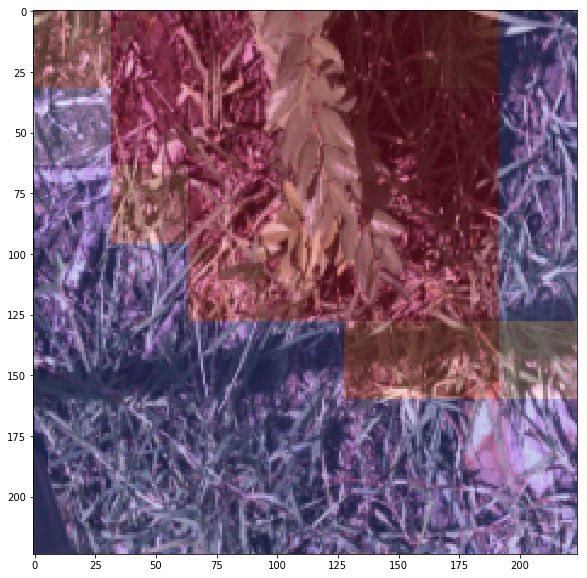

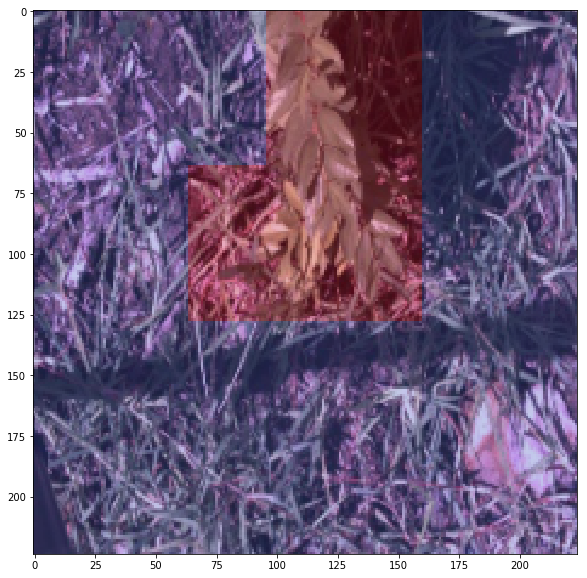

torch.Size([9, 7, 7])
Class predictions:  tensor([9.7146e-01, 2.4252e-05, 2.6249e-02, 3.8612e-05, 1.3681e-03, 1.2258e-05,
        6.4857e-04, 1.8291e-06, 2.0229e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.8706e-01, 7.6451e-04, 2.9674e-01, 3.1346e-03, 5.9560e-02, 4.0031e-02,
        1.1828e-02, 7.4054e-05, 8.0317e-04], device='cuda:0')
Class predictions according to model:  tensor([9.7146e-01, 2.4252e-05, 2.6249e-02, 3.8612e-05, 1.3681e-03, 1.2258e-05,
        6.4857e-04, 1.8291e-06, 2.0229e-04], device='cuda:0')
tensor([[0.1122, 0.1122, 0.1122,  ..., 0.8355, 0.8355, 0.8355],
        [0.1122, 0.1122, 0.1122,  ..., 0.8355, 0.8355, 0.8355],
        [0.1122, 0.1122, 0.1122,  ..., 0.8355, 0.8355, 0.8355],
        ...,
        [0.4779, 0.4779, 0.4779,  ..., 0.9965, 0.9965, 0.9965],
        [0.4779, 0.4779, 0.4779,  ..., 0.9965, 0.9965, 0.9965],
        [0.4779, 0.4779, 0.4779,  ..., 0.9965, 0.9965, 0.9965]]) tensor(0.7033)


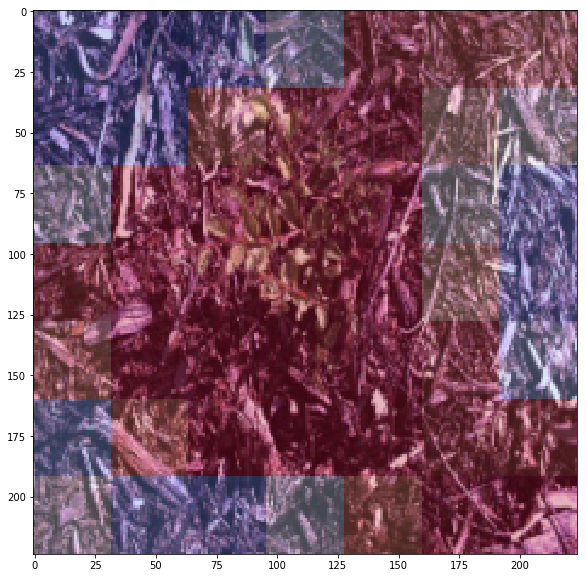

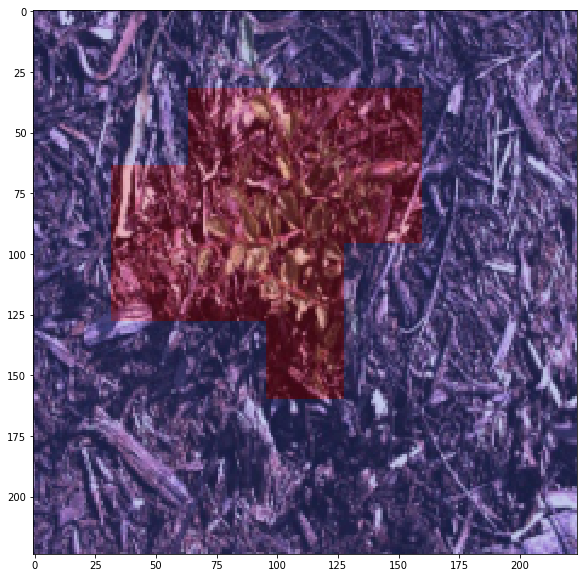

torch.Size([9, 7, 7])
Class predictions:  tensor([5.0335e-03, 1.5677e-03, 5.1025e-01, 4.8620e-04, 1.5106e-04, 4.1355e-03,
        7.3045e-05, 4.7760e-01, 6.9325e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0133, 0.0105, 0.4530, 0.0225, 0.0016, 0.0463, 0.0014, 0.4491, 0.0023],
       device='cuda:0')
Class predictions according to model:  tensor([5.0335e-03, 1.5677e-03, 5.1025e-01, 4.8620e-04, 1.5106e-04, 4.1355e-03,
        7.3045e-05, 4.7760e-01, 6.9325e-04], device='cuda:0')
tensor([[0.2516, 0.2516, 0.2516,  ..., 0.5614, 0.5614, 0.5614],
        [0.2516, 0.2516, 0.2516,  ..., 0.5614, 0.5614, 0.5614],
        [0.2516, 0.2516, 0.2516,  ..., 0.5614, 0.5614, 0.5614],
        ...,
        [0.1631, 0.1631, 0.1631,  ..., 0.5739, 0.5739, 0.5739],
        [0.1631, 0.1631, 0.1631,  ..., 0.5739, 0.5739, 0.5739],
        [0.1631, 0.1631, 0.1631,  ..., 0.5739, 0.5739, 0.5739]]) tensor(0.5470)


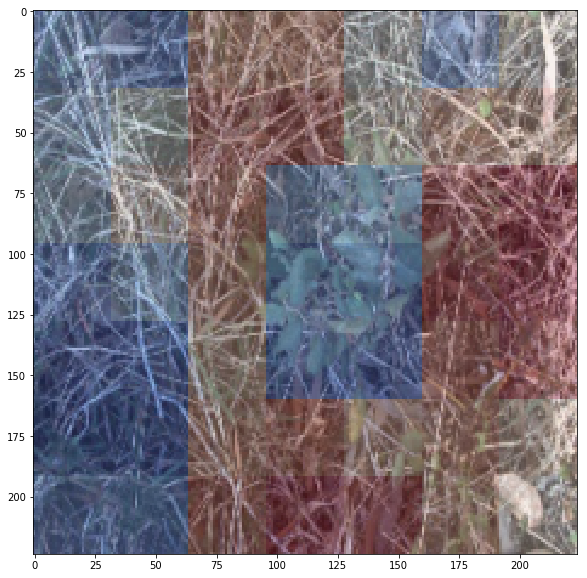

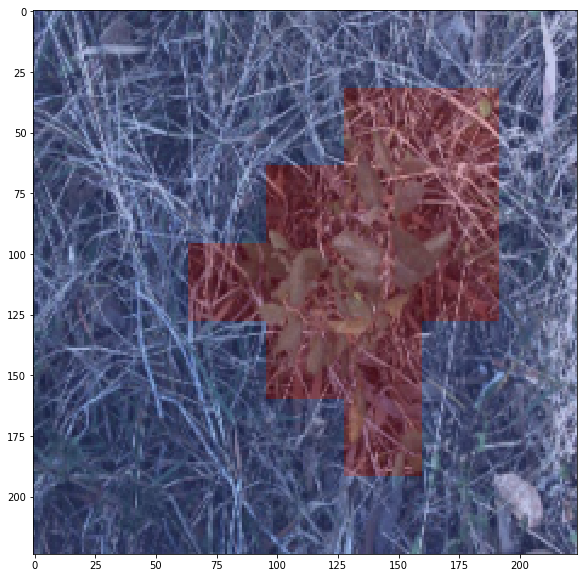

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0283e-03, 2.8836e-04, 9.9760e-01, 7.6554e-06, 6.9237e-05, 2.3866e-06,
        5.6632e-06, 4.0889e-05, 9.5948e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.3695e-01, 2.0071e-02, 7.4069e-01, 1.3615e-03, 4.7881e-04, 7.9528e-05,
        3.2738e-05, 1.0777e-02, 8.9561e-02], device='cuda:0')
Class predictions according to model:  tensor([1.0283e-03, 2.8836e-04, 9.9760e-01, 7.6553e-06, 6.9237e-05, 2.3866e-06,
        5.6632e-06, 4.0889e-05, 9.5948e-04], device='cuda:0')
tensor([[2.3128e-01, 2.3128e-01, 2.3128e-01,  ..., 5.9485e-05, 5.9485e-05,
         5.9485e-05],
        [2.3128e-01, 2.3128e-01, 2.3128e-01,  ..., 5.9485e-05, 5.9485e-05,
         5.9485e-05],
        [2.3128e-01, 2.3128e-01, 2.3128e-01,  ..., 5.9485e-05, 5.9485e-05,
         5.9485e-05],
        ...,
        [2.6784e-01, 2.6784e-01, 2.6784e-01,  ..., 4.8097e-01, 4.8097e-01,
         4.8097e-01],
        [2.6784e-01, 2.6784e-01, 2.67

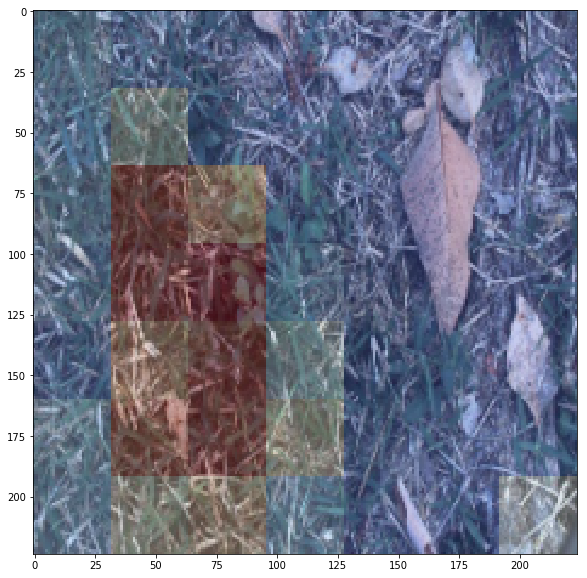

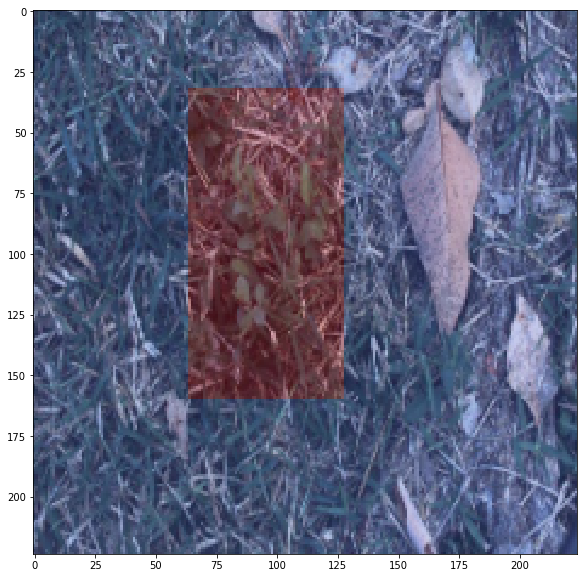

torch.Size([9, 7, 7])
Class predictions:  tensor([1.6532e-04, 9.9933e-01, 3.5026e-04, 6.1077e-06, 5.4779e-05, 5.0926e-06,
        4.8693e-05, 9.3132e-06, 2.9235e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.8897e-04, 7.2367e-01, 2.0541e-01, 6.5740e-04, 5.7078e-02, 2.7424e-04,
        3.7188e-03, 3.4171e-03, 4.9812e-03], device='cuda:0')
Class predictions according to model:  tensor([1.6532e-04, 9.9933e-01, 3.5026e-04, 6.1077e-06, 5.4779e-05, 5.0926e-06,
        4.8693e-05, 9.3132e-06, 2.9235e-05], device='cuda:0')
tensor([[0.0105, 0.0105, 0.0105,  ..., 1.0000, 1.0000, 1.0000],
        [0.0105, 0.0105, 0.0105,  ..., 1.0000, 1.0000, 1.0000],
        [0.0105, 0.0105, 0.0105,  ..., 1.0000, 1.0000, 1.0000],
        ...,
        [0.8665, 0.8665, 0.8665,  ..., 0.9301, 0.9301, 0.9301],
        [0.8665, 0.8665, 0.8665,  ..., 0.9301, 0.9301, 0.9301],
        [0.8665, 0.8665, 0.8665,  ..., 0.9301, 0.9301, 0.9301]]) tensor(0.7946)


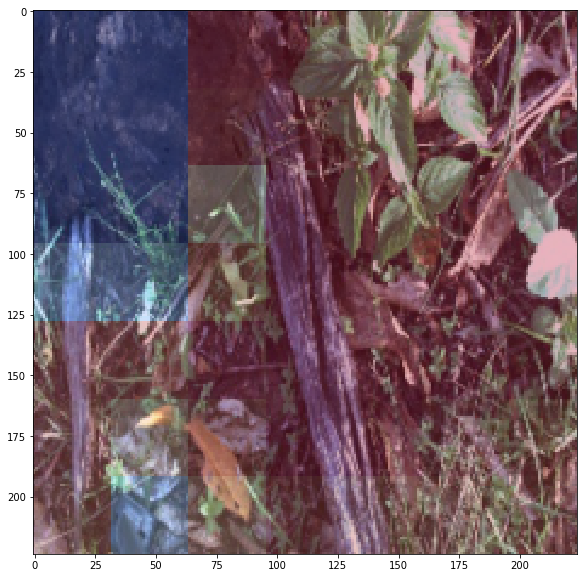

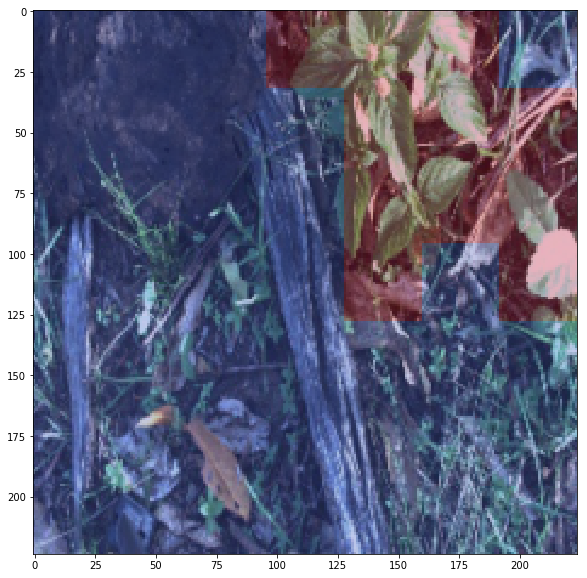

torch.Size([9, 7, 7])
Class predictions:  tensor([6.0859e-04, 9.6538e-01, 3.3038e-02, 3.0856e-05, 8.4696e-05, 1.4542e-05,
        3.1814e-04, 4.4875e-04, 7.1354e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.7792e-03, 5.1734e-01, 4.5790e-01, 6.7008e-04, 2.6881e-03, 3.4058e-04,
        9.7688e-04, 1.1158e-02, 5.1502e-03], device='cuda:0')
Class predictions according to model:  tensor([6.0859e-04, 9.6538e-01, 3.3038e-02, 3.0856e-05, 8.4696e-05, 1.4542e-05,
        3.1814e-04, 4.4875e-04, 7.1354e-05], device='cuda:0')
tensor([[0.1467, 0.1467, 0.1467,  ..., 0.9932, 0.9932, 0.9932],
        [0.1467, 0.1467, 0.1467,  ..., 0.9932, 0.9932, 0.9932],
        [0.1467, 0.1467, 0.1467,  ..., 0.9932, 0.9932, 0.9932],
        ...,
        [0.1014, 0.1014, 0.1014,  ..., 0.3505, 0.3505, 0.3505],
        [0.1014, 0.1014, 0.1014,  ..., 0.3505, 0.3505, 0.3505],
        [0.1014, 0.1014, 0.1014,  ..., 0.3505, 0.3505, 0.3505]]) tensor(0.5421)


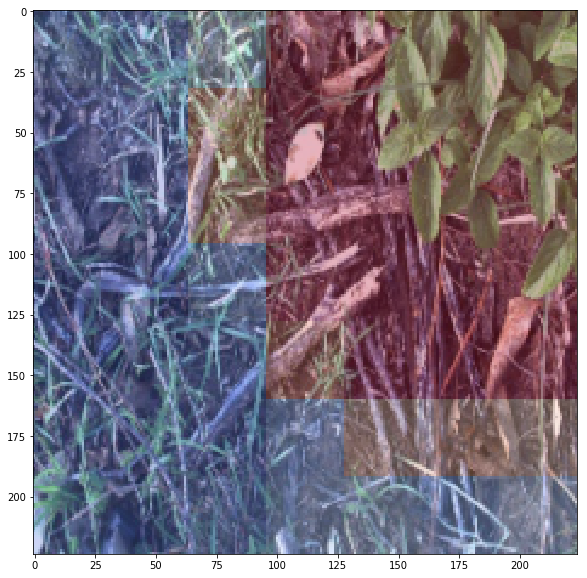

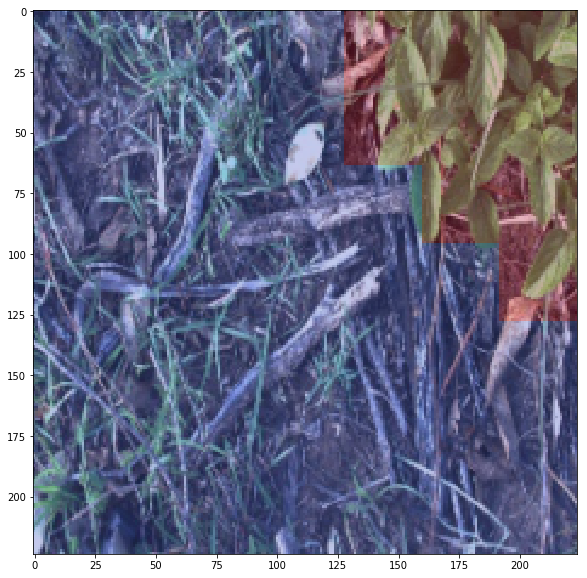

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0844e-05, 9.9718e-01, 2.7720e-03, 7.9852e-06, 1.5066e-06, 8.3547e-07,
        9.1499e-06, 7.8856e-06, 1.1739e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.9488e-04, 8.7240e-01, 1.2187e-01, 3.7039e-03, 1.8549e-04, 6.8889e-05,
        6.1987e-04, 2.8480e-04, 4.7671e-04], device='cuda:0')
Class predictions according to model:  tensor([1.0844e-05, 9.9718e-01, 2.7720e-03, 7.9852e-06, 1.5066e-06, 8.3547e-07,
        9.1499e-06, 7.8856e-06, 1.1739e-05], device='cuda:0')
tensor([[0.7663, 0.7663, 0.7663,  ..., 0.9927, 0.9927, 0.9927],
        [0.7663, 0.7663, 0.7663,  ..., 0.9927, 0.9927, 0.9927],
        [0.7663, 0.7663, 0.7663,  ..., 0.9927, 0.9927, 0.9927],
        ...,
        [0.7941, 0.7941, 0.7941,  ..., 0.6661, 0.6661, 0.6661],
        [0.7941, 0.7941, 0.7941,  ..., 0.6661, 0.6661, 0.6661],
        [0.7941, 0.7941, 0.7941,  ..., 0.6661, 0.6661, 0.6661]]) tensor(0.8781)


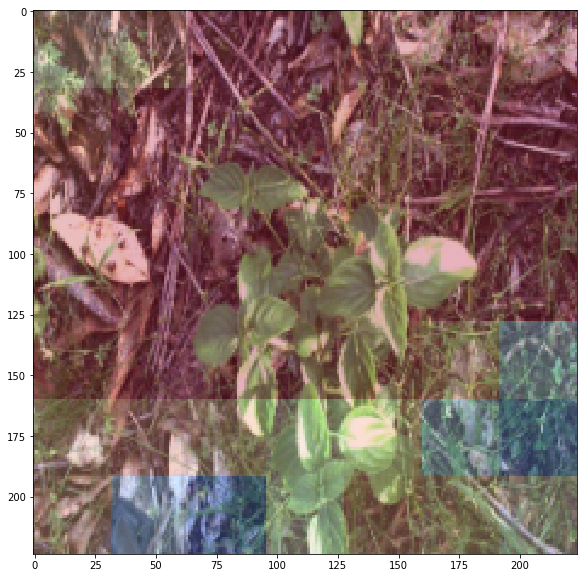

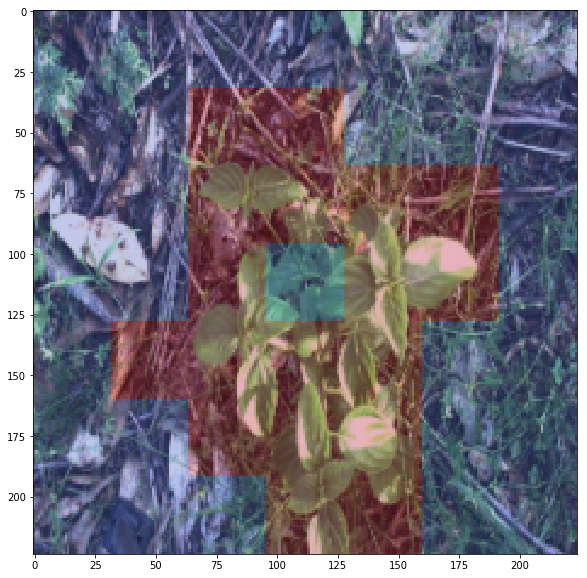

torch.Size([9, 7, 7])
Class predictions:  tensor([3.5571e-06, 9.9986e-01, 1.2672e-04, 3.2223e-07, 5.0008e-07, 1.7806e-07,
        6.2923e-07, 6.2292e-06, 3.0999e-07], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.6967e-03, 6.4942e-01, 3.4143e-01, 1.5998e-03, 1.9187e-03, 3.0857e-04,
        7.8512e-04, 2.4382e-03, 3.9742e-04], device='cuda:0')
Class predictions according to model:  tensor([3.5571e-06, 9.9986e-01, 1.2672e-04, 3.2223e-07, 5.0008e-07, 1.7806e-07,
        6.2923e-07, 6.2292e-06, 3.0999e-07], device='cuda:0')
tensor([[0.3808, 0.3808, 0.3808,  ..., 0.1340, 0.1340, 0.1340],
        [0.3808, 0.3808, 0.3808,  ..., 0.1340, 0.1340, 0.1340],
        [0.3808, 0.3808, 0.3808,  ..., 0.1340, 0.1340, 0.1340],
        ...,
        [0.8596, 0.8596, 0.8596,  ..., 1.0000, 1.0000, 1.0000],
        [0.8596, 0.8596, 0.8596,  ..., 1.0000, 1.0000, 1.0000],
        [0.8596, 0.8596, 0.8596,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.6586)


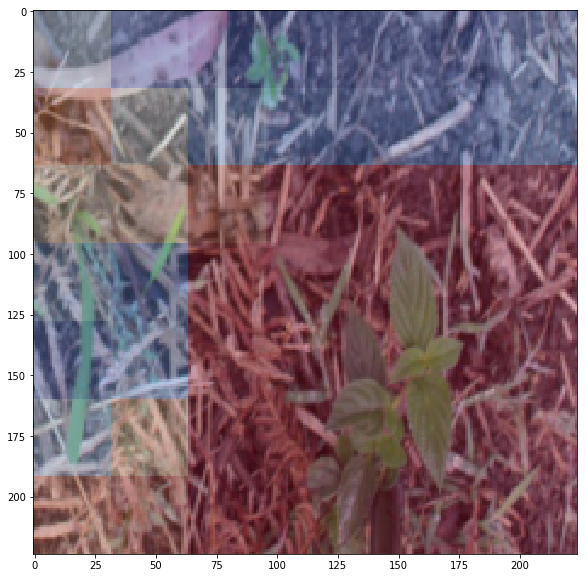

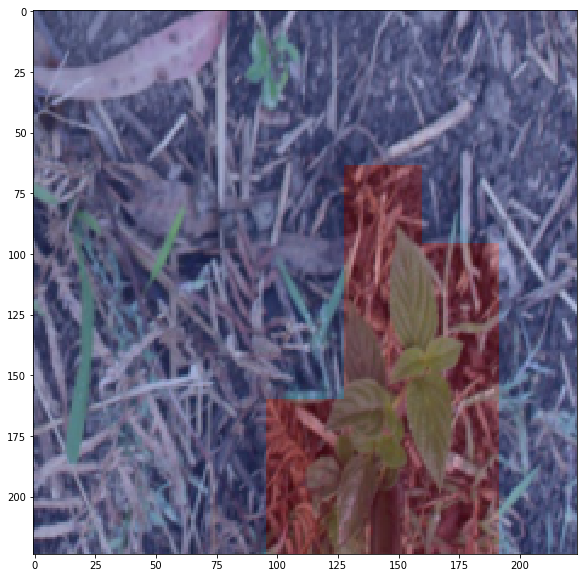

torch.Size([9, 7, 7])
Class predictions:  tensor([1.1178e-03, 7.0493e-01, 4.0091e-02, 2.0973e-05, 1.3114e-03, 3.5976e-05,
        2.7582e-04, 1.7366e-03, 2.5048e-01], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0101, 0.4077, 0.1993, 0.0020, 0.0151, 0.0048, 0.0040, 0.0355, 0.3216],
       device='cuda:0')
Class predictions according to model:  tensor([1.1178e-03, 7.0493e-01, 4.0091e-02, 2.0973e-05, 1.3114e-03, 3.5976e-05,
        2.7582e-04, 1.7366e-03, 2.5048e-01], device='cuda:0')
tensor([[0.8985, 0.8985, 0.8985,  ..., 1.0000, 1.0000, 1.0000],
        [0.8985, 0.8985, 0.8985,  ..., 1.0000, 1.0000, 1.0000],
        [0.8985, 0.8985, 0.8985,  ..., 1.0000, 1.0000, 1.0000],
        ...,
        [0.7025, 0.7025, 0.7025,  ..., 0.1634, 0.1634, 0.1634],
        [0.7025, 0.7025, 0.7025,  ..., 0.1634, 0.1634, 0.1634],
        [0.7025, 0.7025, 0.7025,  ..., 0.1634, 0.1634, 0.1634]]) tensor(0.8007)


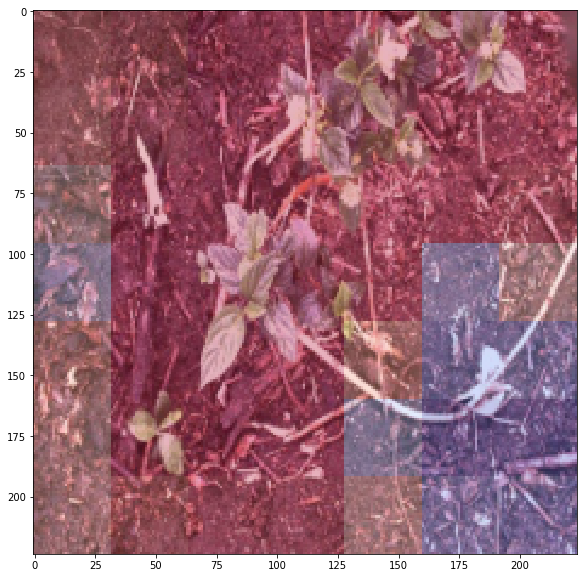

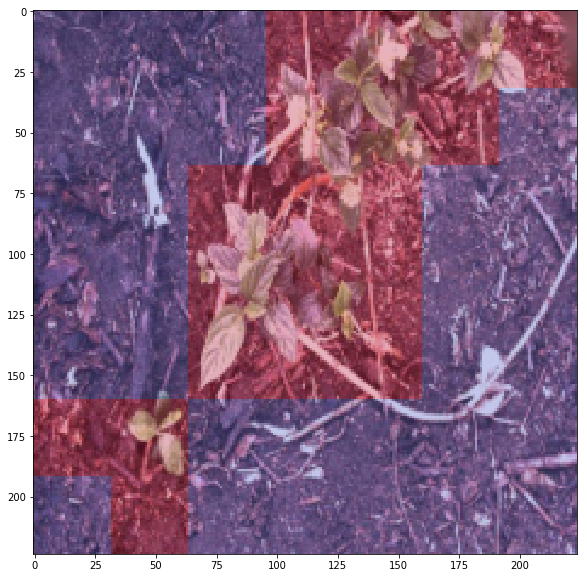

torch.Size([9, 7, 7])
Class predictions:  tensor([1.8429e-05, 3.1487e-05, 2.5529e-02, 9.7375e-01, 3.3424e-05, 4.4985e-04,
        1.0445e-05, 1.5608e-04, 2.3292e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.1914e-04, 6.8374e-04, 5.0083e-01, 4.7942e-01, 4.0427e-04, 1.2637e-02,
        9.2275e-05, 5.4299e-03, 3.7937e-04], device='cuda:0')
Class predictions according to model:  tensor([1.8429e-05, 3.1487e-05, 2.5529e-02, 9.7375e-01, 3.3424e-05, 4.4985e-04,
        1.0445e-05, 1.5608e-04, 2.3292e-05], device='cuda:0')
tensor([[1.0000, 1.0000, 1.0000,  ..., 0.9923, 0.9923, 0.9923],
        [1.0000, 1.0000, 1.0000,  ..., 0.9923, 0.9923, 0.9923],
        [1.0000, 1.0000, 1.0000,  ..., 0.9923, 0.9923, 0.9923],
        ...,
        [0.1333, 0.1333, 0.1333,  ..., 0.4751, 0.4751, 0.4751],
        [0.1333, 0.1333, 0.1333,  ..., 0.4751, 0.4751, 0.4751],
        [0.1333, 0.1333, 0.1333,  ..., 0.4751, 0.4751, 0.4751]]) tensor(0.4992)


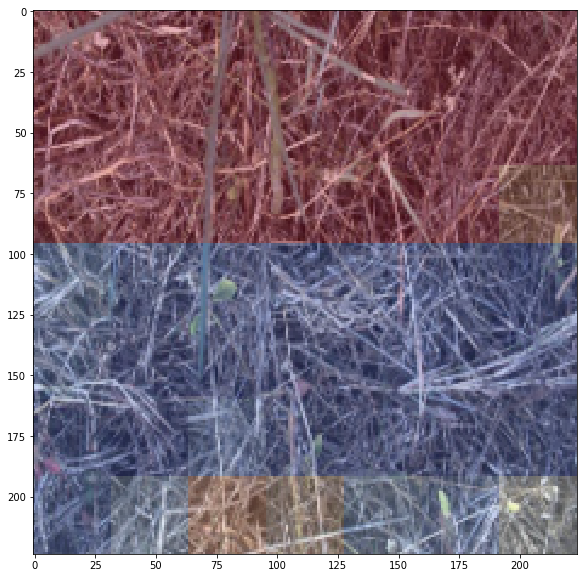

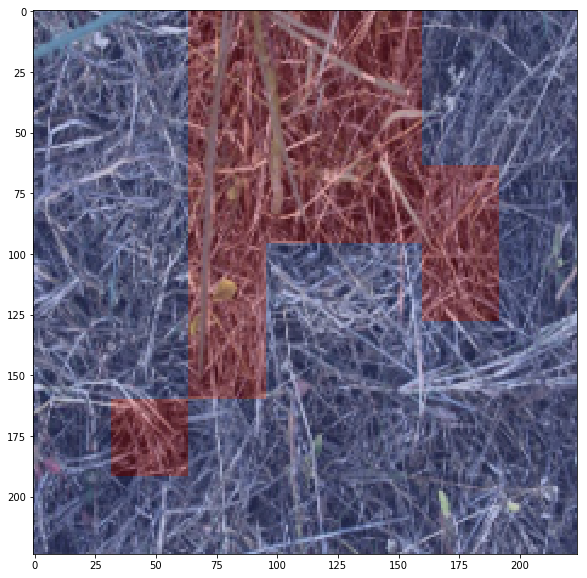

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0826e-05, 4.7082e-06, 6.3929e-04, 9.9927e-01, 1.2352e-05, 1.6504e-05,
        4.4273e-06, 1.0241e-05, 2.9653e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.7357e-04, 6.6461e-05, 6.0773e-03, 9.9230e-01, 1.4788e-04, 5.4895e-04,
        5.4076e-05, 1.6687e-04, 4.6883e-04], device='cuda:0')
Class predictions according to model:  tensor([1.0826e-05, 4.7082e-06, 6.3929e-04, 9.9927e-01, 1.2352e-05, 1.6504e-05,
        4.4273e-06, 1.0241e-05, 2.9653e-05], device='cuda:0')
tensor([[0.9980, 0.9980, 0.9980,  ..., 0.9949, 0.9949, 0.9949],
        [0.9980, 0.9980, 0.9980,  ..., 0.9949, 0.9949, 0.9949],
        [0.9980, 0.9980, 0.9980,  ..., 0.9949, 0.9949, 0.9949],
        ...,
        [0.9938, 0.9938, 0.9938,  ..., 0.9936, 0.9936, 0.9936],
        [0.9938, 0.9938, 0.9938,  ..., 0.9936, 0.9936, 0.9936],
        [0.9938, 0.9938, 0.9938,  ..., 0.9936, 0.9936, 0.9936]]) tensor(0.9939)


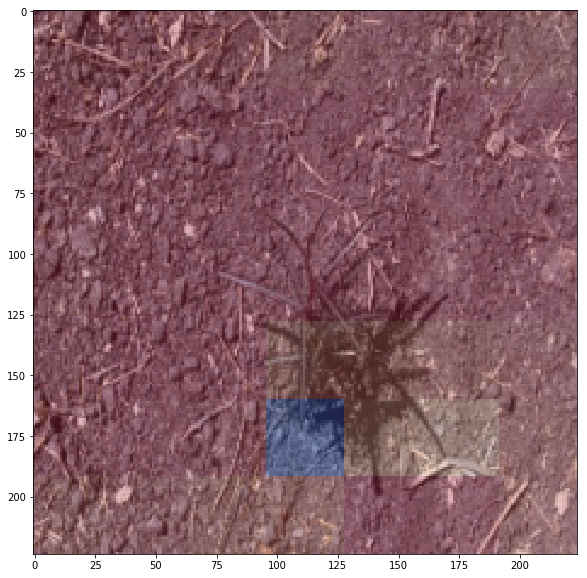

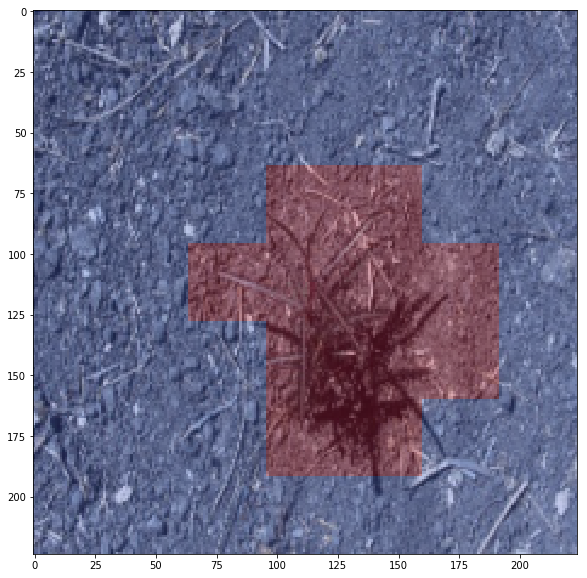

torch.Size([9, 7, 7])
Class predictions:  tensor([8.0263e-06, 1.3079e-06, 2.0337e-04, 9.9970e-01, 5.9327e-06, 5.7389e-05,
        1.0273e-06, 9.1769e-06, 1.2895e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.8326e-04, 1.4610e-04, 5.4346e-03, 9.6834e-01, 4.1926e-04, 1.7893e-02,
        1.8574e-04, 3.7812e-03, 3.2172e-03], device='cuda:0')
Class predictions according to model:  tensor([8.0263e-06, 1.3079e-06, 2.0337e-04, 9.9970e-01, 5.9327e-06, 5.7389e-05,
        1.0273e-06, 9.1769e-06, 1.2895e-05], device='cuda:0')
tensor([[0.9986, 0.9986, 0.9986,  ..., 0.9337, 0.9337, 0.9337],
        [0.9986, 0.9986, 0.9986,  ..., 0.9337, 0.9337, 0.9337],
        [0.9986, 0.9986, 0.9986,  ..., 0.9337, 0.9337, 0.9337],
        ...,
        [0.9597, 0.9597, 0.9597,  ..., 0.9986, 0.9986, 0.9986],
        [0.9597, 0.9597, 0.9597,  ..., 0.9986, 0.9986, 0.9986],
        [0.9597, 0.9597, 0.9597,  ..., 0.9986, 0.9986, 0.9986]]) tensor(0.9946)


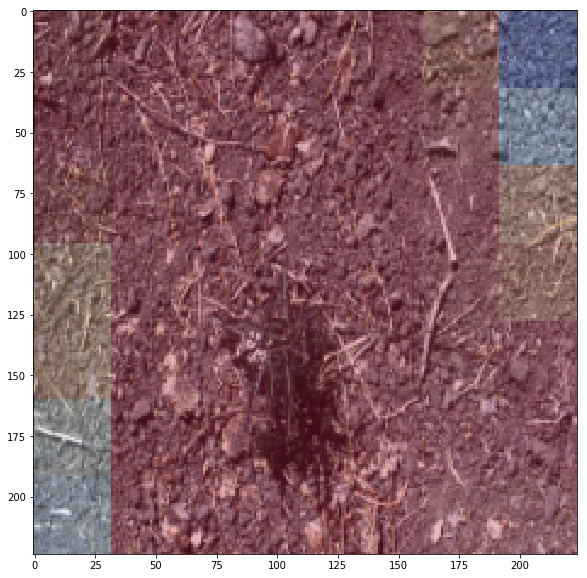

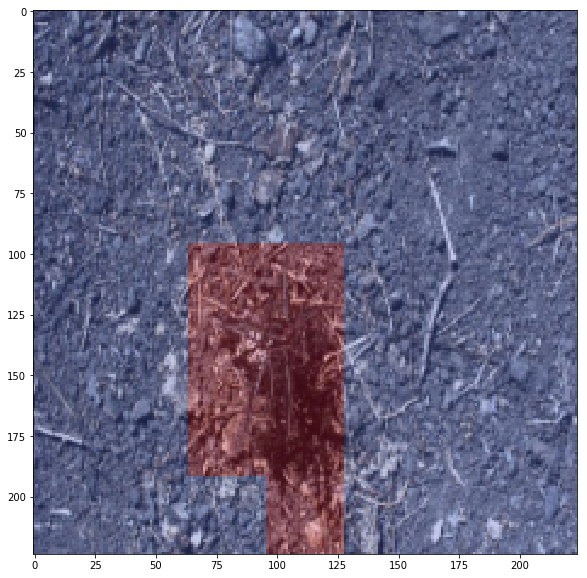

torch.Size([9, 7, 7])
Class predictions:  tensor([6.7887e-06, 4.2469e-06, 2.6349e-04, 9.9966e-01, 3.4024e-06, 1.1109e-05,
        2.8130e-06, 5.0505e-06, 3.9713e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.6618e-04, 4.4353e-05, 1.1598e-02, 9.8669e-01, 4.8121e-05, 1.9603e-04,
        9.7536e-05, 1.0825e-04, 9.4730e-04], device='cuda:0')
Class predictions according to model:  tensor([6.7887e-06, 4.2469e-06, 2.6349e-04, 9.9966e-01, 3.4024e-06, 1.1109e-05,
        2.8130e-06, 5.0505e-06, 3.9713e-05], device='cuda:0')
tensor([[0.9810, 0.9810, 0.9810,  ..., 0.9989, 0.9989, 0.9989],
        [0.9810, 0.9810, 0.9810,  ..., 0.9989, 0.9989, 0.9989],
        [0.9810, 0.9810, 0.9810,  ..., 0.9989, 0.9989, 0.9989],
        ...,
        [0.9938, 0.9938, 0.9938,  ..., 0.9999, 0.9999, 0.9999],
        [0.9938, 0.9938, 0.9938,  ..., 0.9999, 0.9999, 0.9999],
        [0.9938, 0.9938, 0.9938,  ..., 0.9999, 0.9999, 0.9999]]) tensor(0.9884)


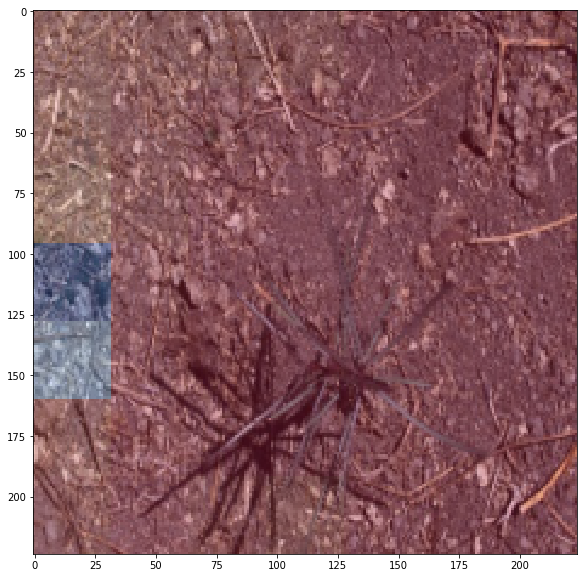

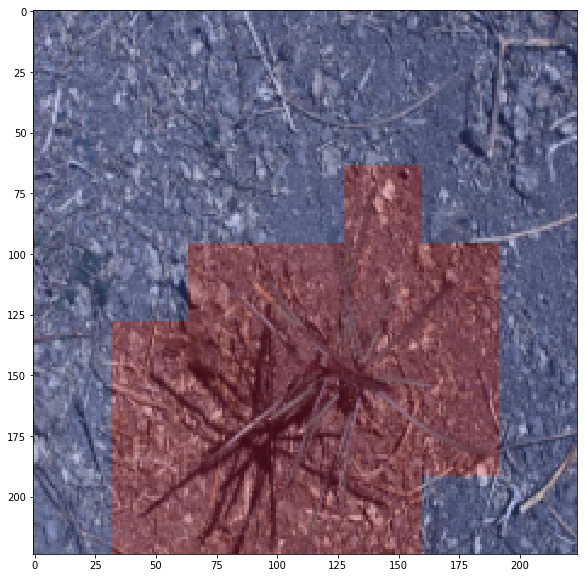

torch.Size([9, 7, 7])
Class predictions:  tensor([6.4753e-07, 2.7238e-07, 5.3385e-06, 9.9999e-01, 2.9588e-07, 1.0472e-06,
        1.1688e-07, 3.8565e-07, 2.1276e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.1076e-04, 9.8121e-05, 3.0606e-02, 9.6371e-01, 7.3932e-05, 2.5895e-03,
        1.7346e-05, 1.3495e-03, 1.2447e-03], device='cuda:0')
Class predictions according to model:  tensor([6.4753e-07, 2.7238e-07, 5.3385e-06, 9.9999e-01, 2.9588e-07, 1.0472e-06,
        1.1688e-07, 3.8565e-07, 2.1276e-06], device='cuda:0')
tensor([[0.9410, 0.9410, 0.9410,  ..., 0.9917, 0.9917, 0.9917],
        [0.9410, 0.9410, 0.9410,  ..., 0.9917, 0.9917, 0.9917],
        [0.9410, 0.9410, 0.9410,  ..., 0.9917, 0.9917, 0.9917],
        ...,
        [0.0982, 0.0982, 0.0982,  ..., 1.0000, 1.0000, 1.0000],
        [0.0982, 0.0982, 0.0982,  ..., 1.0000, 1.0000, 1.0000],
        [0.0982, 0.0982, 0.0982,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.9694)


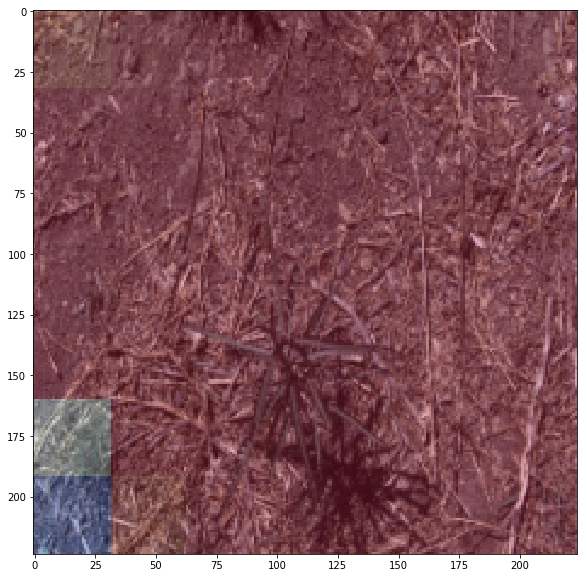

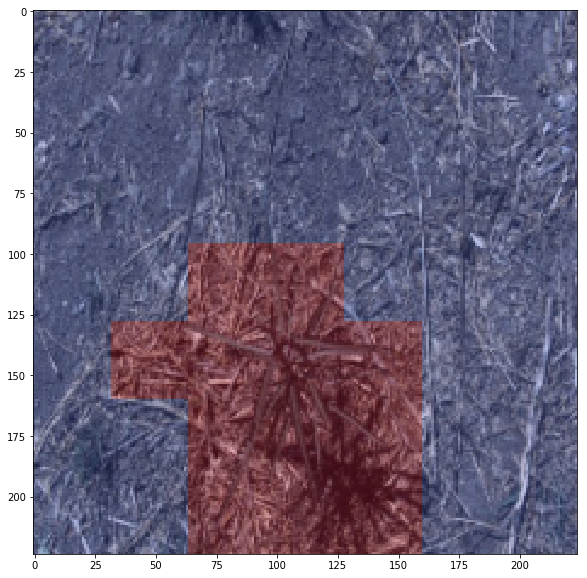

torch.Size([9, 7, 7])
Class predictions:  tensor([4.9145e-05, 4.0423e-04, 5.5273e-02, 4.8549e-05, 9.4344e-01, 1.4101e-05,
        1.7302e-05, 2.5366e-04, 4.9800e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.7415e-03, 7.3421e-03, 2.4569e-01, 2.4648e-02, 6.7392e-01, 6.2592e-03,
        6.3292e-04, 3.9259e-03, 3.2837e-02], device='cuda:0')
Class predictions according to model:  tensor([4.9145e-05, 4.0423e-04, 5.5273e-02, 4.8549e-05, 9.4344e-01, 1.4101e-05,
        1.7302e-05, 2.5366e-04, 4.9800e-04], device='cuda:0')
tensor([[0.8297, 0.8297, 0.8297,  ..., 0.9193, 0.9193, 0.9193],
        [0.8297, 0.8297, 0.8297,  ..., 0.9193, 0.9193, 0.9193],
        [0.8297, 0.8297, 0.8297,  ..., 0.9193, 0.9193, 0.9193],
        ...,
        [0.7605, 0.7605, 0.7605,  ..., 0.9750, 0.9750, 0.9750],
        [0.7605, 0.7605, 0.7605,  ..., 0.9750, 0.9750, 0.9750],
        [0.7605, 0.7605, 0.7605,  ..., 0.9750, 0.9750, 0.9750]]) tensor(0.7543)


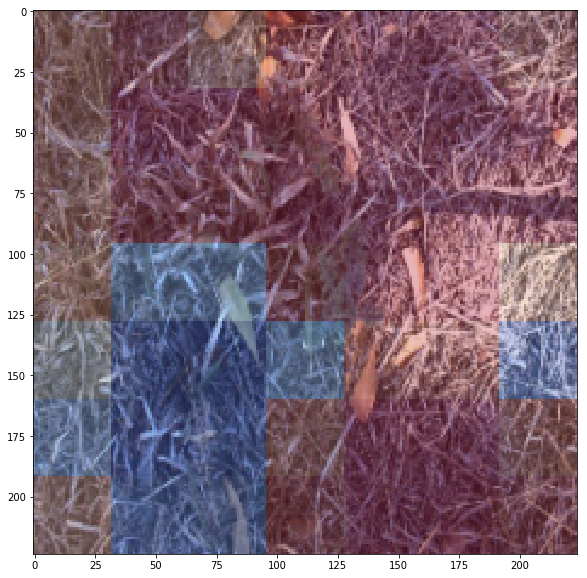

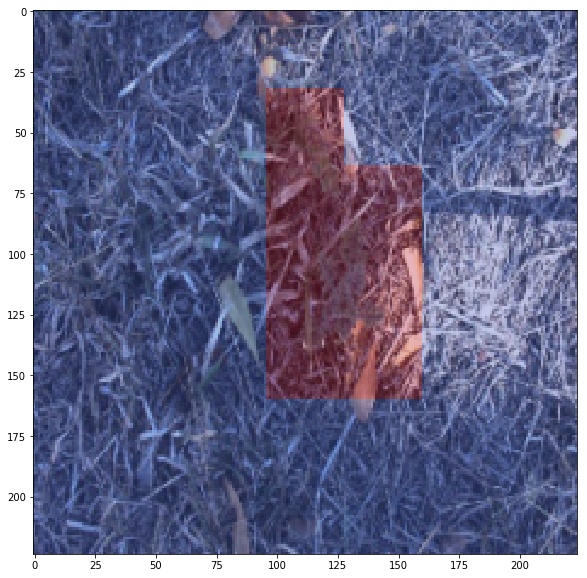

torch.Size([9, 7, 7])
Class predictions:  tensor([5.7321e-05, 1.3828e-05, 4.4138e-04, 9.9813e-01, 3.5436e-04, 8.7273e-04,
        4.5127e-05, 1.5369e-05, 7.3212e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.3526e-03, 3.6845e-04, 7.9860e-02, 7.8919e-01, 6.5309e-02, 2.0320e-02,
        3.7981e-02, 3.3663e-04, 4.2830e-03], device='cuda:0')
Class predictions according to model:  tensor([5.7321e-05, 1.3828e-05, 4.4138e-04, 9.9813e-01, 3.5436e-04, 8.7273e-04,
        4.5127e-05, 1.5369e-05, 7.3212e-05], device='cuda:0')
tensor([[0.8948, 0.8948, 0.8948,  ..., 1.0000, 1.0000, 1.0000],
        [0.8948, 0.8948, 0.8948,  ..., 1.0000, 1.0000, 1.0000],
        [0.8948, 0.8948, 0.8948,  ..., 1.0000, 1.0000, 1.0000],
        ...,
        [0.9530, 0.9530, 0.9530,  ..., 0.9991, 0.9991, 0.9991],
        [0.9530, 0.9530, 0.9530,  ..., 0.9991, 0.9991, 0.9991],
        [0.9530, 0.9530, 0.9530,  ..., 0.9991, 0.9991, 0.9991]]) tensor(0.9201)


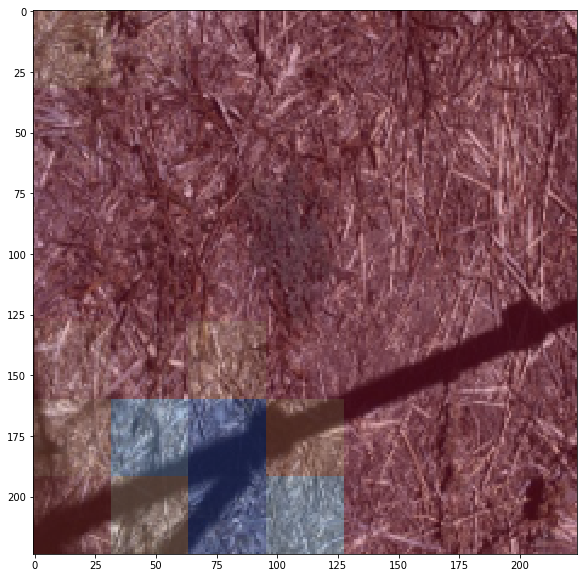

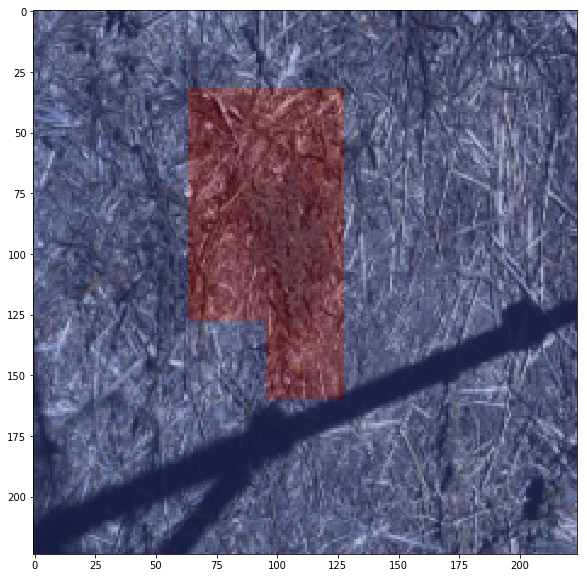

torch.Size([9, 7, 7])
Class predictions:  tensor([4.0241e-06, 3.1281e-06, 7.0763e-05, 6.6733e-06, 9.9977e-01, 3.8802e-05,
        4.2068e-05, 5.7247e-05, 6.6091e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0019, 0.0021, 0.1193, 0.0024, 0.6973, 0.1136, 0.0233, 0.0304, 0.0098],
       device='cuda:0')
Class predictions according to model:  tensor([4.0241e-06, 3.1281e-06, 7.0763e-05, 6.6733e-06, 9.9977e-01, 3.8802e-05,
        4.2068e-05, 5.7247e-05, 6.6091e-06], device='cuda:0')
tensor([[0.8328, 0.8328, 0.8328,  ..., 0.9510, 0.9510, 0.9510],
        [0.8328, 0.8328, 0.8328,  ..., 0.9510, 0.9510, 0.9510],
        [0.8328, 0.8328, 0.8328,  ..., 0.9510, 0.9510, 0.9510],
        ...,
        [0.9994, 0.9994, 0.9994,  ..., 0.9461, 0.9461, 0.9461],
        [0.9994, 0.9994, 0.9994,  ..., 0.9461, 0.9461, 0.9461],
        [0.9994, 0.9994, 0.9994,  ..., 0.9461, 0.9461, 0.9461]]) tensor(0.8807)


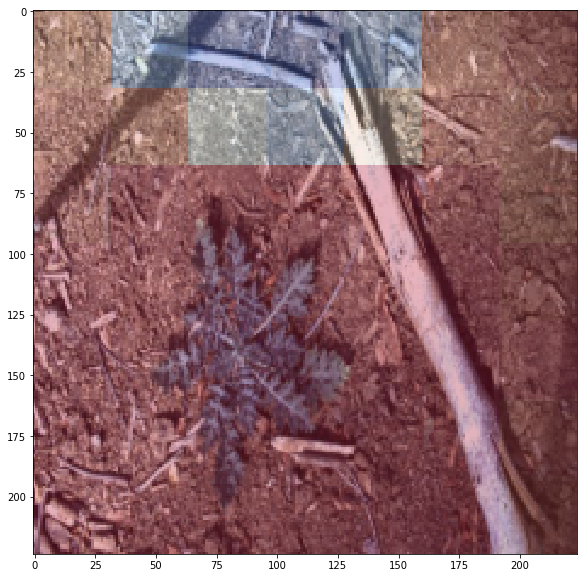

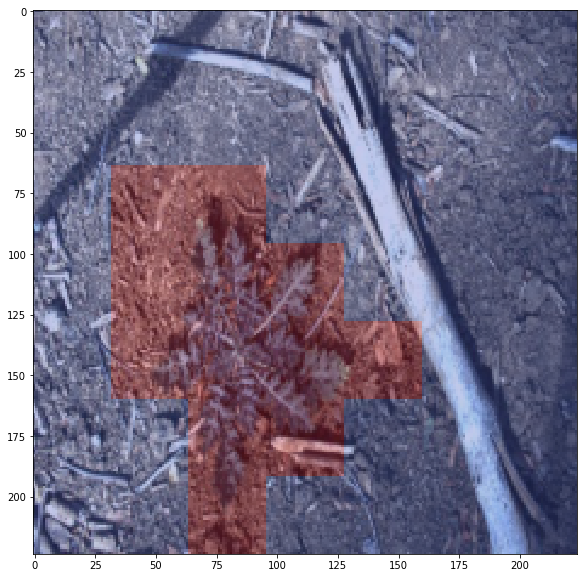

torch.Size([9, 7, 7])
Class predictions:  tensor([4.1633e-04, 2.8748e-04, 4.9784e-02, 8.4008e-06, 9.4926e-01, 7.1345e-06,
        3.5631e-05, 2.0014e-05, 1.8106e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.5032e-03, 7.9088e-03, 4.8152e-01, 7.0181e-05, 4.8854e-01, 1.7766e-04,
        1.2054e-02, 1.5904e-04, 4.0757e-03], device='cuda:0')
Class predictions according to model:  tensor([4.1633e-04, 2.8748e-04, 4.9784e-02, 8.4008e-06, 9.4926e-01, 7.1345e-06,
        3.5631e-05, 2.0014e-05, 1.8106e-04], device='cuda:0')
tensor([[0.0073, 0.0073, 0.0073,  ..., 0.0364, 0.0364, 0.0364],
        [0.0073, 0.0073, 0.0073,  ..., 0.0364, 0.0364, 0.0364],
        [0.0073, 0.0073, 0.0073,  ..., 0.0364, 0.0364, 0.0364],
        ...,
        [0.0131, 0.0131, 0.0131,  ..., 0.5931, 0.5931, 0.5931],
        [0.0131, 0.0131, 0.0131,  ..., 0.5931, 0.5931, 0.5931],
        [0.0131, 0.0131, 0.0131,  ..., 0.5931, 0.5931, 0.5931]]) tensor(0.5185)


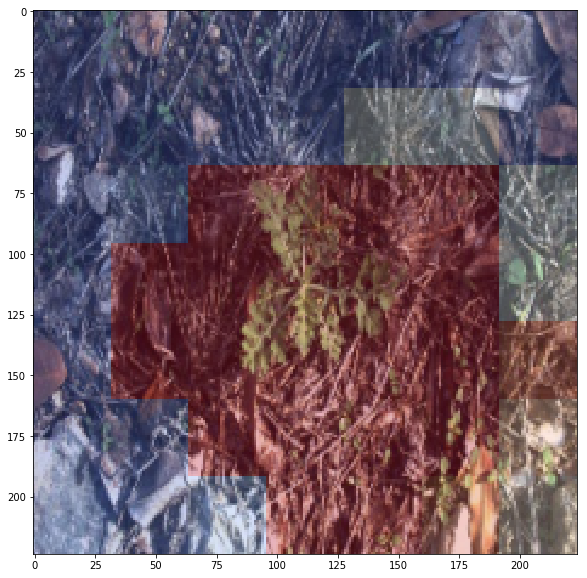

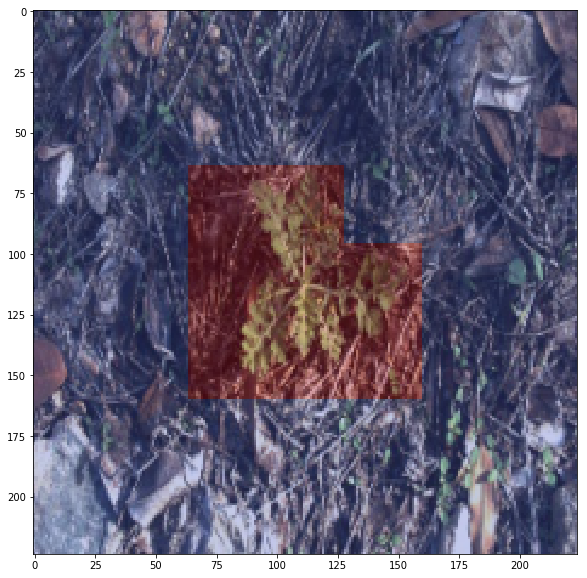

torch.Size([9, 7, 7])
Class predictions:  tensor([5.0438e-04, 2.0145e-05, 7.6406e-04, 5.0307e-05, 9.9817e-01, 2.1520e-05,
        4.3908e-04, 1.5983e-05, 1.8031e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([8.6717e-03, 1.2455e-03, 1.3223e-01, 5.4593e-03, 7.8850e-01, 6.6128e-04,
        6.2439e-02, 3.6884e-04, 4.2614e-04], device='cuda:0')
Class predictions according to model:  tensor([5.0438e-04, 2.0145e-05, 7.6406e-04, 5.0307e-05, 9.9817e-01, 2.1520e-05,
        4.3908e-04, 1.5983e-05, 1.8031e-05], device='cuda:0')
tensor([[0.9988, 0.9988, 0.9988,  ..., 0.9370, 0.9370, 0.9370],
        [0.9988, 0.9988, 0.9988,  ..., 0.9370, 0.9370, 0.9370],
        [0.9988, 0.9988, 0.9988,  ..., 0.9370, 0.9370, 0.9370],
        ...,
        [0.9994, 0.9994, 0.9994,  ..., 0.9135, 0.9135, 0.9135],
        [0.9994, 0.9994, 0.9994,  ..., 0.9135, 0.9135, 0.9135],
        [0.9994, 0.9994, 0.9994,  ..., 0.9135, 0.9135, 0.9135]]) tensor(0.8678)


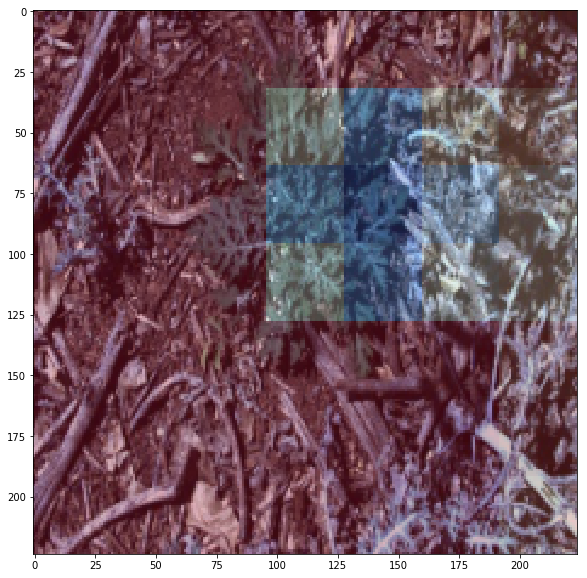

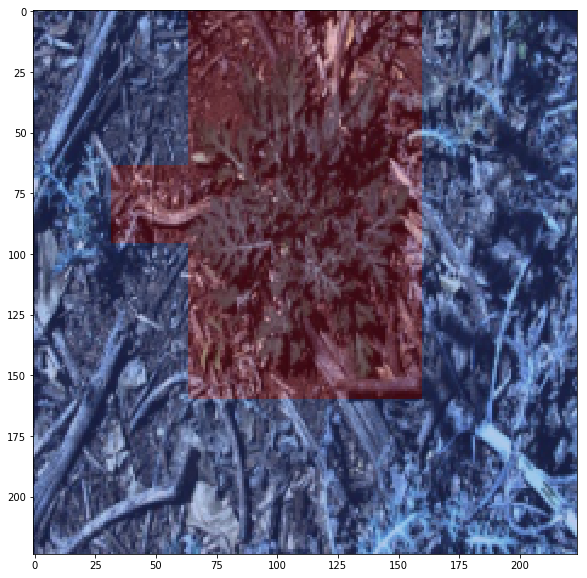

torch.Size([9, 7, 7])
Class predictions:  tensor([3.9672e-06, 1.9945e-06, 1.5973e-03, 2.5705e-05, 1.8337e-06, 9.9836e-01,
        4.5008e-06, 3.5966e-06, 2.9556e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.6053e-05, 1.5837e-04, 3.0646e-02, 2.1872e-03, 1.0840e-02, 9.5601e-01,
        4.1938e-05, 3.1793e-05, 5.0370e-05], device='cuda:0')
Class predictions according to model:  tensor([3.9672e-06, 1.9945e-06, 1.5973e-03, 2.5705e-05, 1.8337e-06, 9.9836e-01,
        4.5008e-06, 3.5966e-06, 2.9556e-06], device='cuda:0')
tensor([[0.8015, 0.8015, 0.8015,  ..., 0.7705, 0.7705, 0.7705],
        [0.8015, 0.8015, 0.8015,  ..., 0.7705, 0.7705, 0.7705],
        [0.8015, 0.8015, 0.8015,  ..., 0.7705, 0.7705, 0.7705],
        ...,
        [1.0000, 1.0000, 1.0000,  ..., 0.9679, 0.9679, 0.9679],
        [1.0000, 1.0000, 1.0000,  ..., 0.9679, 0.9679, 0.9679],
        [1.0000, 1.0000, 1.0000,  ..., 0.9679, 0.9679, 0.9679]]) tensor(0.9694)


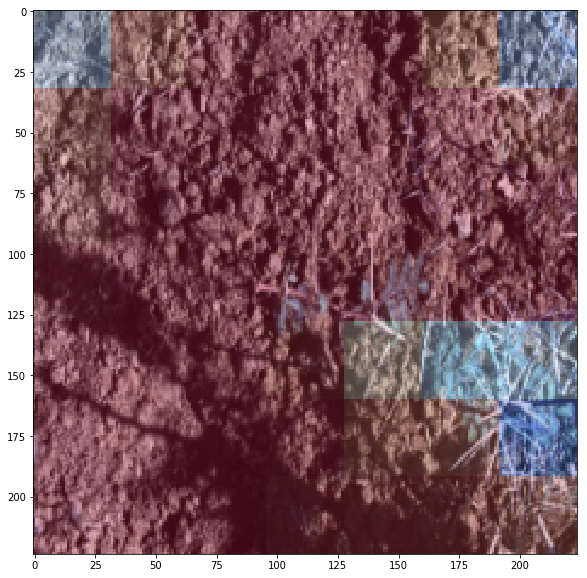

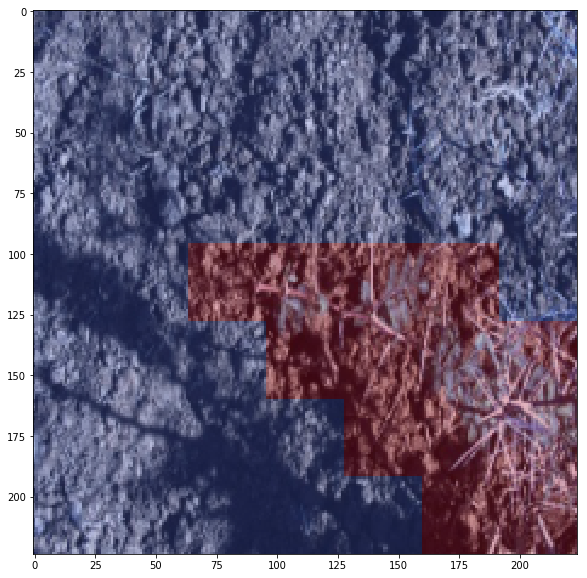

torch.Size([9, 7, 7])
Class predictions:  tensor([2.2747e-06, 9.8370e-07, 5.4249e-06, 2.4784e-06, 3.5135e-07, 9.9998e-01,
        6.7291e-07, 3.2812e-06, 2.4927e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.5123e-04, 7.0727e-05, 1.2930e-02, 1.6620e-03, 7.1060e-05, 9.8217e-01,
        7.2133e-05, 3.9850e-04, 2.0766e-03], device='cuda:0')
Class predictions according to model:  tensor([2.2747e-06, 9.8370e-07, 5.4249e-06, 2.4784e-06, 3.5135e-07, 9.9998e-01,
        6.7291e-07, 3.2812e-06, 2.4927e-06], device='cuda:0')
tensor([[0.9354, 0.9354, 0.9354,  ..., 0.9999, 0.9999, 0.9999],
        [0.9354, 0.9354, 0.9354,  ..., 0.9999, 0.9999, 0.9999],
        [0.9354, 0.9354, 0.9354,  ..., 0.9999, 0.9999, 0.9999],
        ...,
        [0.9996, 0.9996, 0.9996,  ..., 1.0000, 1.0000, 1.0000],
        [0.9996, 0.9996, 0.9996,  ..., 1.0000, 1.0000, 1.0000],
        [0.9996, 0.9996, 0.9996,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.9871)


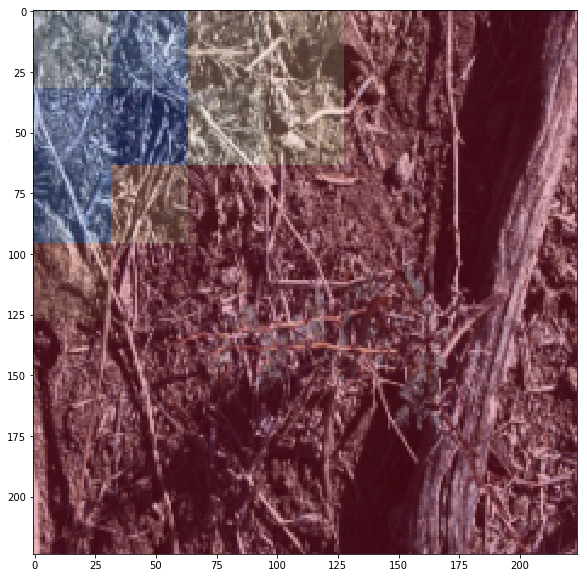

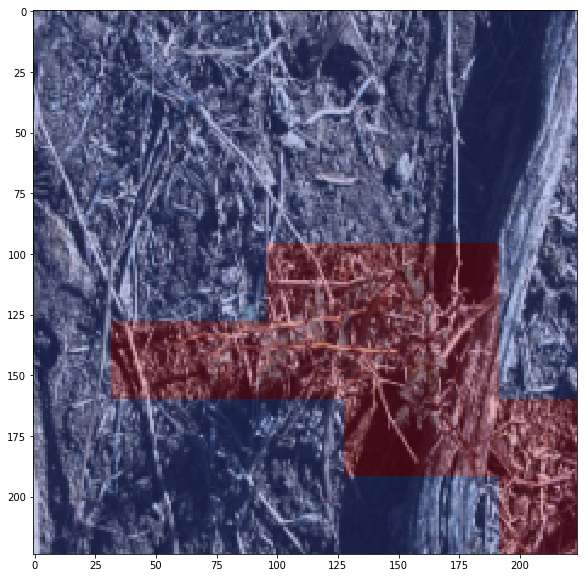

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0448e-04, 1.2006e-05, 2.0914e-02, 7.2887e-05, 1.8269e-05, 9.7873e-01,
        4.0757e-05, 3.1677e-05, 7.2612e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.6863e-04, 3.2380e-05, 1.5370e-01, 3.2895e-04, 4.6989e-04, 8.4313e-01,
        1.0710e-04, 7.2258e-05, 1.8847e-03], device='cuda:0')
Class predictions according to model:  tensor([1.0448e-04, 1.2006e-05, 2.0914e-02, 7.2887e-05, 1.8269e-05, 9.7873e-01,
        4.0757e-05, 3.1677e-05, 7.2612e-05], device='cuda:0')
tensor([[0.7091, 0.7091, 0.7091,  ..., 0.9975, 0.9975, 0.9975],
        [0.7091, 0.7091, 0.7091,  ..., 0.9975, 0.9975, 0.9975],
        [0.7091, 0.7091, 0.7091,  ..., 0.9975, 0.9975, 0.9975],
        ...,
        [0.9639, 0.9639, 0.9639,  ..., 1.0000, 1.0000, 1.0000],
        [0.9639, 0.9639, 0.9639,  ..., 1.0000, 1.0000, 1.0000],
        [0.9639, 0.9639, 0.9639,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.8463)


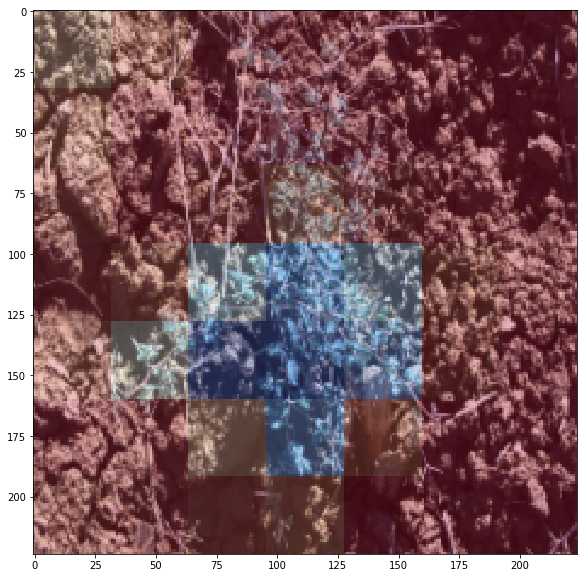

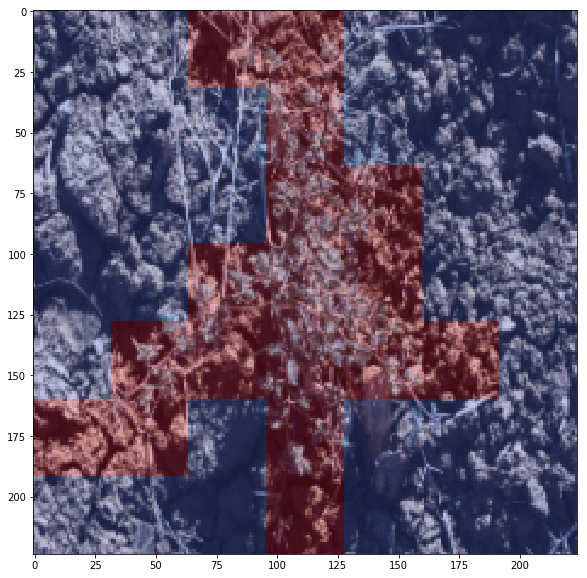

torch.Size([9, 7, 7])
Class predictions:  tensor([4.5762e-04, 6.0697e-05, 2.1686e-02, 6.4878e-04, 2.5458e-04, 9.7648e-01,
        3.2671e-05, 9.2392e-05, 2.8501e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.8285e-04, 1.2982e-04, 3.0218e-01, 1.9837e-03, 2.1319e-04, 6.9380e-01,
        1.4594e-04, 1.5901e-04, 5.9886e-04], device='cuda:0')
Class predictions according to model:  tensor([4.5762e-04, 6.0697e-05, 2.1686e-02, 6.4878e-04, 2.5458e-04, 9.7648e-01,
        3.2671e-05, 9.2392e-05, 2.8501e-04], device='cuda:0')
tensor([[0.9943, 0.9943, 0.9943,  ..., 0.9845, 0.9845, 0.9845],
        [0.9943, 0.9943, 0.9943,  ..., 0.9845, 0.9845, 0.9845],
        [0.9943, 0.9943, 0.9943,  ..., 0.9845, 0.9845, 0.9845],
        ...,
        [0.2608, 0.2608, 0.2608,  ..., 1.0000, 1.0000, 1.0000],
        [0.2608, 0.2608, 0.2608,  ..., 1.0000, 1.0000, 1.0000],
        [0.2608, 0.2608, 0.2608,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.6978)


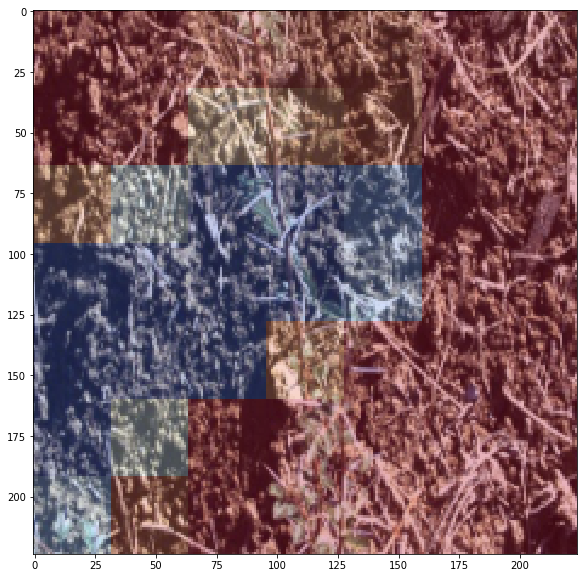

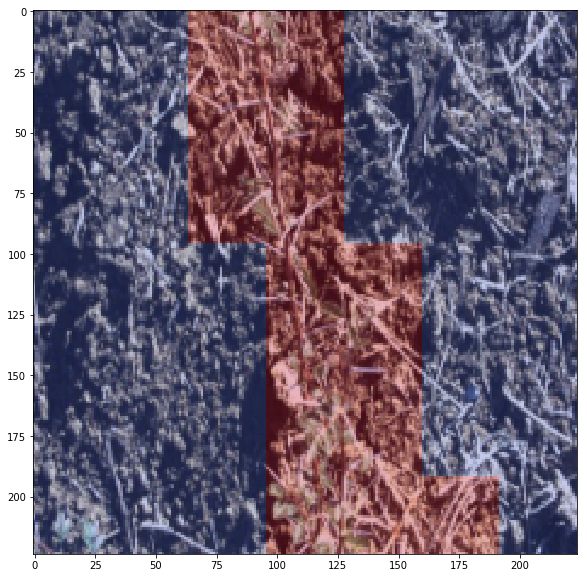

torch.Size([9, 7, 7])
Class predictions:  tensor([3.6580e-06, 1.6716e-06, 5.4452e-05, 7.0841e-05, 2.7612e-05, 9.9983e-01,
        1.9274e-06, 5.1674e-06, 2.0978e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.4960e-04, 6.4561e-05, 1.3035e-02, 8.3683e-03, 1.4638e-02, 9.6345e-01,
        1.1438e-04, 6.1527e-05, 1.2148e-04], device='cuda:0')
Class predictions according to model:  tensor([3.6580e-06, 1.6716e-06, 5.4452e-05, 7.0841e-05, 2.7612e-05, 9.9983e-01,
        1.9274e-06, 5.1674e-06, 2.0978e-06], device='cuda:0')
tensor([[0.9891, 0.9891, 0.9891,  ..., 0.8619, 0.8619, 0.8619],
        [0.9891, 0.9891, 0.9891,  ..., 0.8619, 0.8619, 0.8619],
        [0.9891, 0.9891, 0.9891,  ..., 0.8619, 0.8619, 0.8619],
        ...,
        [1.0000, 1.0000, 1.0000,  ..., 0.9997, 0.9997, 0.9997],
        [1.0000, 1.0000, 1.0000,  ..., 0.9997, 0.9997, 0.9997],
        [1.0000, 1.0000, 1.0000,  ..., 0.9997, 0.9997, 0.9997]]) tensor(0.9870)


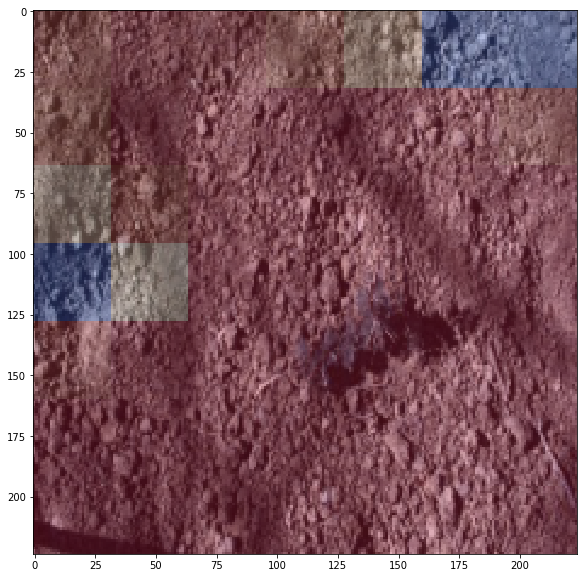

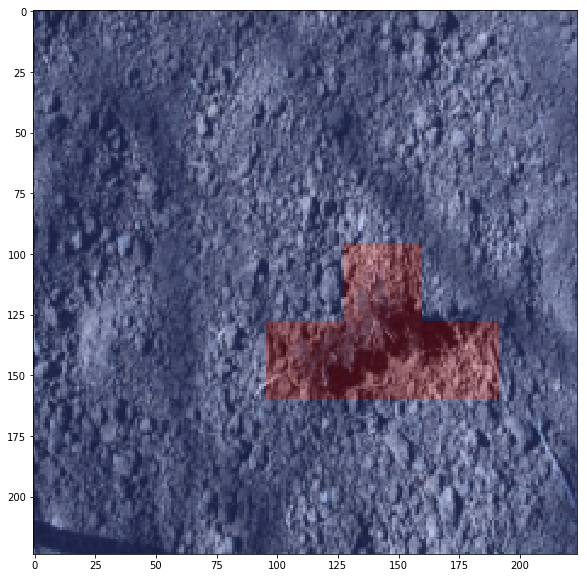

torch.Size([9, 7, 7])
Class predictions:  tensor([6.0411e-04, 2.6678e-05, 8.6947e-05, 5.3137e-05, 4.9764e-03, 7.8547e-05,
        9.9410e-01, 3.0345e-05, 4.0208e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0034, 0.0018, 0.0216, 0.0029, 0.2043, 0.0029, 0.7610, 0.0009, 0.0012],
       device='cuda:0')
Class predictions according to model:  tensor([6.0411e-04, 2.6678e-05, 8.6946e-05, 5.3137e-05, 4.9764e-03, 7.8546e-05,
        9.9410e-01, 3.0344e-05, 4.0208e-05], device='cuda:0')
tensor([[0.6709, 0.6709, 0.6709,  ..., 0.9904, 0.9904, 0.9904],
        [0.6709, 0.6709, 0.6709,  ..., 0.9904, 0.9904, 0.9904],
        [0.6709, 0.6709, 0.6709,  ..., 0.9904, 0.9904, 0.9904],
        ...,
        [0.9998, 0.9998, 0.9998,  ..., 0.9999, 0.9999, 0.9999],
        [0.9998, 0.9998, 0.9998,  ..., 0.9999, 0.9999, 0.9999],
        [0.9998, 0.9998, 0.9998,  ..., 0.9999, 0.9999, 0.9999]]) tensor(0.9784)


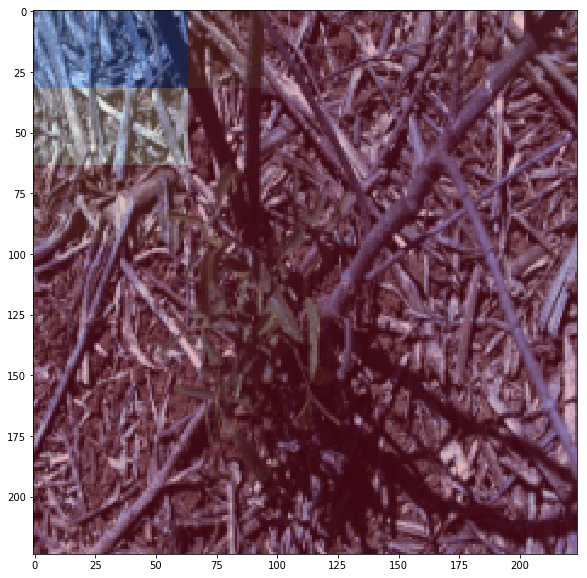

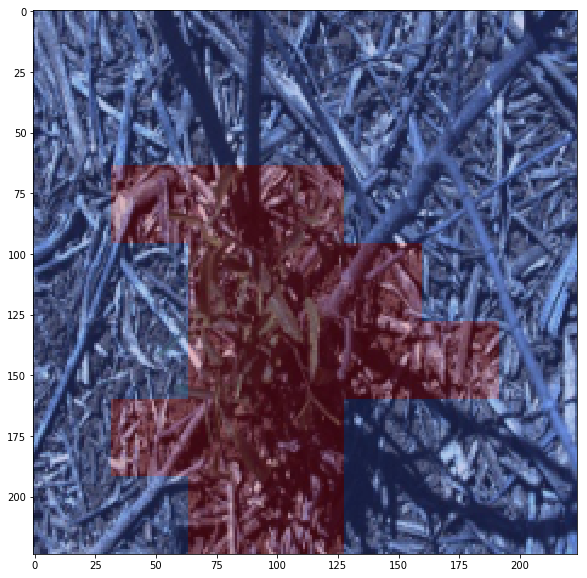

torch.Size([9, 7, 7])
Class predictions:  tensor([1.4684e-06, 1.2766e-07, 5.3276e-06, 2.0476e-07, 5.2440e-05, 8.5126e-06,
        9.9993e-01, 1.1982e-06, 1.8437e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([6.9060e-04, 8.4876e-04, 1.7622e-02, 1.2516e-03, 1.0844e-01, 9.2366e-03,
        8.5582e-01, 4.6431e-03, 1.4520e-03], device='cuda:0')
Class predictions according to model:  tensor([1.4684e-06, 1.2766e-07, 5.3276e-06, 2.0476e-07, 5.2440e-05, 8.5126e-06,
        9.9993e-01, 1.1982e-06, 1.8437e-06], device='cuda:0')
tensor([[1.0000, 1.0000, 1.0000,  ..., 0.7776, 0.7776, 0.7776],
        [1.0000, 1.0000, 1.0000,  ..., 0.7776, 0.7776, 0.7776],
        [1.0000, 1.0000, 1.0000,  ..., 0.7776, 0.7776, 0.7776],
        ...,
        [0.9970, 0.9970, 0.9970,  ..., 0.9935, 0.9935, 0.9935],
        [0.9970, 0.9970, 0.9970,  ..., 0.9935, 0.9935, 0.9935],
        [0.9970, 0.9970, 0.9970,  ..., 0.9935, 0.9935, 0.9935]]) tensor(0.9824)


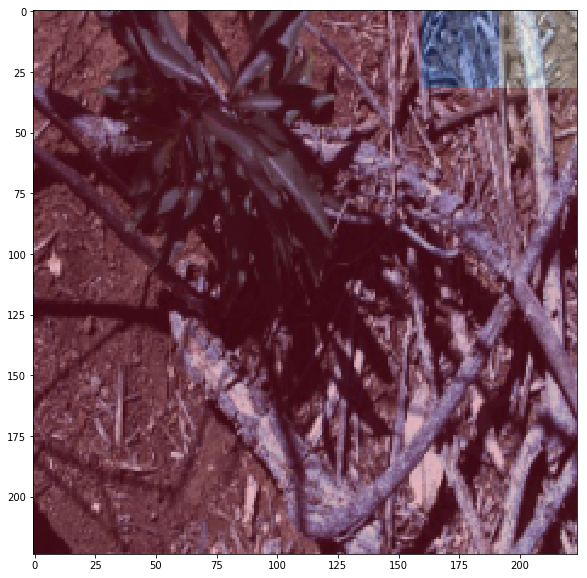

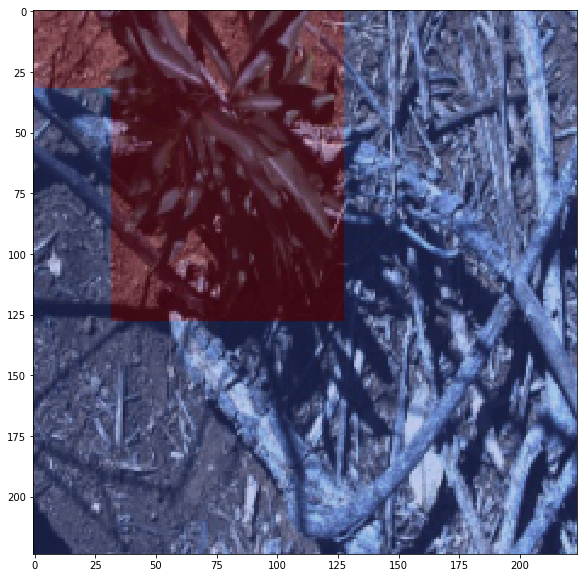

torch.Size([9, 7, 7])
Class predictions:  tensor([2.7247e-06, 5.4603e-07, 6.9334e-04, 1.6884e-07, 3.3967e-06, 3.3552e-07,
        9.9930e-01, 2.7767e-07, 4.8885e-07], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.8445e-03, 3.8750e-04, 3.3637e-01, 7.5400e-05, 1.3809e-03, 8.2985e-05,
        6.5949e-01, 1.2326e-04, 2.4631e-04], device='cuda:0')
Class predictions according to model:  tensor([2.7247e-06, 5.4603e-07, 6.9334e-04, 1.6884e-07, 3.3967e-06, 3.3552e-07,
        9.9930e-01, 2.7767e-07, 4.8885e-07], device='cuda:0')
tensor([[0.2371, 0.2371, 0.2371,  ..., 0.1300, 0.1300, 0.1300],
        [0.2371, 0.2371, 0.2371,  ..., 0.1300, 0.1300, 0.1300],
        [0.2371, 0.2371, 0.2371,  ..., 0.1300, 0.1300, 0.1300],
        ...,
        [0.0716, 0.0716, 0.0716,  ..., 0.0795, 0.0795, 0.0795],
        [0.0716, 0.0716, 0.0716,  ..., 0.0795, 0.0795, 0.0795],
        [0.0716, 0.0716, 0.0716,  ..., 0.0795, 0.0795, 0.0795]]) tensor(0.6636)


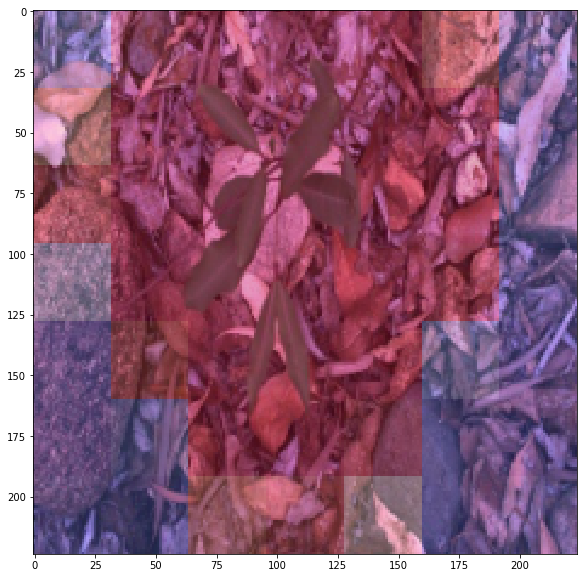

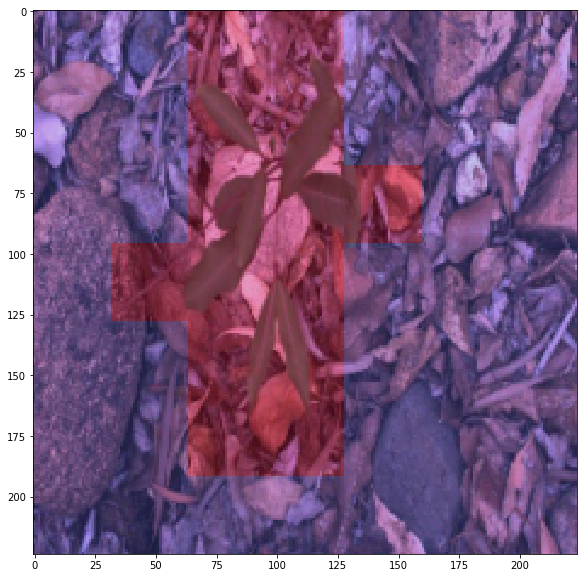

torch.Size([9, 7, 7])
Class predictions:  tensor([1.3496e-04, 1.4282e-05, 2.0215e-04, 2.7789e-06, 2.4838e-05, 1.7705e-05,
        9.9957e-01, 1.5092e-05, 1.7223e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0188, 0.0042, 0.1899, 0.0015, 0.0094, 0.0050, 0.7625, 0.0024, 0.0063],
       device='cuda:0')
Class predictions according to model:  tensor([1.3496e-04, 1.4282e-05, 2.0215e-04, 2.7789e-06, 2.4838e-05, 1.7705e-05,
        9.9957e-01, 1.5092e-05, 1.7223e-05], device='cuda:0')
tensor([[0.4064, 0.4064, 0.4064,  ..., 0.3930, 0.3930, 0.3930],
        [0.4064, 0.4064, 0.4064,  ..., 0.3930, 0.3930, 0.3930],
        [0.4064, 0.4064, 0.4064,  ..., 0.3930, 0.3930, 0.3930],
        ...,
        [0.3484, 0.3484, 0.3484,  ..., 0.8508, 0.8508, 0.8508],
        [0.3484, 0.3484, 0.3484,  ..., 0.8508, 0.8508, 0.8508],
        [0.3484, 0.3484, 0.3484,  ..., 0.8508, 0.8508, 0.8508]]) tensor(0.8101)


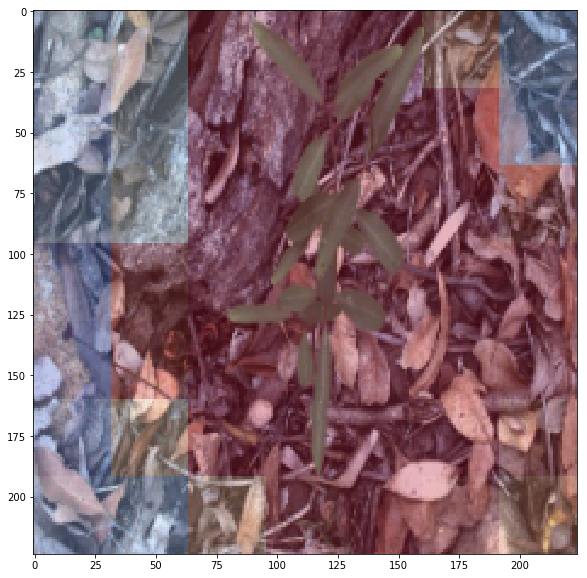

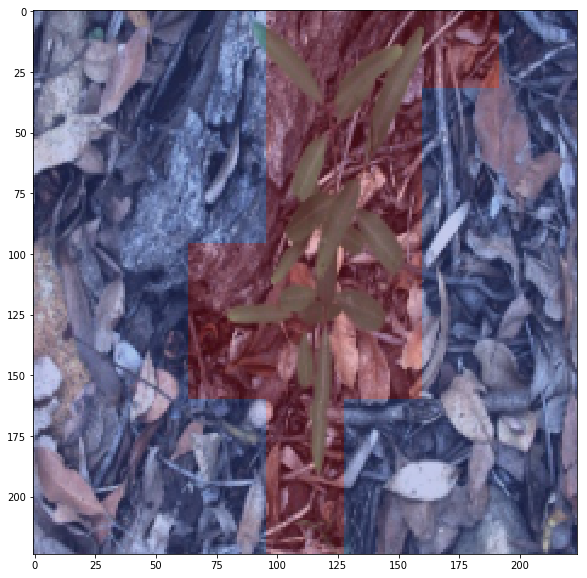

torch.Size([9, 7, 7])
Class predictions:  tensor([1.2272e-04, 5.3892e-06, 3.5909e-05, 5.5312e-07, 4.8517e-06, 2.4311e-06,
        9.9982e-01, 4.3341e-06, 3.0850e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0172, 0.0108, 0.1948, 0.0016, 0.0163, 0.0046, 0.7455, 0.0029, 0.0063],
       device='cuda:0')
Class predictions according to model:  tensor([1.2272e-04, 5.3892e-06, 3.5909e-05, 5.5312e-07, 4.8517e-06, 2.4311e-06,
        9.9982e-01, 4.3341e-06, 3.0850e-06], device='cuda:0')
tensor([[0.9993, 0.9993, 0.9993,  ..., 0.0453, 0.0453, 0.0453],
        [0.9993, 0.9993, 0.9993,  ..., 0.0453, 0.0453, 0.0453],
        [0.9993, 0.9993, 0.9993,  ..., 0.0453, 0.0453, 0.0453],
        ...,
        [0.7812, 0.7812, 0.7812,  ..., 0.1016, 0.1016, 0.1016],
        [0.7812, 0.7812, 0.7812,  ..., 0.1016, 0.1016, 0.1016],
        [0.7812, 0.7812, 0.7812,  ..., 0.1016, 0.1016, 0.1016]]) tensor(0.8052)


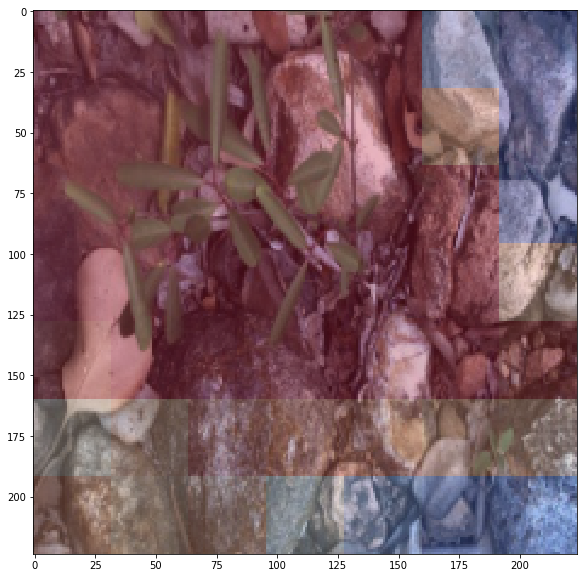

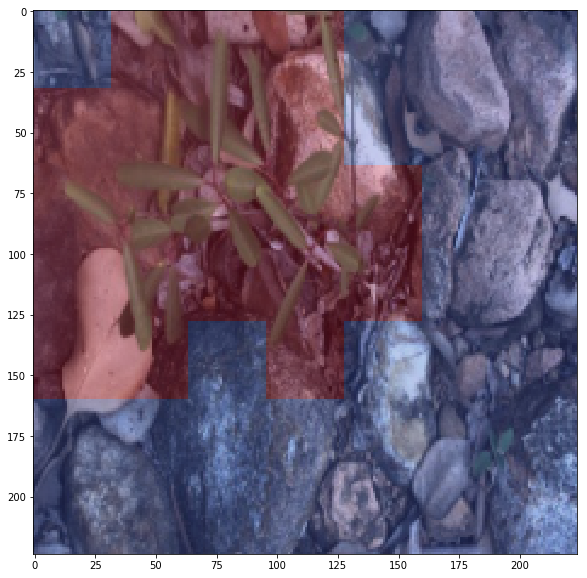

torch.Size([9, 7, 7])
Class predictions:  tensor([2.2476e-03, 2.1671e-02, 1.8230e-01, 2.4548e-04, 2.0864e-04, 1.2825e-04,
        1.7984e-02, 7.7275e-01, 2.4651e-03], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0136, 0.0622, 0.3359, 0.0022, 0.0037, 0.0012, 0.0899, 0.4738, 0.0175],
       device='cuda:0')
Class predictions according to model:  tensor([2.2476e-03, 2.1671e-02, 1.8230e-01, 2.4548e-04, 2.0864e-04, 1.2825e-04,
        1.7984e-02, 7.7275e-01, 2.4651e-03], device='cuda:0')
tensor([[0.8389, 0.8389, 0.8389,  ..., 0.7145, 0.7145, 0.7145],
        [0.8389, 0.8389, 0.8389,  ..., 0.7145, 0.7145, 0.7145],
        [0.8389, 0.8389, 0.8389,  ..., 0.7145, 0.7145, 0.7145],
        ...,
        [0.6369, 0.6369, 0.6369,  ..., 0.8595, 0.8595, 0.8595],
        [0.6369, 0.6369, 0.6369,  ..., 0.8595, 0.8595, 0.8595],
        [0.6369, 0.6369, 0.6369,  ..., 0.8595, 0.8595, 0.8595]]) tensor(0.6641)


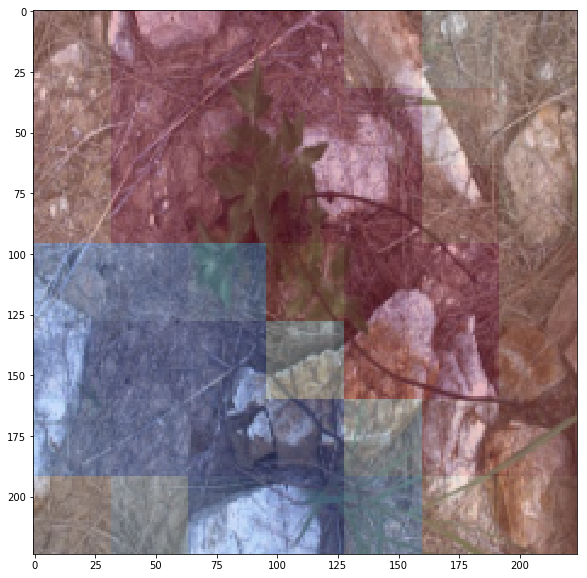

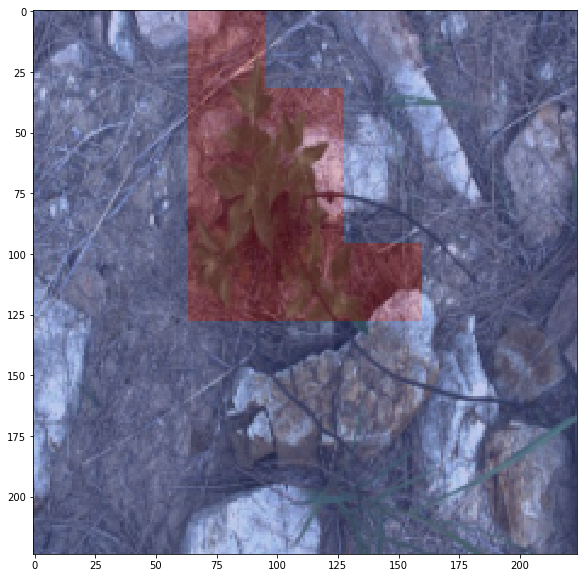

torch.Size([9, 7, 7])
Class predictions:  tensor([5.2340e-05, 2.2172e-04, 1.0486e-01, 5.0681e-05, 1.3726e-04, 5.7419e-05,
        6.1386e-04, 8.9380e-01, 2.0329e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0017, 0.0014, 0.4726, 0.0040, 0.0017, 0.0028, 0.0438, 0.4626, 0.0093],
       device='cuda:0')
Class predictions according to model:  tensor([5.2340e-05, 2.2172e-04, 1.0486e-01, 5.0681e-05, 1.3726e-04, 5.7419e-05,
        6.1386e-04, 8.9380e-01, 2.0329e-04], device='cuda:0')
tensor([[0.3215, 0.3215, 0.3215,  ..., 0.1031, 0.1031, 0.1031],
        [0.3215, 0.3215, 0.3215,  ..., 0.1031, 0.1031, 0.1031],
        [0.3215, 0.3215, 0.3215,  ..., 0.1031, 0.1031, 0.1031],
        ...,
        [0.9818, 0.9818, 0.9818,  ..., 0.0110, 0.0110, 0.0110],
        [0.9818, 0.9818, 0.9818,  ..., 0.0110, 0.0110, 0.0110],
        [0.9818, 0.9818, 0.9818,  ..., 0.0110, 0.0110, 0.0110]]) tensor(0.5274)


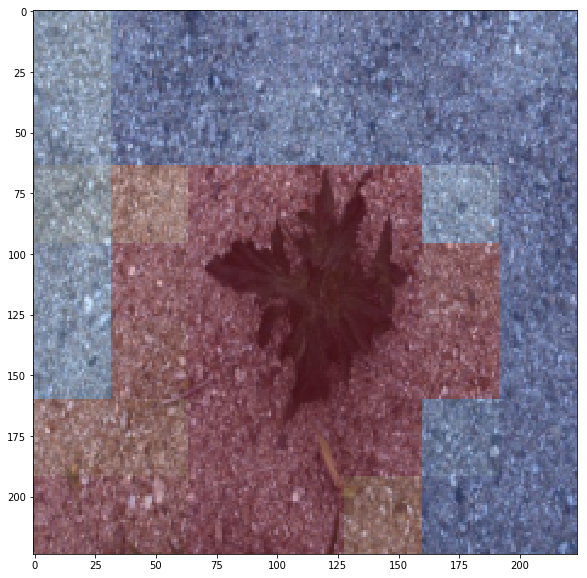

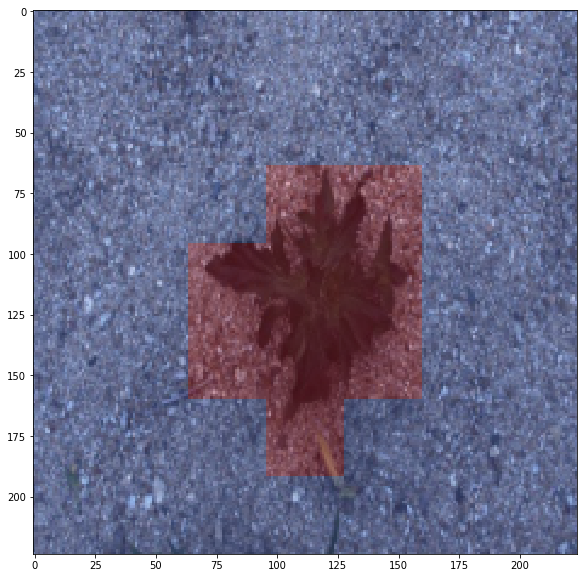

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0351e-05, 5.2167e-05, 8.3828e-03, 7.8372e-05, 1.7492e-05, 4.7739e-05,
        1.4309e-05, 9.9139e-01, 5.6693e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.2965e-03, 1.0733e-02, 3.9332e-01, 2.8827e-02, 7.3545e-04, 3.0992e-03,
        3.6784e-04, 5.5864e-01, 9.8746e-04], device='cuda:0')
Class predictions according to model:  tensor([1.0351e-05, 5.2167e-05, 8.3828e-03, 7.8372e-05, 1.7492e-05, 4.7739e-05,
        1.4309e-05, 9.9139e-01, 5.6693e-06], device='cuda:0')
tensor([[0.0893, 0.0893, 0.0893,  ..., 0.0107, 0.0107, 0.0107],
        [0.0893, 0.0893, 0.0893,  ..., 0.0107, 0.0107, 0.0107],
        [0.0893, 0.0893, 0.0893,  ..., 0.0107, 0.0107, 0.0107],
        ...,
        [0.9475, 0.9475, 0.9475,  ..., 0.9254, 0.9254, 0.9254],
        [0.9475, 0.9475, 0.9475,  ..., 0.9254, 0.9254, 0.9254],
        [0.9475, 0.9475, 0.9475,  ..., 0.9254, 0.9254, 0.9254]]) tensor(0.6067)


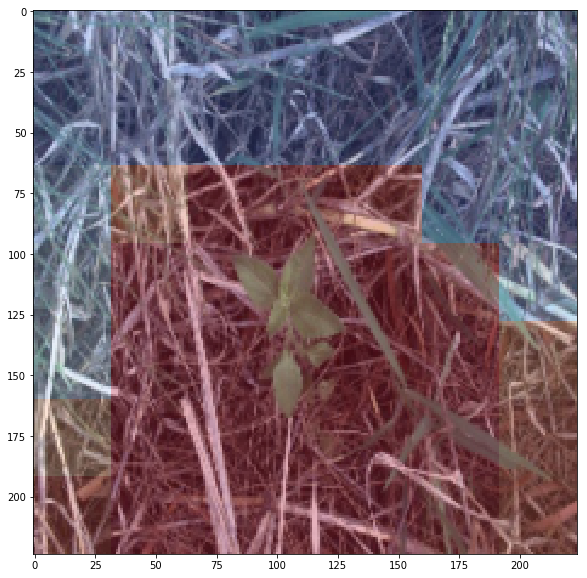

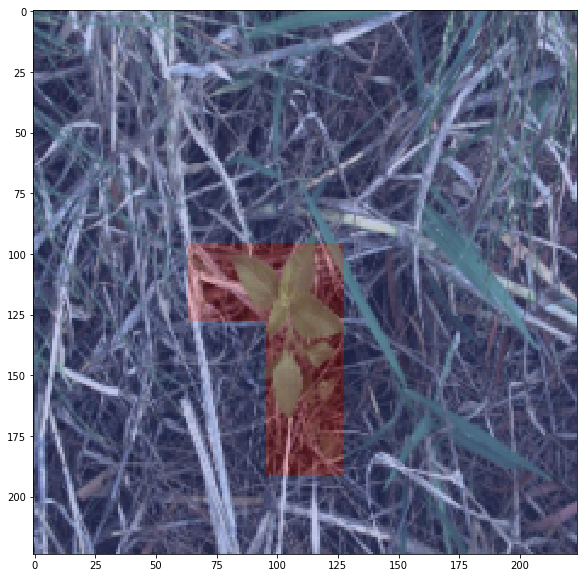

torch.Size([9, 7, 7])
Class predictions:  tensor([3.1762e-05, 1.1998e-06, 3.2747e-05, 8.3457e-07, 4.7786e-06, 4.1216e-05,
        5.3201e-06, 9.9988e-01, 7.0367e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.5653e-03, 2.6793e-04, 2.9920e-01, 4.8342e-04, 6.7666e-04, 4.5910e-03,
        1.1303e-03, 6.8528e-01, 5.8064e-03], device='cuda:0')
Class predictions according to model:  tensor([3.1762e-05, 1.1998e-06, 3.2747e-05, 8.3457e-07, 4.7786e-06, 4.1216e-05,
        5.3201e-06, 9.9988e-01, 7.0367e-06], device='cuda:0')
tensor([[0.0933, 0.0933, 0.0933,  ..., 0.9990, 0.9990, 0.9990],
        [0.0933, 0.0933, 0.0933,  ..., 0.9990, 0.9990, 0.9990],
        [0.0933, 0.0933, 0.0933,  ..., 0.9990, 0.9990, 0.9990],
        ...,
        [0.1672, 0.1672, 0.1672,  ..., 1.0000, 1.0000, 1.0000],
        [0.1672, 0.1672, 0.1672,  ..., 1.0000, 1.0000, 1.0000],
        [0.1672, 0.1672, 0.1672,  ..., 1.0000, 1.0000, 1.0000]]) tensor(0.7008)


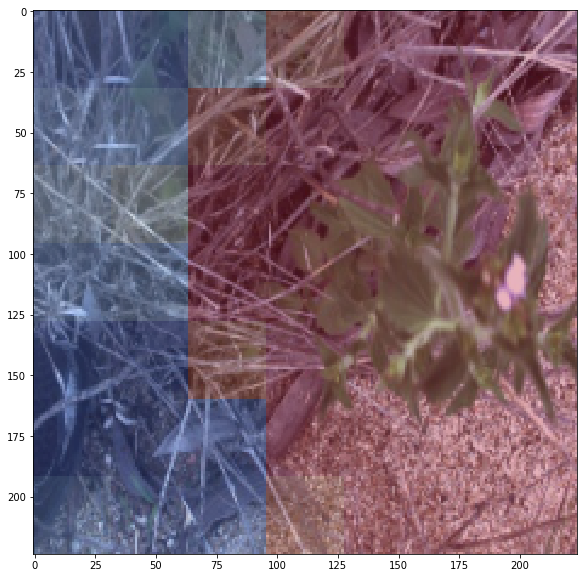

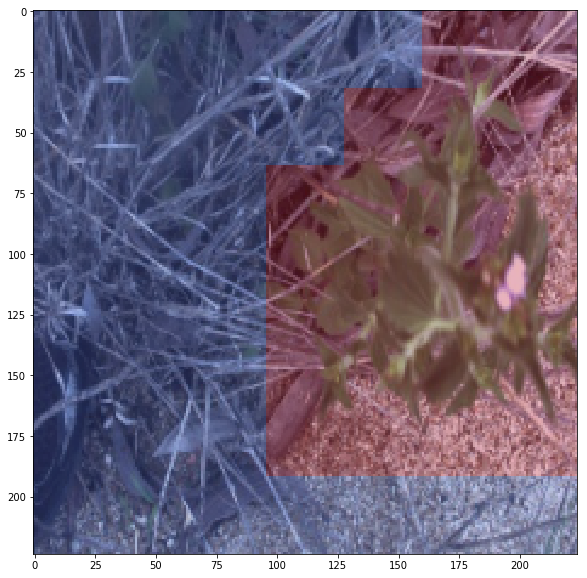

torch.Size([9, 7, 7])
Class predictions:  tensor([8.2861e-06, 6.5206e-06, 1.6559e-02, 4.7999e-06, 2.9939e-05, 5.8866e-05,
        1.3090e-05, 9.8331e-01, 1.2193e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.7641e-06, 2.2745e-05, 3.9805e-01, 8.2762e-06, 5.5743e-05, 1.2441e-04,
        5.1970e-05, 6.0155e-01, 1.2278e-04], device='cuda:0')
Class predictions according to model:  tensor([8.2861e-06, 6.5206e-06, 1.6559e-02, 4.7999e-06, 2.9939e-05, 5.8866e-05,
        1.3090e-05, 9.8331e-01, 1.2193e-05], device='cuda:0')
tensor([[1.0000, 1.0000, 1.0000,  ..., 0.8741, 0.8741, 0.8741],
        [1.0000, 1.0000, 1.0000,  ..., 0.8741, 0.8741, 0.8741],
        [1.0000, 1.0000, 1.0000,  ..., 0.8741, 0.8741, 0.8741],
        ...,
        [0.9910, 0.9910, 0.9910,  ..., 0.0024, 0.0024, 0.0024],
        [0.9910, 0.9910, 0.9910,  ..., 0.0024, 0.0024, 0.0024],
        [0.9910, 0.9910, 0.9910,  ..., 0.0024, 0.0024, 0.0024]]) tensor(0.6019)


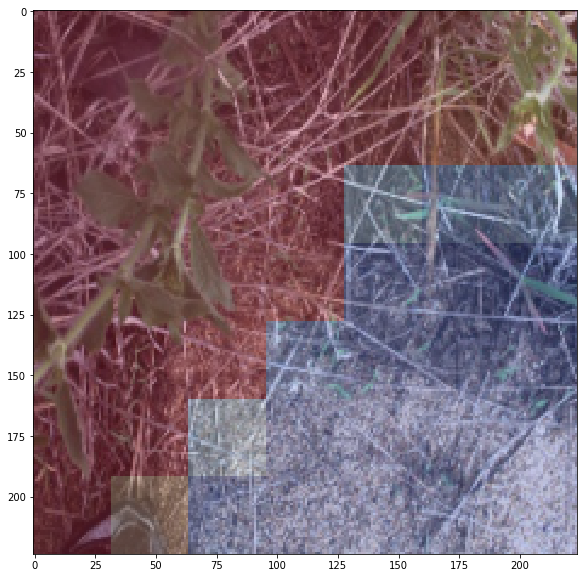

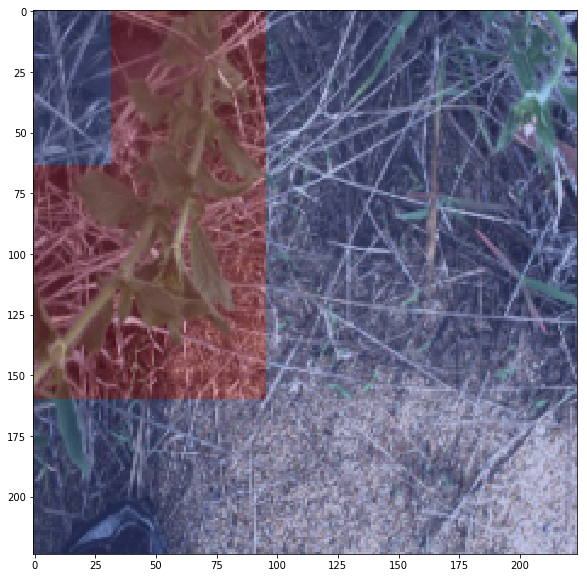

torch.Size([9, 7, 7])
Class predictions:  tensor([2.4165e-04, 1.4324e-04, 8.4793e-05, 6.1599e-06, 8.7742e-06, 1.3527e-05,
        1.8855e-05, 1.2874e-05, 9.9947e-01], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0543, 0.0455, 0.1523, 0.0261, 0.0040, 0.0093, 0.0051, 0.0024, 0.7009],
       device='cuda:0')
Class predictions according to model:  tensor([2.4165e-04, 1.4324e-04, 8.4793e-05, 6.1599e-06, 8.7742e-06, 1.3527e-05,
        1.8855e-05, 1.2874e-05, 9.9947e-01], device='cuda:0')
tensor([[0.7142, 0.7142, 0.7142,  ..., 0.4195, 0.4195, 0.4195],
        [0.7142, 0.7142, 0.7142,  ..., 0.4195, 0.4195, 0.4195],
        [0.7142, 0.7142, 0.7142,  ..., 0.4195, 0.4195, 0.4195],
        ...,
        [0.9046, 0.9046, 0.9046,  ..., 0.0101, 0.0101, 0.0101],
        [0.9046, 0.9046, 0.9046,  ..., 0.0101, 0.0101, 0.0101],
        [0.9046, 0.9046, 0.9046,  ..., 0.0101, 0.0101, 0.0101]]) tensor(0.8477)


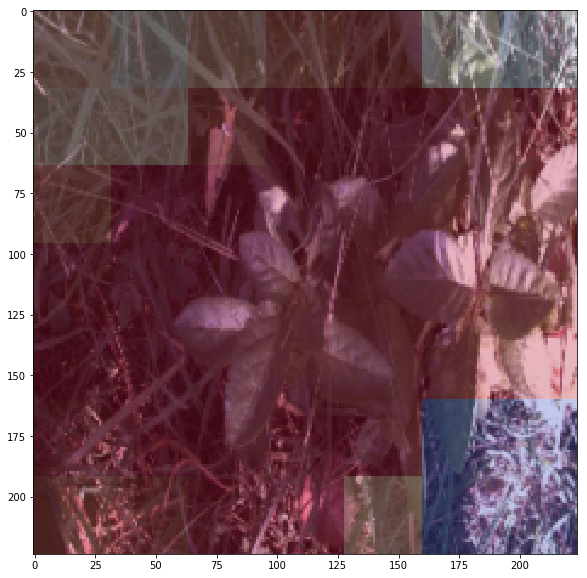

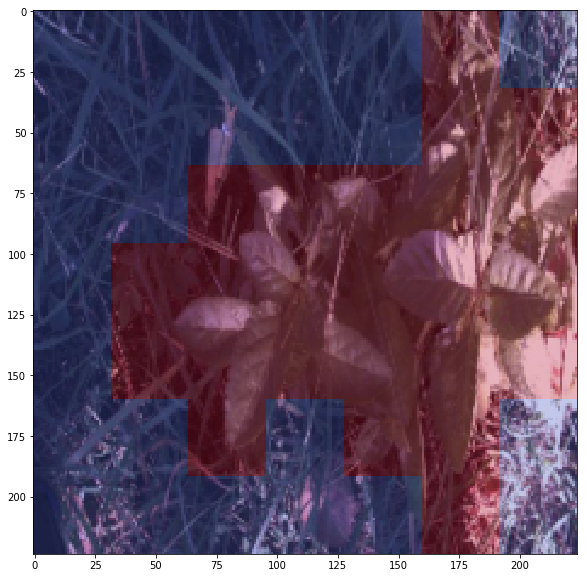

torch.Size([9, 7, 7])
Class predictions:  tensor([1.0578e-02, 2.5083e-02, 2.1462e-02, 1.4304e-04, 9.6720e-03, 1.6594e-03,
        3.9003e-04, 1.2244e-04, 9.3089e-01], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([9.2919e-02, 3.0082e-02, 3.9598e-01, 2.7405e-03, 1.0153e-01, 6.8507e-03,
        7.5548e-04, 1.6426e-04, 3.6897e-01], device='cuda:0')
Class predictions according to model:  tensor([1.0578e-02, 2.5083e-02, 2.1462e-02, 1.4304e-04, 9.6720e-03, 1.6594e-03,
        3.9003e-04, 1.2244e-04, 9.3089e-01], device='cuda:0')
tensor([[0.1994, 0.1994, 0.1994,  ..., 0.0699, 0.0699, 0.0699],
        [0.1994, 0.1994, 0.1994,  ..., 0.0699, 0.0699, 0.0699],
        [0.1994, 0.1994, 0.1994,  ..., 0.0699, 0.0699, 0.0699],
        ...,
        [0.8980, 0.8980, 0.8980,  ..., 0.0091, 0.0091, 0.0091],
        [0.8980, 0.8980, 0.8980,  ..., 0.0091, 0.0091, 0.0091],
        [0.8980, 0.8980, 0.8980,  ..., 0.0091, 0.0091, 0.0091]]) tensor(0.6040)


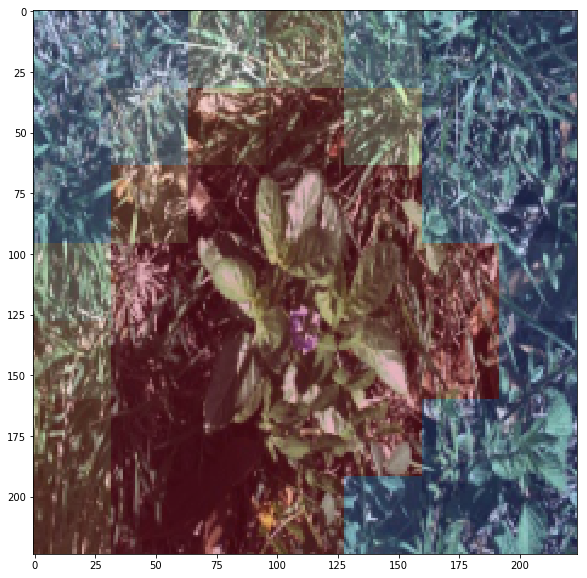

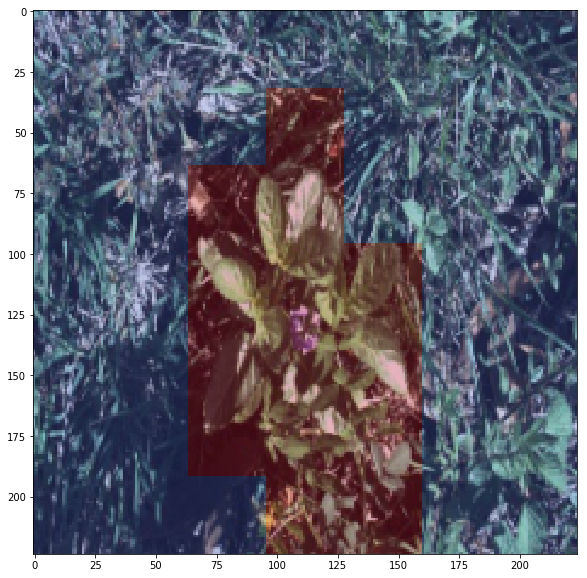

torch.Size([9, 7, 7])
Class predictions:  tensor([0.1787, 0.0056, 0.0056, 0.0009, 0.0021, 0.0148, 0.0092, 0.0118, 0.7713],
       device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.1939, 0.0024, 0.0561, 0.0270, 0.0218, 0.1208, 0.0511, 0.1069, 0.4201],
       device='cuda:0')
Class predictions according to model:  tensor([0.1787, 0.0056, 0.0056, 0.0009, 0.0021, 0.0148, 0.0092, 0.0118, 0.7713],
       device='cuda:0')
tensor([[0.6819, 0.6819, 0.6819,  ..., 0.9988, 0.9988, 0.9988],
        [0.6819, 0.6819, 0.6819,  ..., 0.9988, 0.9988, 0.9988],
        [0.6819, 0.6819, 0.6819,  ..., 0.9988, 0.9988, 0.9988],
        ...,
        [0.9661, 0.9661, 0.9661,  ..., 0.8018, 0.8018, 0.8018],
        [0.9661, 0.9661, 0.9661,  ..., 0.8018, 0.8018, 0.8018],
        [0.9661, 0.9661, 0.9661,  ..., 0.8018, 0.8018, 0.8018]]) tensor(0.9439)


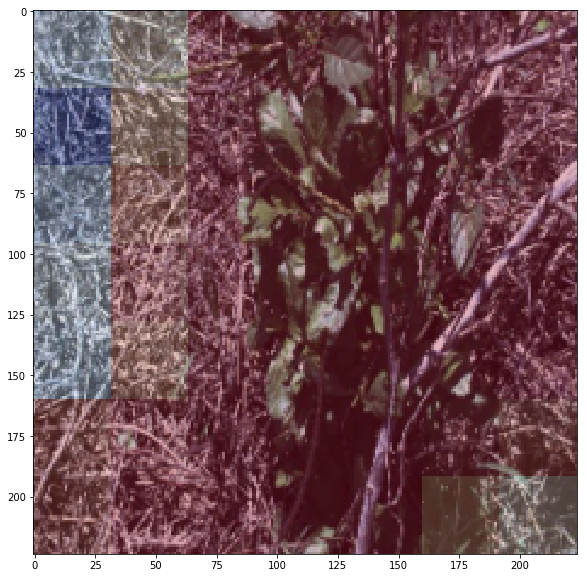

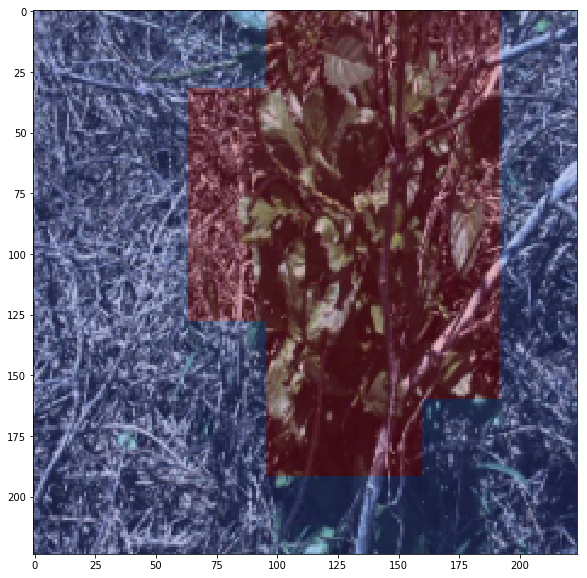

torch.Size([9, 7, 7])
Class predictions:  tensor([7.5282e-04, 6.7131e-04, 1.4582e-02, 1.8726e-04, 2.4984e-03, 3.2735e-04,
        1.4455e-04, 2.1154e-05, 9.8082e-01], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.9553e-03, 2.1331e-03, 3.3916e-01, 1.4022e-02, 1.2076e-01, 2.1783e-02,
        7.5224e-04, 3.9749e-04, 4.9904e-01], device='cuda:0')
Class predictions according to model:  tensor([7.5282e-04, 6.7131e-04, 1.4582e-02, 1.8726e-04, 2.4984e-03, 3.2735e-04,
        1.4455e-04, 2.1154e-05, 9.8082e-01], device='cuda:0')
tensor([[0.2652, 0.2652, 0.2652,  ..., 0.2316, 0.2316, 0.2316],
        [0.2652, 0.2652, 0.2652,  ..., 0.2316, 0.2316, 0.2316],
        [0.2652, 0.2652, 0.2652,  ..., 0.2316, 0.2316, 0.2316],
        ...,
        [0.3244, 0.3244, 0.3244,  ..., 0.9969, 0.9969, 0.9969],
        [0.3244, 0.3244, 0.3244,  ..., 0.9969, 0.9969, 0.9969],
        [0.3244, 0.3244, 0.3244,  ..., 0.9969, 0.9969, 0.9969]]) tensor(0.6608)


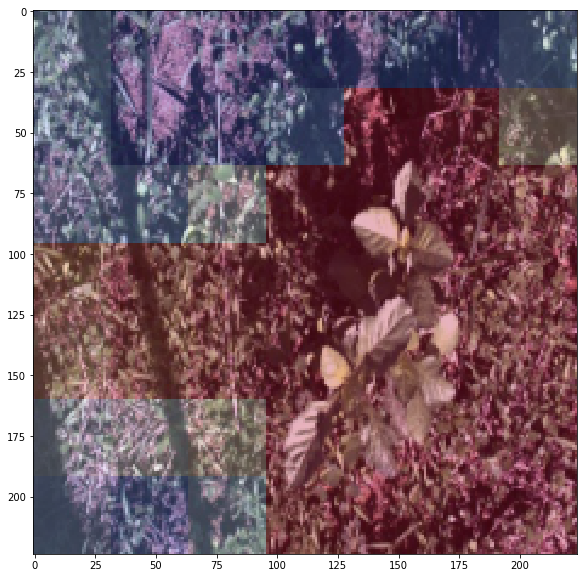

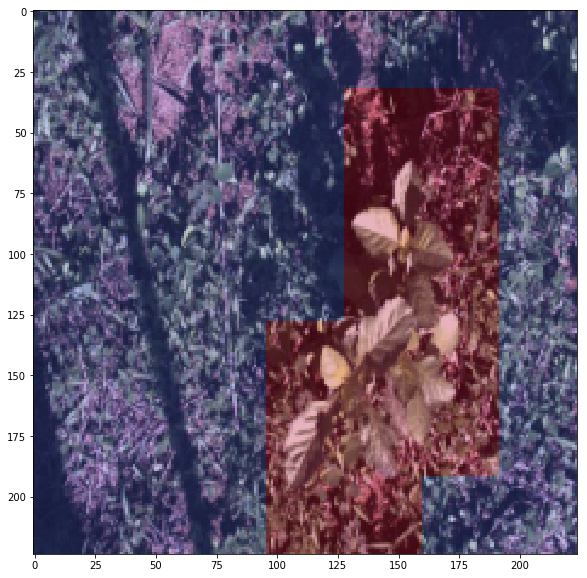

torch.Size([9, 7, 7])
Class predictions:  tensor([6.7248e-03, 1.6038e-03, 3.5781e-02, 5.0668e-05, 1.3846e-04, 2.9984e-05,
        2.5112e-04, 2.3601e-05, 9.5540e-01], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.1892, 0.0590, 0.2016, 0.0050, 0.0074, 0.0010, 0.0011, 0.0007, 0.5351],
       device='cuda:0')
Class predictions according to model:  tensor([6.7248e-03, 1.6038e-03, 3.5781e-02, 5.0668e-05, 1.3846e-04, 2.9984e-05,
        2.5112e-04, 2.3601e-05, 9.5540e-01], device='cuda:0')
tensor([[0.3916, 0.3916, 0.3916,  ..., 0.4867, 0.4867, 0.4867],
        [0.3916, 0.3916, 0.3916,  ..., 0.4867, 0.4867, 0.4867],
        [0.3916, 0.3916, 0.3916,  ..., 0.4867, 0.4867, 0.4867],
        ...,
        [0.7620, 0.7620, 0.7620,  ..., 0.9798, 0.9798, 0.9798],
        [0.7620, 0.7620, 0.7620,  ..., 0.9798, 0.9798, 0.9798],
        [0.7620, 0.7620, 0.7620,  ..., 0.9798, 0.9798, 0.9798]]) tensor(0.7984)


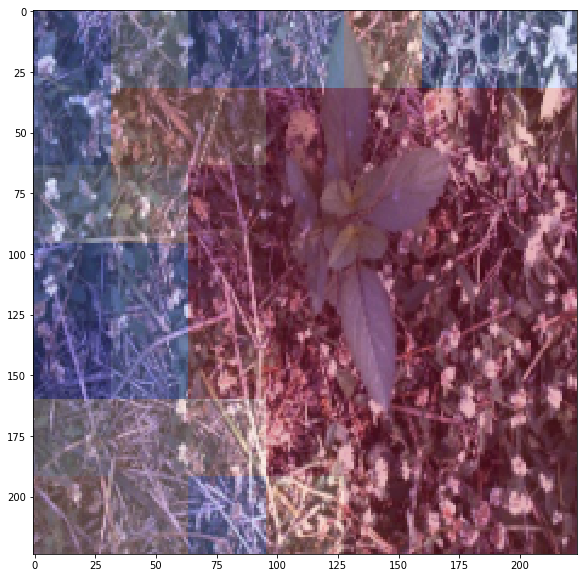

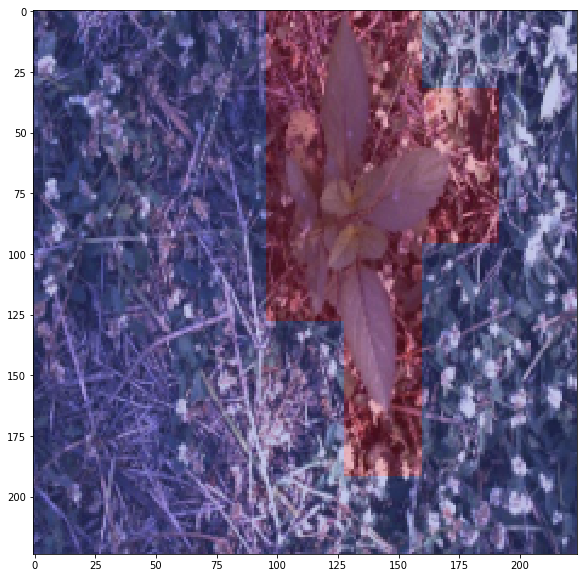

In [39]:
negative_class = class_names.index('negatives')

weed_prob_preds = []

N = len(xs)
print(N)
for i in range(N):

    image = Image.open('deep_weeds_dataset/images/' + xs[i])
    img = transform(image)[None, :, :, :]

    img = img.to(device)
    label = ys[i]
    img_rgb = img.squeeze()

    std = torch.Tensor([.229, .224, .225]).reshape(3,1,1).to(device)
    mean = torch.Tensor([.485, .456, .406]).reshape(3,1,1).to(device)
    rescaled_image = img_rgb * std + mean

    grid_activations = final_model.model.forward(img, True).squeeze().detach()
    true_predictions = final_model.model.forward(img).squeeze().detach()
    print(grid_activations.shape)

    per_pixel_class_probs = torch.nn.Softmax(dim=(0))(grid_activations.squeeze())

    class_predictions = torch.nn.Softmax(dim=0)(torch.mean(grid_activations, dim=(1,2)))
    print('Class predictions: ', class_predictions)
    print('Class predictions avged over pixels (should be same): ', 
          per_pixel_class_probs.mean(dim=(1,2)))
    print('Class predictions according to model: ', torch.nn.Softmax(dim=0)(true_predictions))

    show(rescaled_image.cpu())
    per_pixel_prob_weed = 1. - per_pixel_class_probs[negative_class,:,:]
    weed_mask = per_pixel_prob_weed.reshape(7,1,7,1) * torch.ones((7,32,7,32)).to(device)
    weed_mask = weed_mask.reshape((224,224)).cpu()
    #weed_mask = weed_mask * (weed_mask > 0.5).float()
    print(weed_mask, weed_mask.mean())
    plt.imshow(weed_mask, cmap='coolwarm', alpha=0.3)
    weed_prob_preds.append(per_pixel_prob_weed)
    plt.show()

    show(rescaled_image.cpu())
    true_mask = torch.Tensor(burn_ys[i]).reshape(7,1,7,1) * torch.ones((7,32,7,32))
    true_mask = true_mask.reshape((224,224)).cpu()
    plt.imshow(true_mask, cmap='coolwarm', alpha=0.3)
    plt.show()

In [40]:
weed_preds = np.array(torch.stack(weed_prob_preds).cpu())
true_labels = np.stack(burn_ys).astype(int)

In [41]:
from sklearn.metrics import precision_recall_curve, roc_auc_score, roc_curve

In [44]:
dataloader_test_1 = torch.utils.data.DataLoader(
    test_set, batch_size=1, shuffle=True, num_workers=4)

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([2.4417e-06, 1.8184e-06, 9.9999e-01, 2.3287e-06, 1.7135e-06, 5.4622e-07,
        1.4350e-06, 7.6174e-07, 1.9649e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.4871e-06, 3.4958e-06, 9.9997e-01, 9.7511e-06, 3.3181e-06, 1.2268e-06,
        2.4425e-06, 1.4469e-06, 3.3772e-06], device='cuda:0')
Class predictions according to model:  tensor([2.4417e-06, 1.8184e-06, 9.9999e-01, 2.3287e-06, 1.7135e-06, 5.4622e-07,
        1.4350e-06, 7.6174e-07, 1.9649e-06], device='cuda:0')
tensor([[3.2306e-04, 3.2306e-04, 3.2306e-04,  ..., 6.3181e-06, 6.3181e-06,
         6.3181e-06],
        [3.2306e-04, 3.2306e-04, 3.2306e-04,  ..., 6.3181e-06, 6.3181e-06,
         6.3181e-06],
        [3.2306e-04, 3.2306e-04, 3.2306e-04,  ..., 6.3181e-06, 6.3181e-06,
         6.3181e-06],
        ...,
        [1.1444e-05, 1.1444e-05, 1.1444e-05,  ..., 1.4305e-06, 1.4

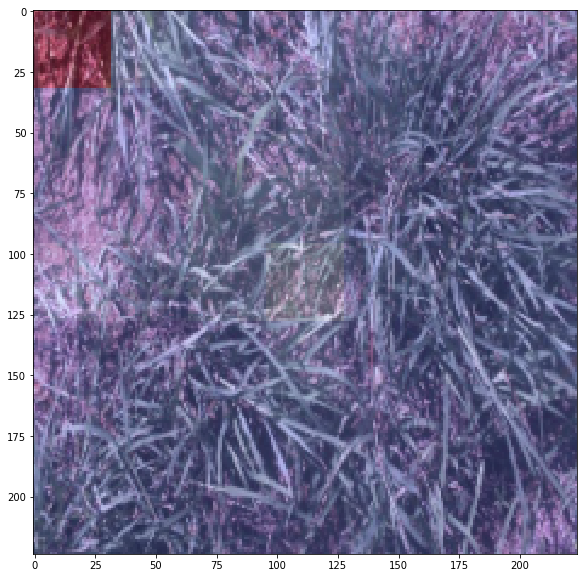

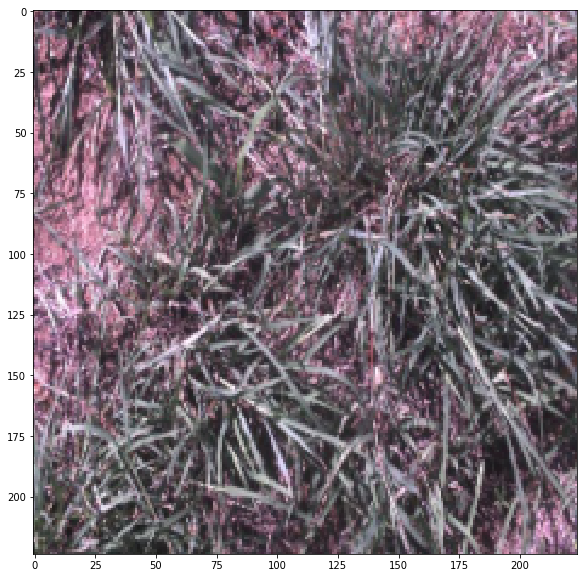

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([5.9057e-06, 3.3424e-06, 9.9993e-01, 2.3989e-06, 4.4084e-06, 1.6924e-06,
        3.4647e-05, 5.9110e-06, 7.8404e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.2985e-03, 1.9892e-03, 9.7610e-01, 6.9815e-04, 8.6322e-04, 5.0703e-03,
        1.1084e-02, 4.5964e-04, 2.4336e-03], device='cuda:0')
Class predictions according to model:  tensor([5.9057e-06, 3.3424e-06, 9.9993e-01, 2.3989e-06, 4.4085e-06, 1.6924e-06,
        3.4647e-05, 5.9111e-06, 7.8404e-06], device='cuda:0')
tensor([[0.0018, 0.0018, 0.0018,  ..., 0.0010, 0.0010, 0.0010],
        [0.0018, 0.0018, 0.0018,  ..., 0.0010, 0.0010, 0.0010],
        [0.0018, 0.0018, 0.0018,  ..., 0.0010, 0.0010, 0.0010],
        ...,
        [0.0003, 0.0003, 0.0003,  ..., 0.1876, 0.1876, 0.1876],
        [0.0003, 0.0003, 0.0003,  ..., 0.1876, 0.1876, 0.1876],
        [0.0003, 0.0003, 0.0003,  ...

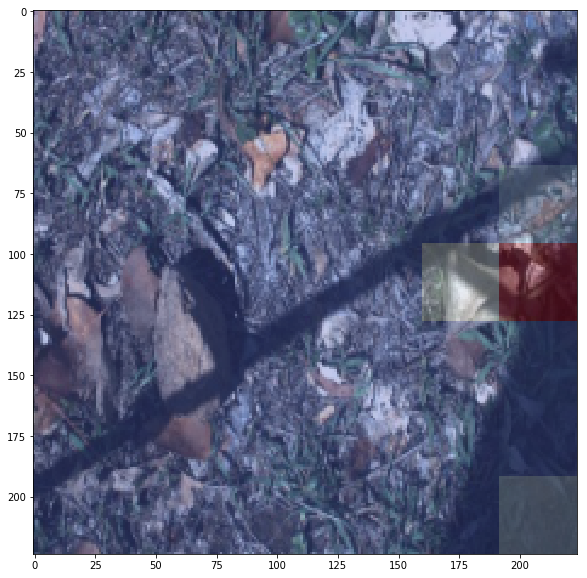

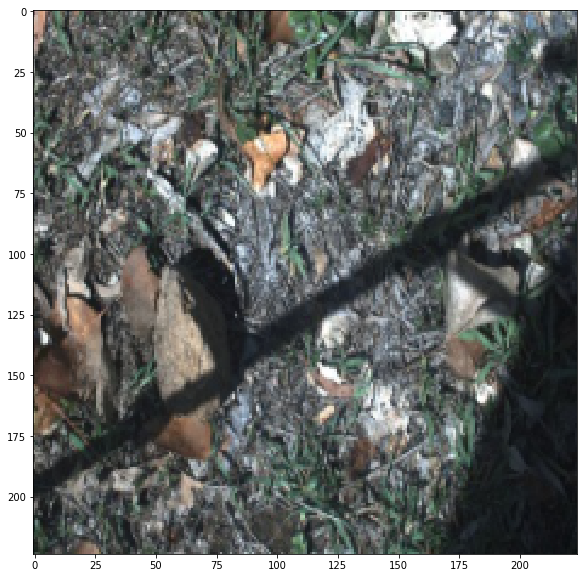

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.7193e-05, 1.2368e-04, 9.9972e-01, 2.1282e-06, 5.1761e-06, 6.2484e-07,
        1.1108e-05, 3.9857e-06, 6.7268e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.9323e-03, 2.4981e-02, 9.6881e-01, 1.1714e-05, 7.1689e-05, 3.3333e-06,
        4.2305e-04, 3.3200e-05, 1.7316e-03], device='cuda:0')
Class predictions according to model:  tensor([6.7193e-05, 1.2368e-04, 9.9972e-01, 2.1282e-06, 5.1761e-06, 6.2484e-07,
        1.1108e-05, 3.9857e-06, 6.7268e-05], device='cuda:0')
tensor([[3.1858e-02, 3.1858e-02, 3.1858e-02,  ..., 2.7972e-04, 2.7972e-04,
         2.7972e-04],
        [3.1858e-02, 3.1858e-02, 3.1858e-02,  ..., 2.7972e-04, 2.7972e-04,
         2.7972e-04],
        [3.1858e-02, 3.1858e-02, 3.1858e-02,  ..., 2.7972e-04, 2.7972e-04,
         2.7972e-04],
        ...,
        [5.3511e-01, 5.3511e-01, 5.3511e-01,  ..., 1.9774e-01, 1.9

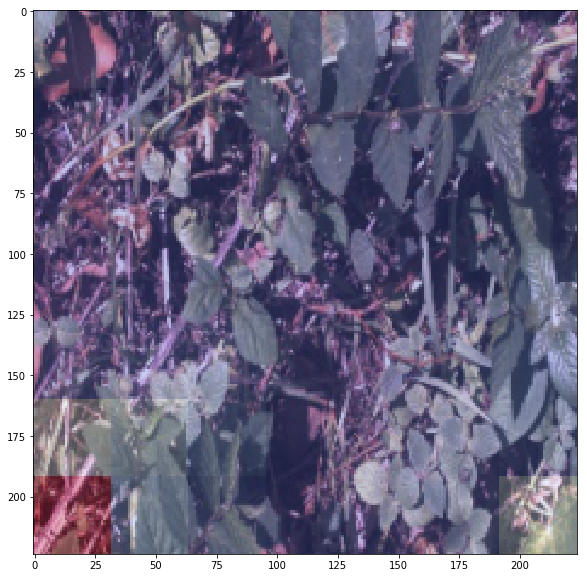

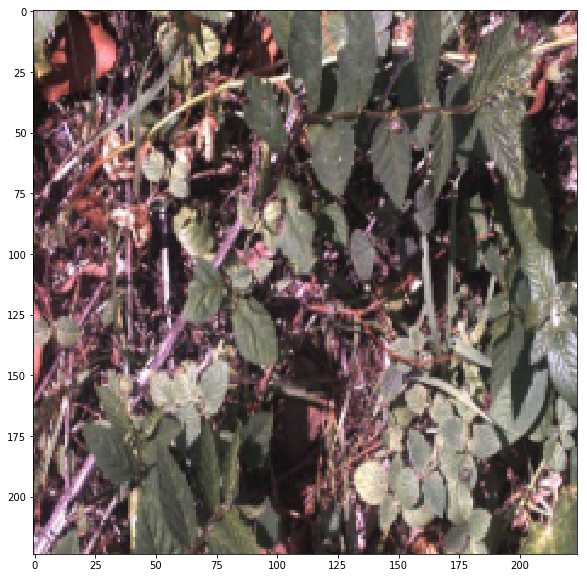

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.8232e-03, 1.2508e-04, 9.9173e-01, 2.9388e-05, 2.1402e-05, 3.0590e-05,
        1.5745e-04, 3.1428e-05, 1.0559e-03], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.2631e-01, 6.9849e-03, 6.7894e-01, 3.0910e-04, 6.3175e-05, 2.8929e-04,
        1.5756e-02, 1.9832e-04, 7.1151e-02], device='cuda:0')
Class predictions according to model:  tensor([6.8232e-03, 1.2508e-04, 9.9173e-01, 2.9388e-05, 2.1402e-05, 3.0590e-05,
        1.5745e-04, 3.1428e-05, 1.0559e-03], device='cuda:0')
tensor([[0.8051, 0.8051, 0.8051,  ..., 0.0023, 0.0023, 0.0023],
        [0.8051, 0.8051, 0.8051,  ..., 0.0023, 0.0023, 0.0023],
        [0.8051, 0.8051, 0.8051,  ..., 0.0023, 0.0023, 0.0023],
        ...,
        [0.9902, 0.9902, 0.9902,  ..., 0.9863, 0.9863, 0.9863],
        [0.9902, 0.9902, 0.9902,  ..., 0.9863, 0.9863, 0.9863],
        [0.9902, 0.9902, 0.9902,  ...

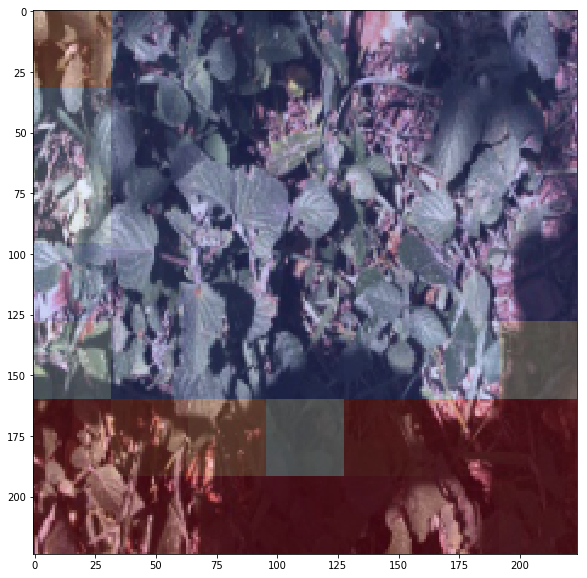

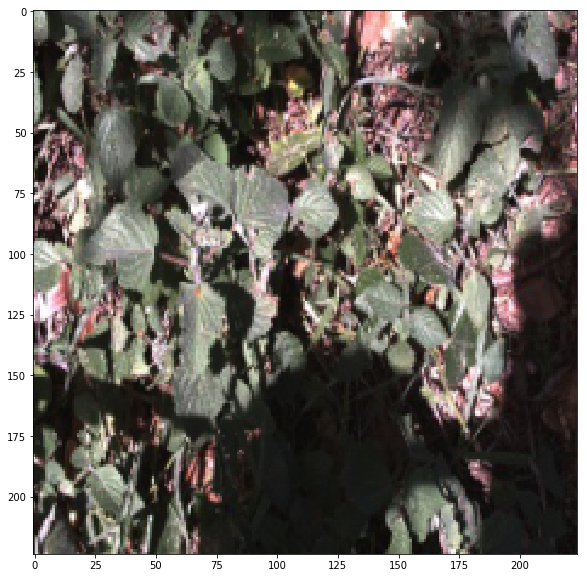

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([4.7686e-06, 7.4445e-06, 9.9979e-01, 6.6112e-06, 1.3654e-05, 6.5346e-06,
        2.2343e-05, 1.2916e-04, 2.1084e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.1556e-05, 1.3544e-04, 9.9020e-01, 4.0855e-03, 1.1825e-04, 3.3792e-04,
        2.4639e-04, 4.4803e-03, 3.5641e-04], device='cuda:0')
Class predictions according to model:  tensor([4.7686e-06, 7.4445e-06, 9.9979e-01, 6.6112e-06, 1.3654e-05, 6.5346e-06,
        2.2343e-05, 1.2916e-04, 2.1084e-05], device='cuda:0')
tensor([[0.2645, 0.2645, 0.2645,  ..., 0.0217, 0.0217, 0.0217],
        [0.2645, 0.2645, 0.2645,  ..., 0.0217, 0.0217, 0.0217],
        [0.2645, 0.2645, 0.2645,  ..., 0.0217, 0.0217, 0.0217],
        ...,
        [0.1199, 0.1199, 0.1199,  ..., 0.0100, 0.0100, 0.0100],
        [0.1199, 0.1199, 0.1199,  ..., 0.0100, 0.0100, 0.0100],
        [0.1199, 0.1199, 0.1199,  ...

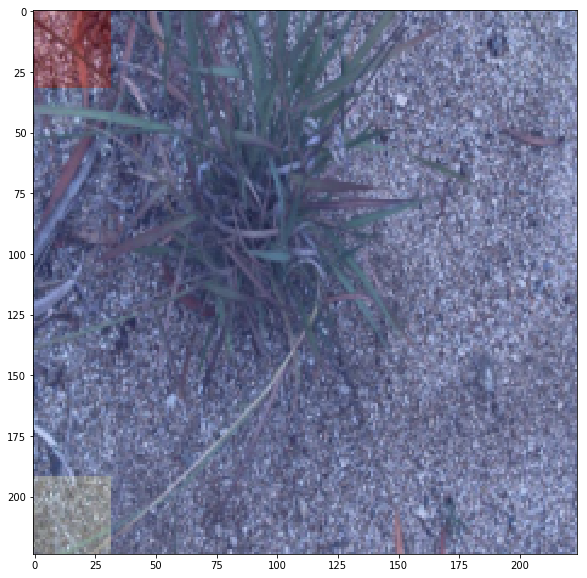

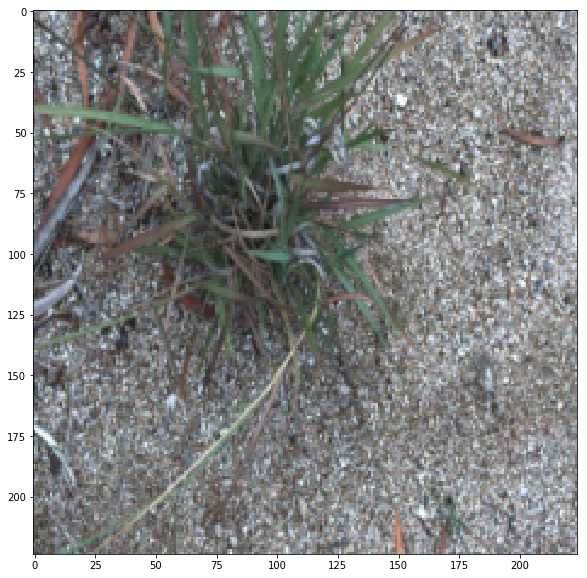

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([8.2926e-02, 3.2025e-02, 8.5193e-01, 7.4250e-05, 3.7513e-03, 5.2188e-05,
        3.0779e-04, 4.9525e-04, 2.8435e-02], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.7097e-01, 9.4322e-02, 4.6545e-01, 7.2056e-04, 1.2614e-01, 1.4997e-04,
        7.0342e-04, 1.4556e-02, 2.6995e-02], device='cuda:0')
Class predictions according to model:  tensor([8.2926e-02, 3.2025e-02, 8.5193e-01, 7.4250e-05, 3.7513e-03, 5.2188e-05,
        3.0779e-04, 4.9525e-04, 2.8435e-02], device='cuda:0')
tensor([[7.4047e-04, 7.4047e-04, 7.4047e-04,  ..., 1.8612e-01, 1.8612e-01,
         1.8612e-01],
        [7.4047e-04, 7.4047e-04, 7.4047e-04,  ..., 1.8612e-01, 1.8612e-01,
         1.8612e-01],
        [7.4047e-04, 7.4047e-04, 7.4047e-04,  ..., 1.8612e-01, 1.8612e-01,
         1.8612e-01],
        ...,
        [7.9325e-01, 7.9325e-01, 7.9325e-01,  ..., 9.5804e-01, 9.5

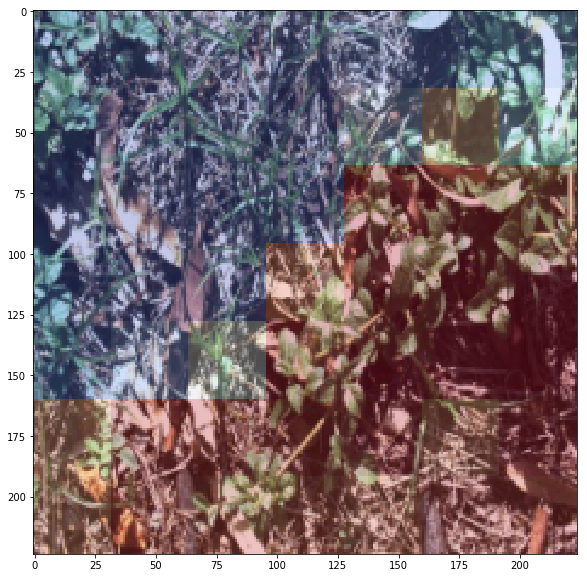

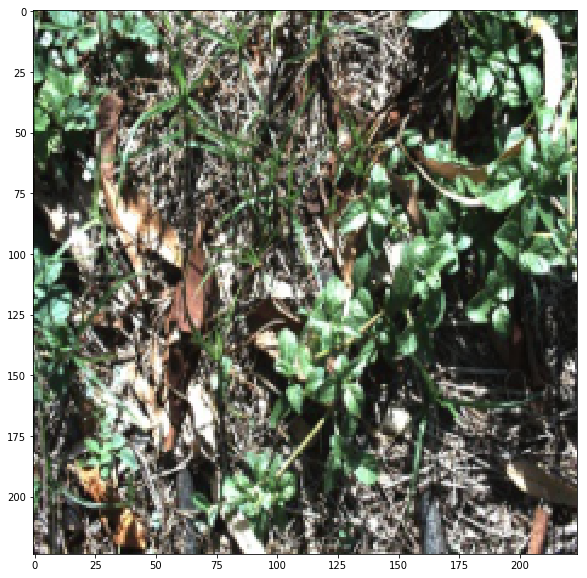

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.2883e-06, 1.4595e-06, 9.9999e-01, 1.5661e-07, 9.2808e-07, 1.2922e-07,
        4.0032e-07, 1.2186e-07, 2.7268e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.0187e-05, 3.7457e-06, 9.9997e-01, 6.6955e-07, 5.7900e-06, 6.5150e-07,
        1.4085e-06, 3.1435e-07, 8.6559e-06], device='cuda:0')
Class predictions according to model:  tensor([1.2883e-06, 1.4595e-06, 9.9999e-01, 1.5661e-07, 9.2808e-07, 1.2922e-07,
        4.0032e-07, 1.2186e-07, 2.7268e-06], device='cuda:0')
tensor([[2.2292e-05, 2.2292e-05, 2.2292e-05,  ..., 2.7984e-04, 2.7984e-04,
         2.7984e-04],
        [2.2292e-05, 2.2292e-05, 2.2292e-05,  ..., 2.7984e-04, 2.7984e-04,
         2.7984e-04],
        [2.2292e-05, 2.2292e-05, 2.2292e-05,  ..., 2.7984e-04, 2.7984e-04,
         2.7984e-04],
        ...,
        [1.2279e-05, 1.2279e-05, 1.2279e-05,  ..., 4.7219e-04, 4.7

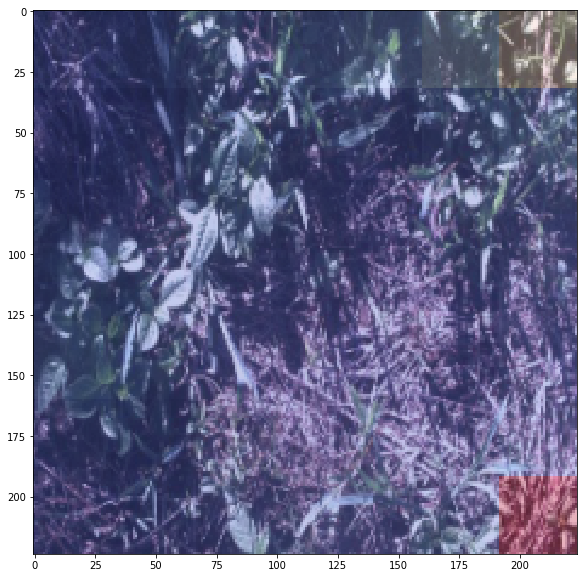

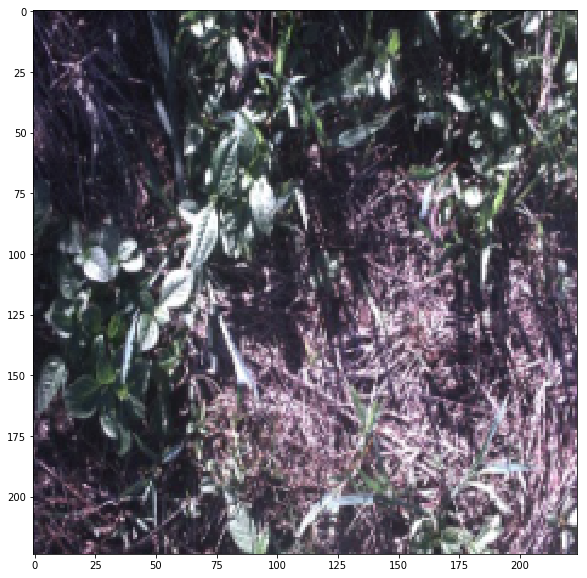

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([7.2920e-05, 1.6279e-05, 9.9963e-01, 9.3673e-06, 1.6980e-05, 2.6911e-05,
        1.0504e-05, 1.8477e-06, 2.1022e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.3015e-03, 6.9350e-05, 9.7710e-01, 2.8101e-05, 1.1279e-04, 1.9557e-04,
        6.1205e-04, 6.5068e-06, 2.0576e-02], device='cuda:0')
Class predictions according to model:  tensor([7.2920e-05, 1.6279e-05, 9.9963e-01, 9.3673e-06, 1.6980e-05, 2.6911e-05,
        1.0504e-05, 1.8477e-06, 2.1022e-04], device='cuda:0')
tensor([[5.0694e-01, 5.0694e-01, 5.0694e-01,  ..., 1.4830e-04, 1.4830e-04,
         1.4830e-04],
        [5.0694e-01, 5.0694e-01, 5.0694e-01,  ..., 1.4830e-04, 1.4830e-04,
         1.4830e-04],
        [5.0694e-01, 5.0694e-01, 5.0694e-01,  ..., 1.4830e-04, 1.4830e-04,
         1.4830e-04],
        ...,
        [7.2500e-03, 7.2500e-03, 7.2500e-03,  ..., 5.8230e-03, 5.8

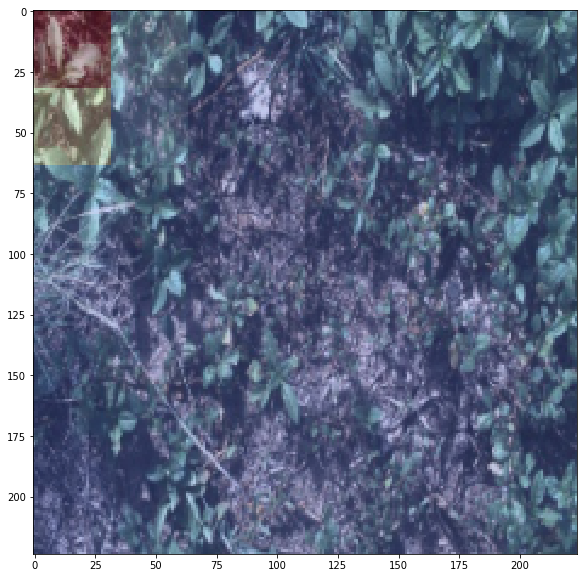

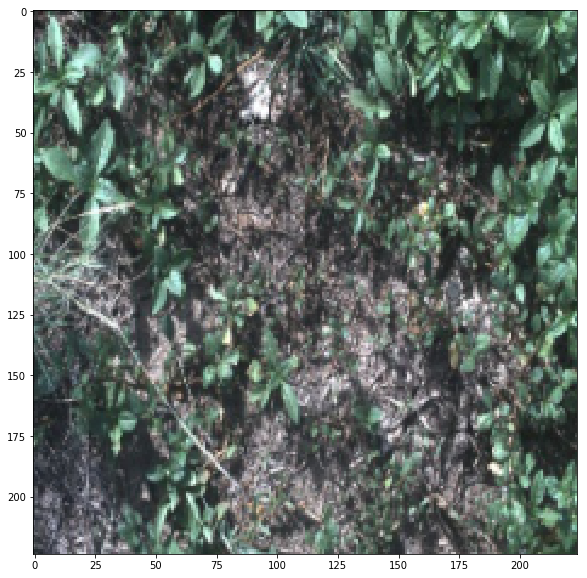

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([4.9447e-05, 1.3918e-04, 9.9954e-01, 2.0368e-05, 1.9765e-05, 9.0305e-06,
        1.1952e-04, 2.3714e-05, 7.7208e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.2432e-04, 2.9153e-03, 9.9377e-01, 3.2586e-04, 1.0347e-04, 1.5186e-04,
        6.4785e-04, 6.7739e-04, 6.8827e-04], device='cuda:0')
Class predictions according to model:  tensor([4.9447e-05, 1.3918e-04, 9.9954e-01, 2.0368e-05, 1.9765e-05, 9.0305e-06,
        1.1952e-04, 2.3714e-05, 7.7208e-05], device='cuda:0')
tensor([[8.0995e-02, 8.0995e-02, 8.0995e-02,  ..., 4.1900e-02, 4.1900e-02,
         4.1900e-02],
        [8.0995e-02, 8.0995e-02, 8.0995e-02,  ..., 4.1900e-02, 4.1900e-02,
         4.1900e-02],
        [8.0995e-02, 8.0995e-02, 8.0995e-02,  ..., 4.1900e-02, 4.1900e-02,
         4.1900e-02],
        ...,
        [1.4029e-03, 1.4029e-03, 1.4029e-03,  ..., 8.4519e-05, 8.4

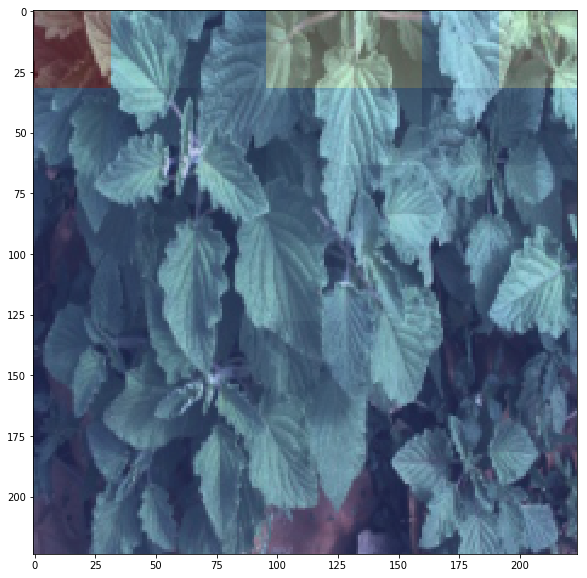

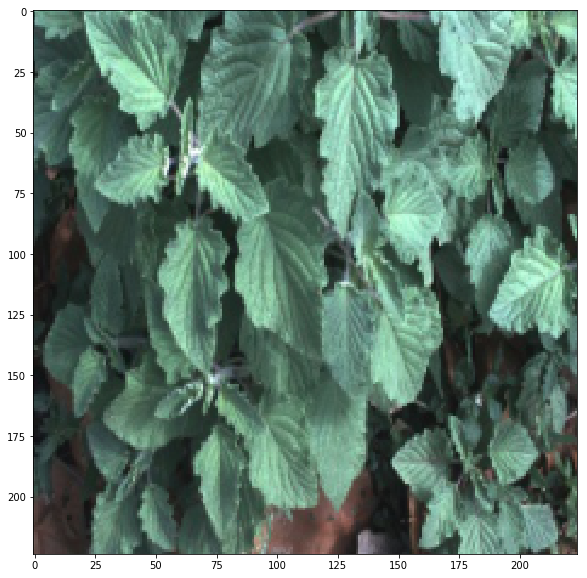

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([3.9313e-04, 7.8678e-04, 9.9784e-01, 4.4432e-06, 3.3595e-05, 5.0440e-06,
        3.0302e-05, 1.5964e-04, 7.4847e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.1824e-01, 6.3769e-02, 7.2762e-01, 1.6266e-04, 9.2621e-04, 1.6813e-04,
        1.0121e-04, 3.6408e-02, 5.2611e-02], device='cuda:0')
Class predictions according to model:  tensor([3.9313e-04, 7.8678e-04, 9.9784e-01, 4.4433e-06, 3.3595e-05, 5.0440e-06,
        3.0302e-05, 1.5964e-04, 7.4847e-04], device='cuda:0')
tensor([[9.8928e-01, 9.8928e-01, 9.8928e-01,  ..., 5.5404e-01, 5.5404e-01,
         5.5404e-01],
        [9.8928e-01, 9.8928e-01, 9.8928e-01,  ..., 5.5404e-01, 5.5404e-01,
         5.5404e-01],
        [9.8928e-01, 9.8928e-01, 9.8928e-01,  ..., 5.5404e-01, 5.5404e-01,
         5.5404e-01],
        ...,
        [6.6234e-01, 6.6234e-01, 6.6234e-01,  ..., 2.8610e-06, 2.8

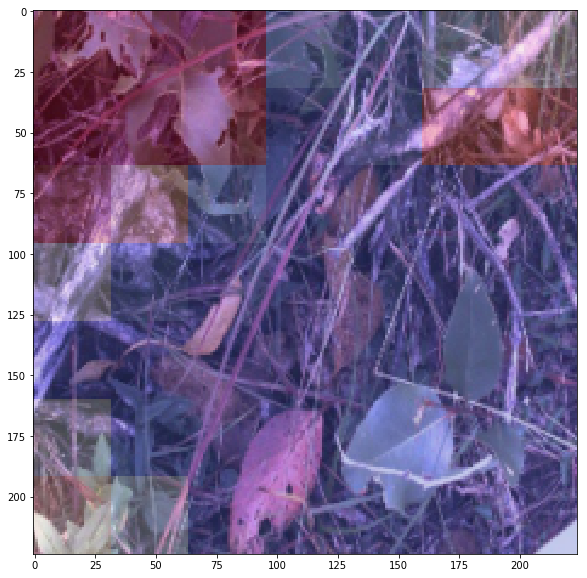

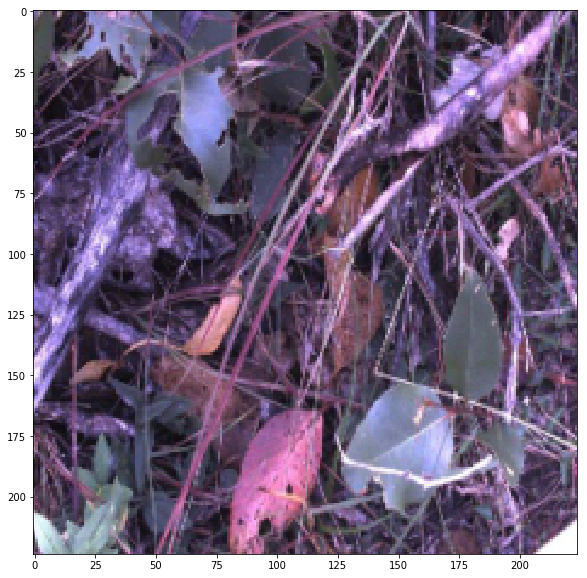

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.5233e-06, 2.6215e-06, 9.9986e-01, 2.1838e-06, 1.0937e-04, 6.3326e-06,
        3.9059e-06, 1.7159e-06, 9.6941e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.6312e-04, 2.6594e-05, 9.8299e-01, 2.3132e-04, 6.1403e-03, 1.0175e-02,
        3.0377e-05, 9.7706e-06, 2.3293e-04], device='cuda:0')
Class predictions according to model:  tensor([6.5233e-06, 2.6215e-06, 9.9986e-01, 2.1838e-06, 1.0937e-04, 6.3326e-06,
        3.9059e-06, 1.7159e-06, 9.6941e-06], device='cuda:0')
tensor([[3.1352e-05, 3.1352e-05, 3.1352e-05,  ..., 2.5213e-02, 2.5213e-02,
         2.5213e-02],
        [3.1352e-05, 3.1352e-05, 3.1352e-05,  ..., 2.5213e-02, 2.5213e-02,
         2.5213e-02],
        [3.1352e-05, 3.1352e-05, 3.1352e-05,  ..., 2.5213e-02, 2.5213e-02,
         2.5213e-02],
        ...,
        [6.1863e-01, 6.1863e-01, 6.1863e-01,  ..., 7.7367e-05, 7.7

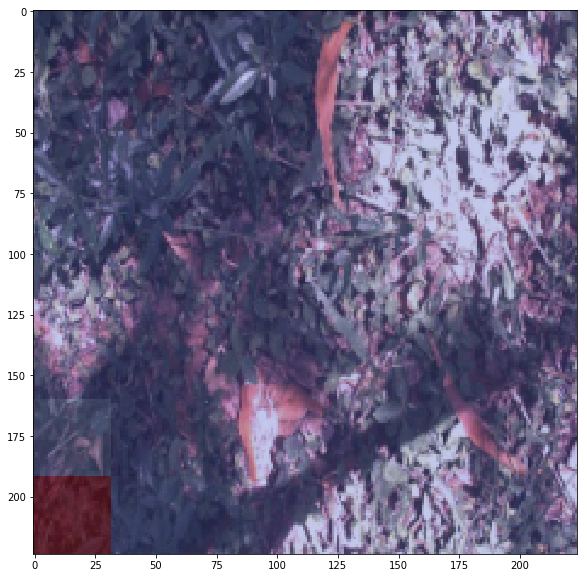

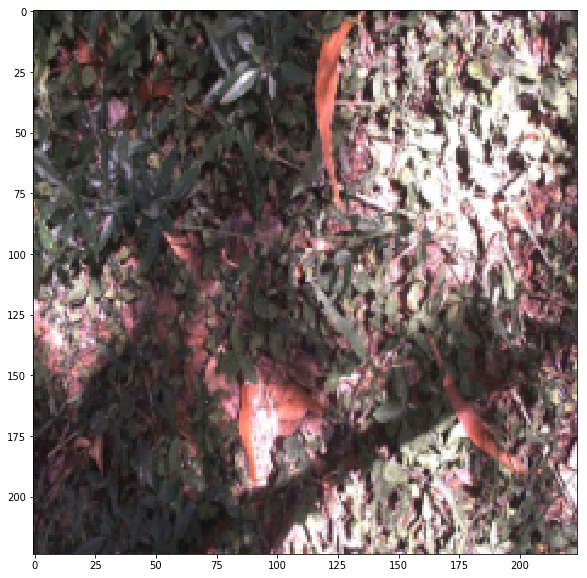

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([2.1903e-06, 1.2256e-06, 9.9999e-01, 2.0413e-06, 2.1559e-06, 1.1311e-06,
        1.2615e-06, 1.3294e-06, 1.7394e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.5717e-05, 3.6342e-05, 9.9964e-01, 7.2761e-05, 4.4942e-05, 4.8997e-05,
        5.0337e-05, 4.0715e-05, 3.0825e-05], device='cuda:0')
Class predictions according to model:  tensor([2.1903e-06, 1.2256e-06, 9.9999e-01, 2.0413e-06, 2.1559e-06, 1.1311e-06,
        1.2615e-06, 1.3294e-06, 1.7394e-06], device='cuda:0')
tensor([[1.4468e-02, 1.4468e-02, 1.4468e-02,  ..., 8.3447e-07, 8.3447e-07,
         8.3447e-07],
        [1.4468e-02, 1.4468e-02, 1.4468e-02,  ..., 8.3447e-07, 8.3447e-07,
         8.3447e-07],
        [1.4468e-02, 1.4468e-02, 1.4468e-02,  ..., 8.3447e-07, 8.3447e-07,
         8.3447e-07],
        ...,
        [6.1607e-04, 6.1607e-04, 6.1607e-04,  ..., 3.5286e-05, 3.5

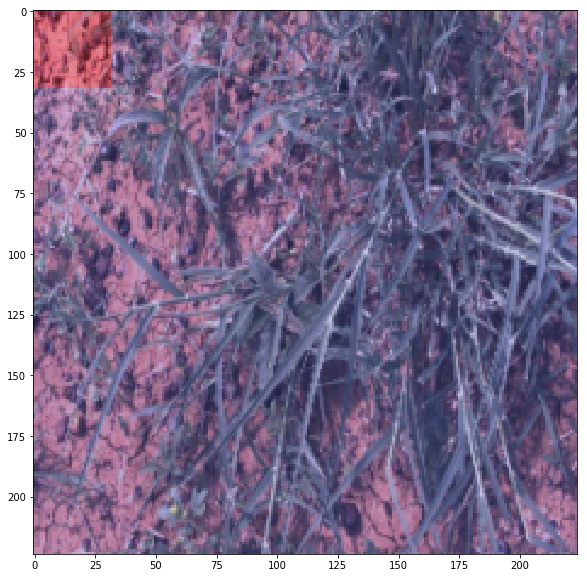

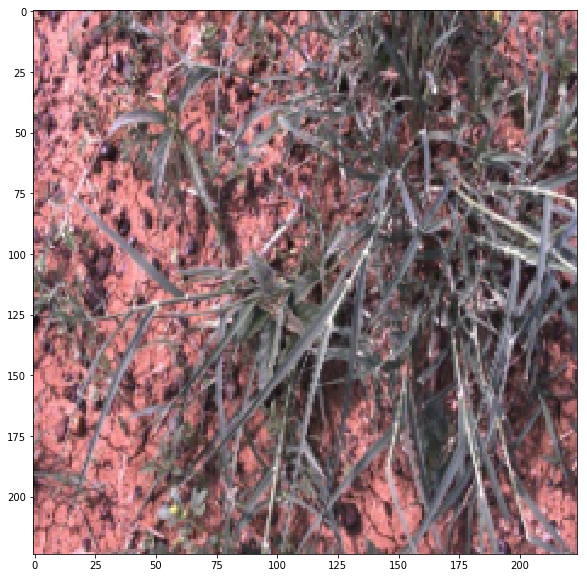

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.5255e-02, 2.1019e-02, 2.9801e-01, 6.6104e-04, 1.4328e-03, 2.0540e-04,
        6.6165e-01, 4.9136e-04, 1.2719e-03], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([0.0890, 0.0937, 0.4074, 0.0182, 0.0030, 0.0008, 0.3681, 0.0013, 0.0185],
       device='cuda:0')
Class predictions according to model:  tensor([1.5255e-02, 2.1019e-02, 2.9801e-01, 6.6104e-04, 1.4328e-03, 2.0540e-04,
        6.6165e-01, 4.9136e-04, 1.2719e-03], device='cuda:0')
tensor([[0.0012, 0.0012, 0.0012,  ..., 0.9424, 0.9424, 0.9424],
        [0.0012, 0.0012, 0.0012,  ..., 0.9424, 0.9424, 0.9424],
        [0.0012, 0.0012, 0.0012,  ..., 0.9424, 0.9424, 0.9424],
        ...,
        [0.9983, 0.9983, 0.9983,  ..., 0.7826, 0.7826, 0.7826],
        [0.9983, 0.9983, 0.9983,  ..., 0.7826, 0.7826, 0.7826],
        [0.9983, 0.9983, 0.9983,  ..., 0.7826, 0.7826, 0.7826]]) tensor(0.

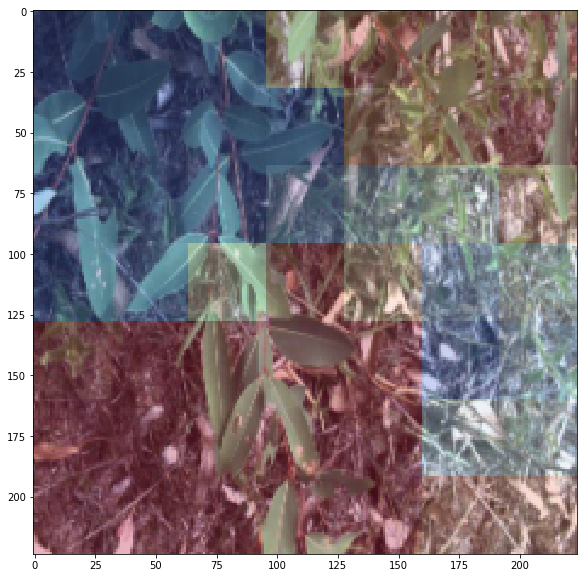

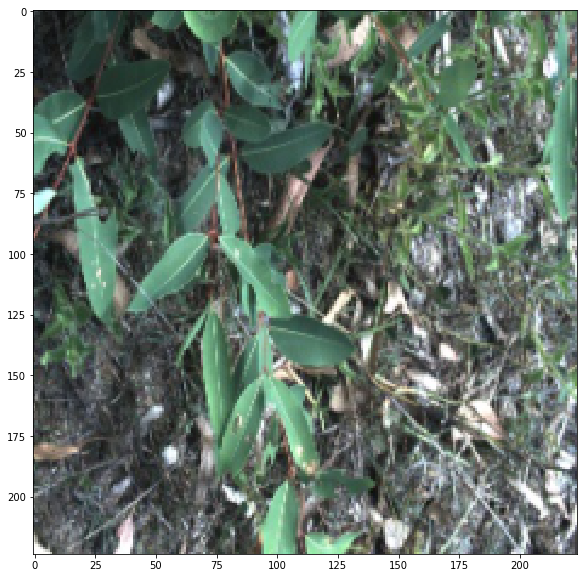

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.0788e-06, 1.5260e-03, 9.9830e-01, 3.2449e-06, 1.3605e-04, 1.2099e-06,
        2.8557e-06, 3.8603e-06, 1.9297e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.3482e-04, 3.7147e-02, 9.5653e-01, 1.4544e-05, 5.2015e-03, 1.9324e-05,
        2.3234e-05, 1.3581e-04, 7.8875e-04], device='cuda:0')
Class predictions according to model:  tensor([6.0788e-06, 1.5260e-03, 9.9830e-01, 3.2449e-06, 1.3605e-04, 1.2099e-06,
        2.8557e-06, 3.8603e-06, 1.9297e-05], device='cuda:0')
tensor([[4.3605e-02, 4.3605e-02, 4.3605e-02,  ..., 7.7963e-04, 7.7963e-04,
         7.7963e-04],
        [4.3605e-02, 4.3605e-02, 4.3605e-02,  ..., 7.7963e-04, 7.7963e-04,
         7.7963e-04],
        [4.3605e-02, 4.3605e-02, 4.3605e-02,  ..., 7.7963e-04, 7.7963e-04,
         7.7963e-04],
        ...,
        [5.9588e-01, 5.9588e-01, 5.9588e-01,  ..., 1.8471e-04, 1.8

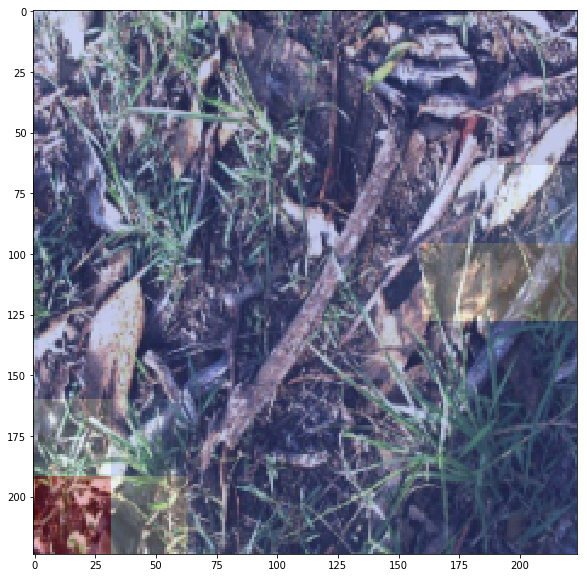

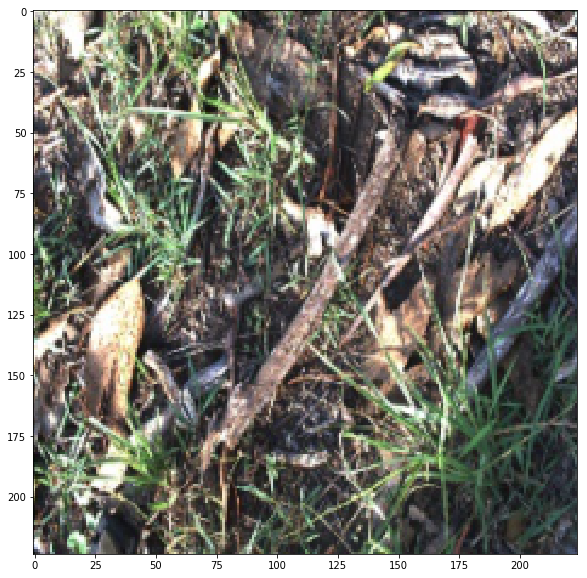

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([3.9004e-02, 1.1898e-03, 8.7598e-01, 8.0327e-05, 2.1486e-04, 3.1789e-05,
        4.0188e-05, 4.2829e-05, 8.3421e-02], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.3790e-01, 2.1638e-03, 6.5326e-01, 2.1720e-04, 4.8690e-04, 2.8976e-04,
        9.6483e-05, 7.4786e-05, 2.0551e-01], device='cuda:0')
Class predictions according to model:  tensor([3.9004e-02, 1.1898e-03, 8.7598e-01, 8.0327e-05, 2.1486e-04, 3.1790e-05,
        4.0188e-05, 4.2829e-05, 8.3421e-02], device='cuda:0')
tensor([[0.9789, 0.9789, 0.9789,  ..., 0.3969, 0.3969, 0.3969],
        [0.9789, 0.9789, 0.9789,  ..., 0.3969, 0.3969, 0.3969],
        [0.9789, 0.9789, 0.9789,  ..., 0.3969, 0.3969, 0.3969],
        ...,
        [0.8904, 0.8904, 0.8904,  ..., 0.0021, 0.0021, 0.0021],
        [0.8904, 0.8904, 0.8904,  ..., 0.0021, 0.0021, 0.0021],
        [0.8904, 0.8904, 0.8904,  ...

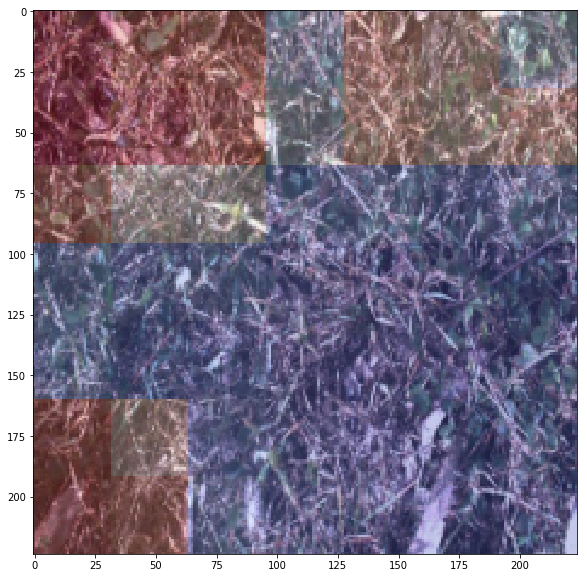

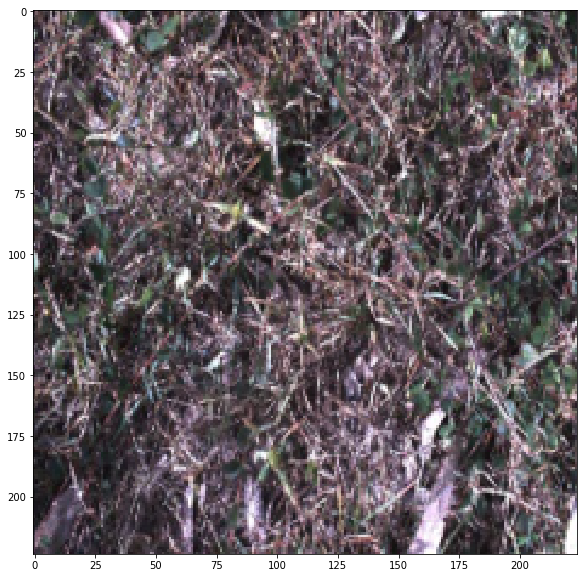

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([2.4342e-04, 2.6763e-05, 9.9962e-01, 2.4101e-06, 4.8139e-06, 3.1424e-06,
        5.3452e-05, 3.5474e-06, 4.0107e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.3435e-02, 2.0573e-02, 9.2244e-01, 1.9423e-04, 2.0660e-04, 1.3971e-04,
        1.8842e-03, 1.4225e-04, 9.8726e-04], device='cuda:0')
Class predictions according to model:  tensor([2.4342e-04, 2.6763e-05, 9.9962e-01, 2.4101e-06, 4.8139e-06, 3.1424e-06,
        5.3452e-05, 3.5474e-06, 4.0107e-05], device='cuda:0')
tensor([[0.7990, 0.7990, 0.7990,  ..., 0.0010, 0.0010, 0.0010],
        [0.7990, 0.7990, 0.7990,  ..., 0.0010, 0.0010, 0.0010],
        [0.7990, 0.7990, 0.7990,  ..., 0.0010, 0.0010, 0.0010],
        ...,
        [0.0447, 0.0447, 0.0447,  ..., 0.0136, 0.0136, 0.0136],
        [0.0447, 0.0447, 0.0447,  ..., 0.0136, 0.0136, 0.0136],
        [0.0447, 0.0447, 0.0447,  ...

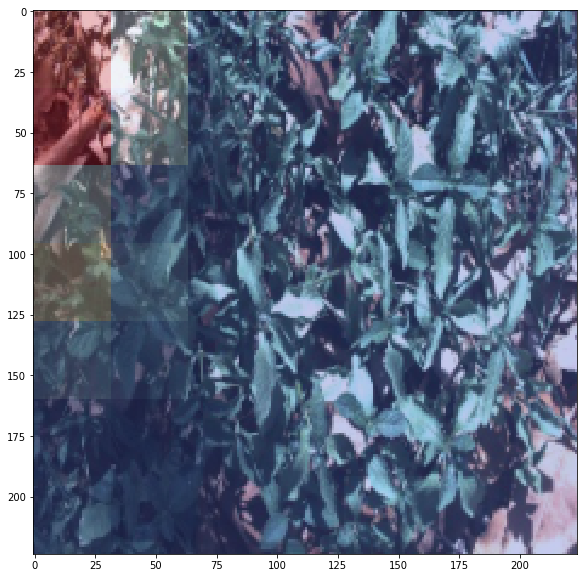

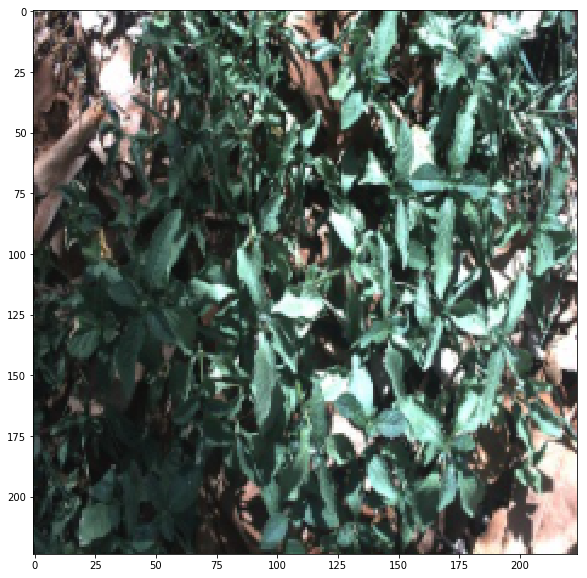

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([5.3891e-06, 5.1016e-06, 9.9969e-01, 2.6534e-04, 5.2438e-06, 4.3087e-06,
        3.1437e-06, 1.2499e-05, 7.2541e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.2692e-04, 6.9643e-04, 8.8082e-01, 1.1117e-01, 3.5399e-04, 3.3639e-03,
        6.7193e-05, 2.1911e-03, 9.1087e-04], device='cuda:0')
Class predictions according to model:  tensor([5.3891e-06, 5.1016e-06, 9.9969e-01, 2.6534e-04, 5.2438e-06, 4.3087e-06,
        3.1437e-06, 1.2499e-05, 7.2541e-06], device='cuda:0')
tensor([[3.6795e-01, 3.6795e-01, 3.6795e-01,  ..., 2.2292e-05, 2.2292e-05,
         2.2292e-05],
        [3.6795e-01, 3.6795e-01, 3.6795e-01,  ..., 2.2292e-05, 2.2292e-05,
         2.2292e-05],
        [3.6795e-01, 3.6795e-01, 3.6795e-01,  ..., 2.2292e-05, 2.2292e-05,
         2.2292e-05],
        ...,
        [6.0307e-01, 6.0307e-01, 6.0307e-01,  ..., 9.0811e-01, 9.0

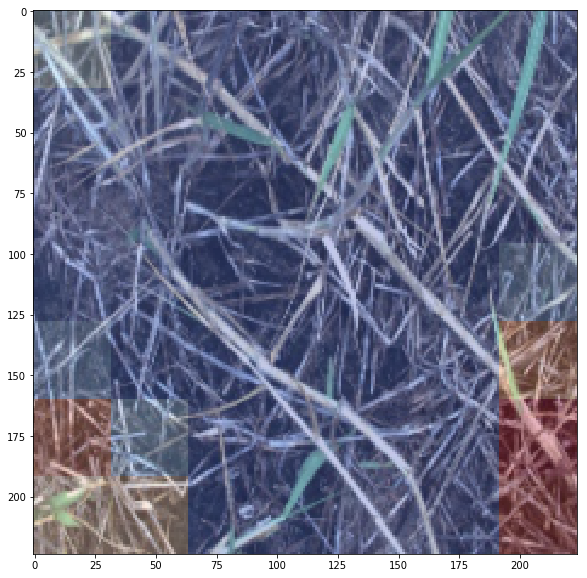

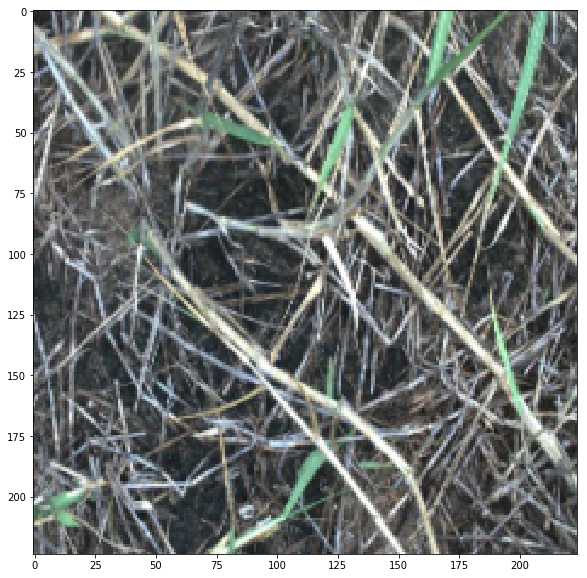

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.0115e-05, 4.8453e-06, 9.9996e-01, 7.7419e-06, 1.7551e-06, 4.0077e-06,
        1.5590e-06, 1.2568e-06, 4.0860e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.3851e-04, 1.5362e-04, 9.5626e-01, 3.9846e-02, 1.3545e-05, 3.1467e-03,
        5.2149e-05, 1.2784e-05, 7.9023e-05], device='cuda:0')
Class predictions according to model:  tensor([1.0115e-05, 4.8453e-06, 9.9996e-01, 7.7419e-06, 1.7551e-06, 4.0077e-06,
        1.5590e-06, 1.2568e-06, 4.0860e-06], device='cuda:0')
tensor([[2.2054e-05, 2.2054e-05, 2.2054e-05,  ..., 9.2105e-03, 9.2105e-03,
         9.2105e-03],
        [2.2054e-05, 2.2054e-05, 2.2054e-05,  ..., 9.2105e-03, 9.2105e-03,
         9.2105e-03],
        [2.2054e-05, 2.2054e-05, 2.2054e-05,  ..., 9.2105e-03, 9.2105e-03,
         9.2105e-03],
        ...,
        [9.8641e-01, 9.8641e-01, 9.8641e-01,  ..., 1.8102e-04, 1.8

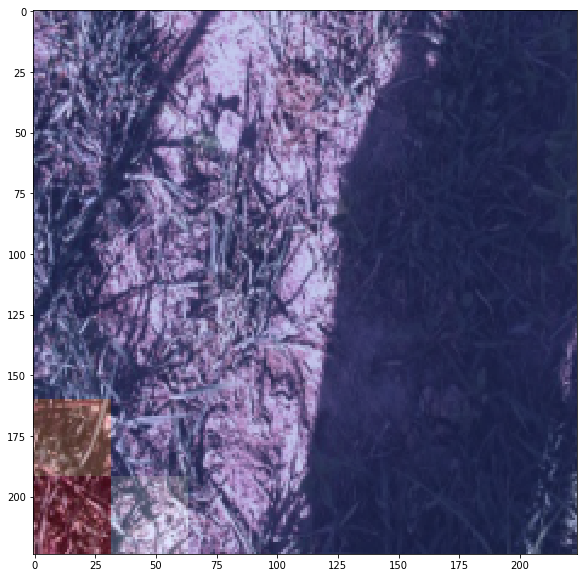

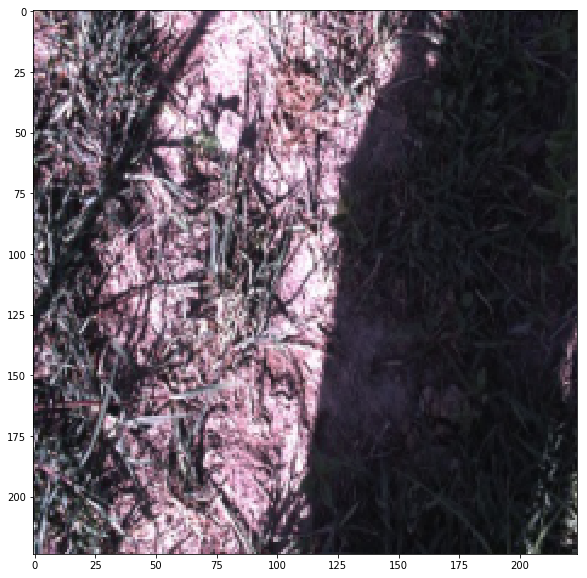

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.4113e-06, 1.2728e-06, 9.9998e-01, 9.6528e-07, 2.9167e-06, 5.3783e-07,
        1.8502e-06, 5.9860e-06, 1.5968e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.8459e-05, 8.1227e-06, 9.9976e-01, 1.2597e-05, 3.3517e-05, 9.2728e-06,
        2.0484e-05, 1.1445e-04, 1.8114e-05], device='cuda:0')
Class predictions according to model:  tensor([1.4113e-06, 1.2728e-06, 9.9998e-01, 9.6528e-07, 2.9167e-06, 5.3783e-07,
        1.8502e-06, 5.9860e-06, 1.5968e-06], device='cuda:0')
tensor([[0.0010, 0.0010, 0.0010,  ..., 0.0022, 0.0022, 0.0022],
        [0.0010, 0.0010, 0.0010,  ..., 0.0022, 0.0022, 0.0022],
        [0.0010, 0.0010, 0.0010,  ..., 0.0022, 0.0022, 0.0022],
        ...,
        [0.0042, 0.0042, 0.0042,  ..., 0.0004, 0.0004, 0.0004],
        [0.0042, 0.0042, 0.0042,  ..., 0.0004, 0.0004, 0.0004],
        [0.0042, 0.0042, 0.0042,  ...

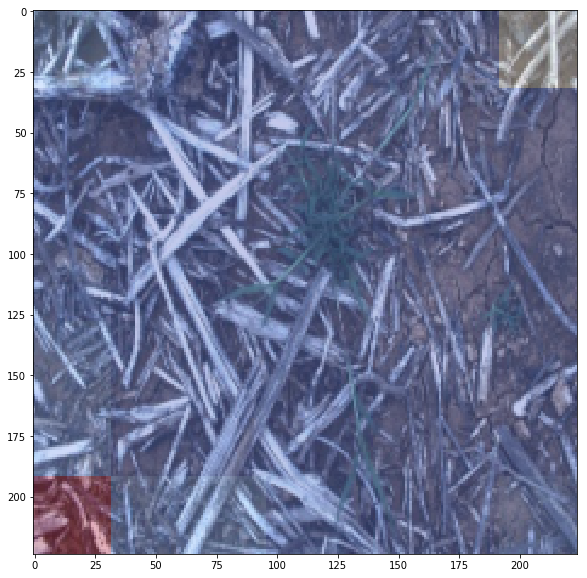

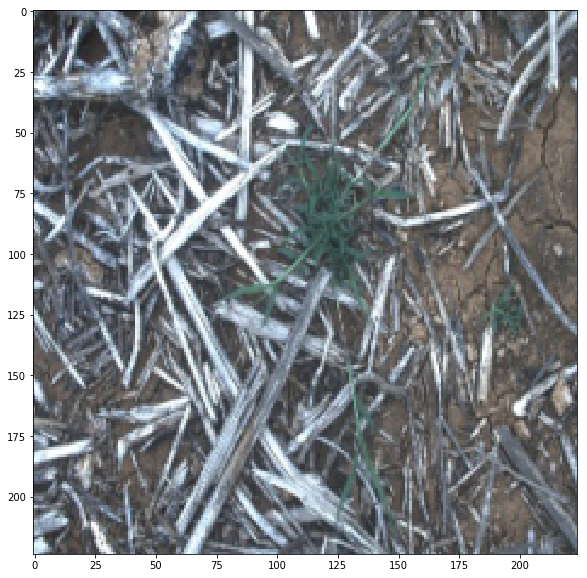

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([3.0995e-04, 7.8960e-05, 9.9118e-01, 3.1219e-05, 7.1770e-04, 2.0721e-04,
        7.1312e-03, 2.8258e-05, 3.1058e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.6884e-03, 6.5977e-03, 9.0222e-01, 1.4878e-03, 2.0367e-02, 6.0495e-03,
        5.7153e-02, 6.3740e-04, 3.8024e-03], device='cuda:0')
Class predictions according to model:  tensor([3.0995e-04, 7.8960e-05, 9.9118e-01, 3.1219e-05, 7.1770e-04, 2.0721e-04,
        7.1312e-03, 2.8258e-05, 3.1058e-04], device='cuda:0')
tensor([[0.2112, 0.2112, 0.2112,  ..., 0.0029, 0.0029, 0.0029],
        [0.2112, 0.2112, 0.2112,  ..., 0.0029, 0.0029, 0.0029],
        [0.2112, 0.2112, 0.2112,  ..., 0.0029, 0.0029, 0.0029],
        ...,
        [0.1355, 0.1355, 0.1355,  ..., 0.1552, 0.1552, 0.1552],
        [0.1355, 0.1355, 0.1355,  ..., 0.1552, 0.1552, 0.1552],
        [0.1355, 0.1355, 0.1355,  ...

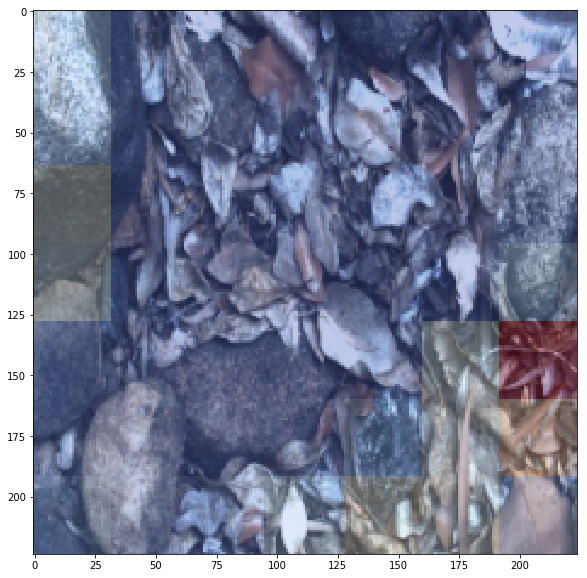

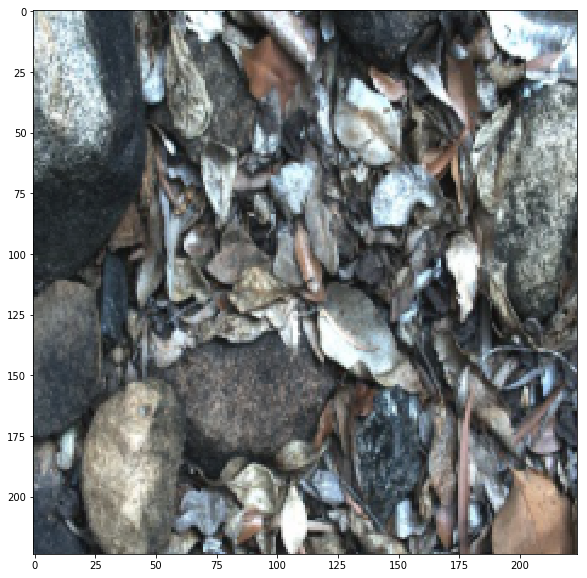

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.1522e-06, 5.4047e-06, 9.9988e-01, 8.1666e-06, 7.0681e-06, 4.4506e-06,
        7.0125e-05, 1.1050e-05, 1.0014e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.4513e-05, 2.6246e-05, 9.9777e-01, 2.4967e-04, 2.8877e-05, 7.5787e-05,
        1.6523e-03, 7.1393e-05, 7.2707e-05], device='cuda:0')
Class predictions according to model:  tensor([6.1522e-06, 5.4047e-06, 9.9988e-01, 8.1666e-06, 7.0681e-06, 4.4506e-06,
        7.0125e-05, 1.1050e-05, 1.0014e-05], device='cuda:0')
tensor([[1.8031e-02, 1.8031e-02, 1.8031e-02,  ..., 1.4663e-05, 1.4663e-05,
         1.4663e-05],
        [1.8031e-02, 1.8031e-02, 1.8031e-02,  ..., 1.4663e-05, 1.4663e-05,
         1.4663e-05],
        [1.8031e-02, 1.8031e-02, 1.8031e-02,  ..., 1.4663e-05, 1.4663e-05,
         1.4663e-05],
        ...,
        [9.1553e-05, 9.1553e-05, 9.1553e-05,  ..., 4.8842e-02, 4.8

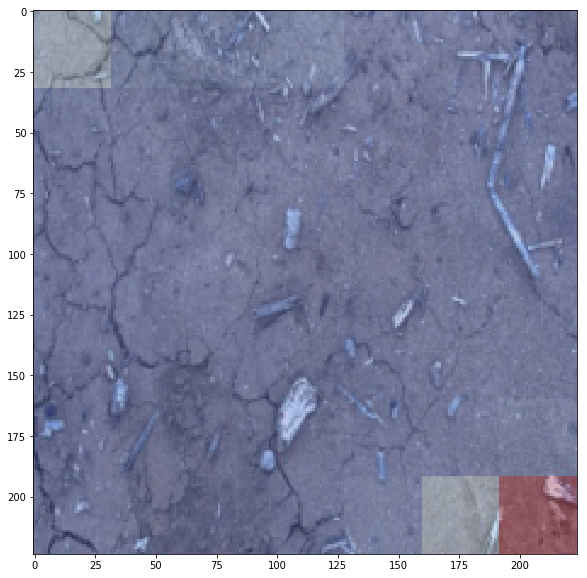

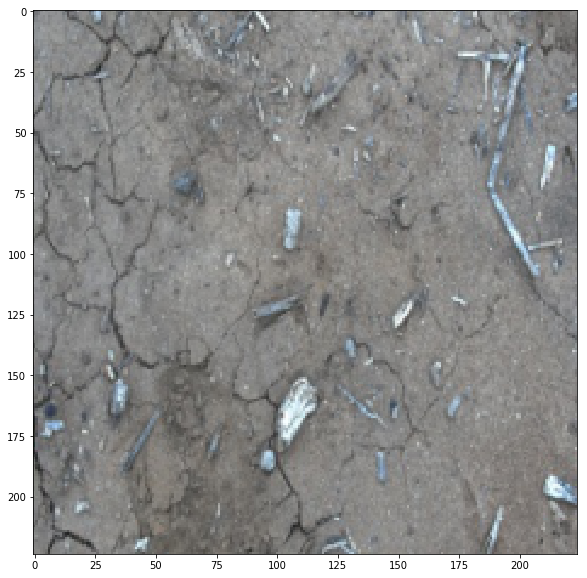

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.2856e-05, 1.0928e-05, 9.9990e-01, 2.0585e-06, 3.4062e-05, 7.7017e-07,
        3.3002e-05, 4.5316e-06, 5.4967e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.3496e-04, 1.2394e-04, 9.9634e-01, 4.8613e-05, 1.5571e-03, 1.7189e-05,
        7.1770e-04, 3.4567e-04, 1.1821e-04], device='cuda:0')
Class predictions according to model:  tensor([1.2856e-05, 1.0928e-05, 9.9990e-01, 2.0585e-06, 3.4062e-05, 7.7017e-07,
        3.3002e-05, 4.5316e-06, 5.4967e-06], device='cuda:0')
tensor([[1.4498e-02, 1.4498e-02, 1.4498e-02,  ..., 3.3855e-05, 3.3855e-05,
         3.3855e-05],
        [1.4498e-02, 1.4498e-02, 1.4498e-02,  ..., 3.3855e-05, 3.3855e-05,
         3.3855e-05],
        [1.4498e-02, 1.4498e-02, 1.4498e-02,  ..., 3.3855e-05, 3.3855e-05,
         3.3855e-05],
        ...,
        [1.1672e-03, 1.1672e-03, 1.1672e-03,  ..., 4.7299e-03, 4.7

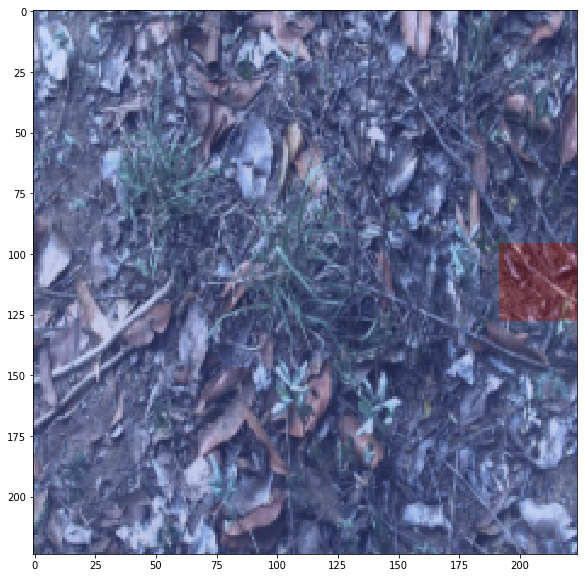

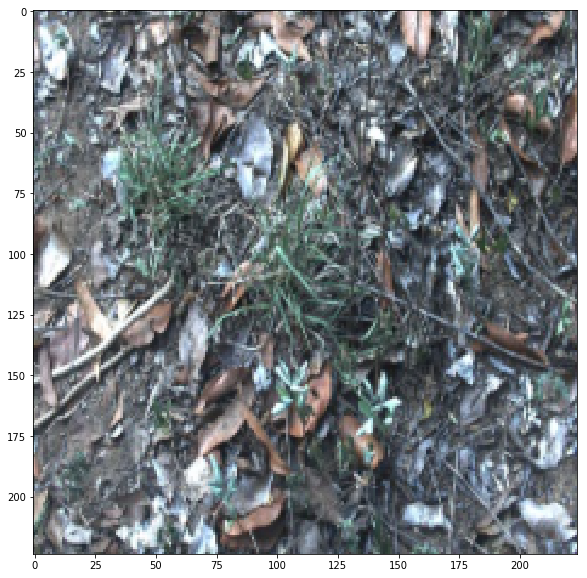

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([5.6734e-06, 8.2258e-06, 9.9995e-01, 6.3415e-07, 1.9236e-05, 6.9835e-07,
        7.7241e-06, 1.1039e-06, 5.1323e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.3372e-05, 8.6920e-03, 9.9062e-01, 2.6544e-06, 5.1871e-04, 5.2701e-05,
        4.8768e-05, 4.4531e-06, 3.0847e-05], device='cuda:0')
Class predictions according to model:  tensor([5.6734e-06, 8.2259e-06, 9.9995e-01, 6.3415e-07, 1.9236e-05, 6.9836e-07,
        7.7241e-06, 1.1039e-06, 5.1323e-06], device='cuda:0')
tensor([[4.2700e-03, 4.2700e-03, 4.2700e-03,  ..., 4.1165e-01, 4.1165e-01,
         4.1165e-01],
        [4.2700e-03, 4.2700e-03, 4.2700e-03,  ..., 4.1165e-01, 4.1165e-01,
         4.1165e-01],
        [4.2700e-03, 4.2700e-03, 4.2700e-03,  ..., 4.1165e-01, 4.1165e-01,
         4.1165e-01],
        ...,
        [9.0837e-04, 9.0837e-04, 9.0837e-04,  ..., 1.5736e-05, 1.5

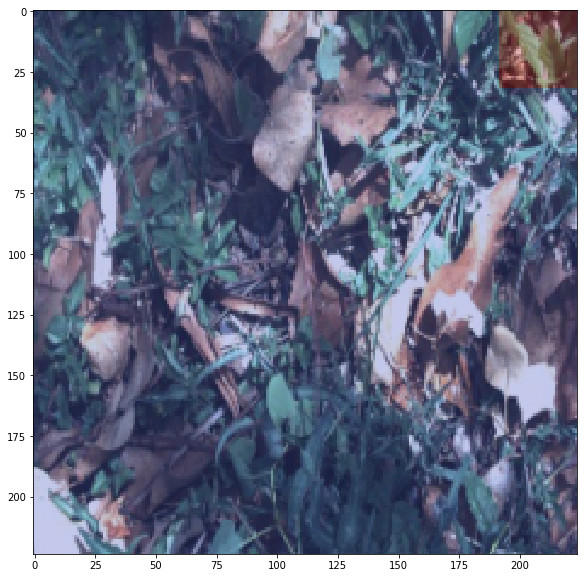

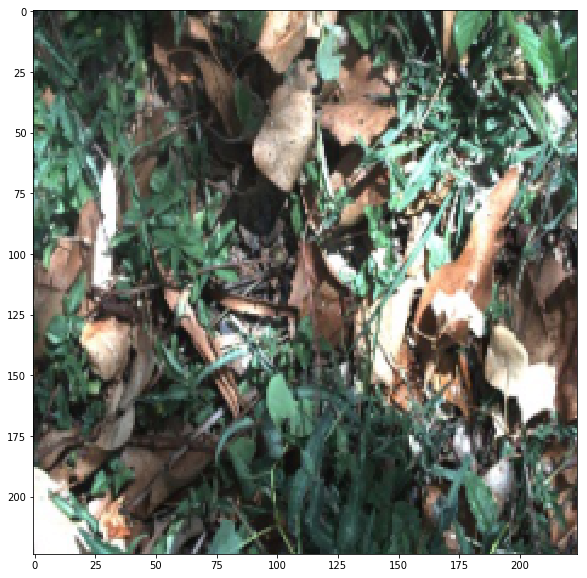

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([9.2683e-06, 4.3750e-06, 9.9993e-01, 4.1238e-06, 4.6869e-06, 3.5924e-05,
        3.2134e-06, 3.9370e-07, 8.5399e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.0119e-02, 5.9814e-04, 9.5735e-01, 1.8981e-04, 1.2560e-03, 9.1460e-03,
        1.7817e-04, 2.8537e-05, 1.1319e-03], device='cuda:0')
Class predictions according to model:  tensor([9.2683e-06, 4.3750e-06, 9.9993e-01, 4.1238e-06, 4.6869e-06, 3.5924e-05,
        3.2134e-06, 3.9370e-07, 8.5399e-06], device='cuda:0')
tensor([[1.6862e-02, 1.6862e-02, 1.6862e-02,  ..., 1.2398e-04, 1.2398e-04,
         1.2398e-04],
        [1.6862e-02, 1.6862e-02, 1.6862e-02,  ..., 1.2398e-04, 1.2398e-04,
         1.2398e-04],
        [1.6862e-02, 1.6862e-02, 1.6862e-02,  ..., 1.2398e-04, 1.2398e-04,
         1.2398e-04],
        ...,
        [7.8505e-01, 7.8505e-01, 7.8505e-01,  ..., 1.4696e-02, 1.4

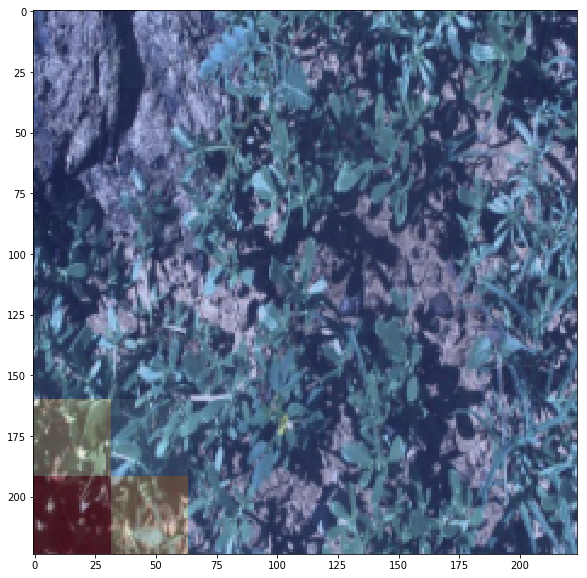

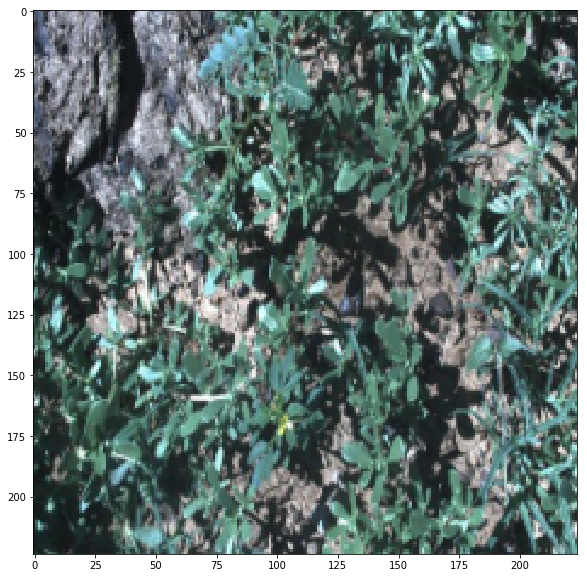

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.4526e-06, 2.1387e-05, 9.9973e-01, 3.1136e-06, 1.3108e-04, 2.5289e-05,
        4.2350e-05, 1.8900e-05, 1.7439e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.8152e-05, 4.8758e-05, 9.9249e-01, 1.1312e-05, 3.9661e-03, 3.0726e-03,
        2.7901e-04, 6.7453e-05, 4.6157e-05], device='cuda:0')
Class predictions according to model:  tensor([6.4526e-06, 2.1387e-05, 9.9973e-01, 3.1136e-06, 1.3108e-04, 2.5289e-05,
        4.2350e-05, 1.8900e-05, 1.7439e-05], device='cuda:0')
tensor([[2.3359e-04, 2.3359e-04, 2.3359e-04,  ..., 1.1394e-02, 1.1394e-02,
         1.1394e-02],
        [2.3359e-04, 2.3359e-04, 2.3359e-04,  ..., 1.1394e-02, 1.1394e-02,
         1.1394e-02],
        [2.3359e-04, 2.3359e-04, 2.3359e-04,  ..., 1.1394e-02, 1.1394e-02,
         1.1394e-02],
        ...,
        [2.3361e-03, 2.3361e-03, 2.3361e-03,  ..., 4.8518e-05, 4.8

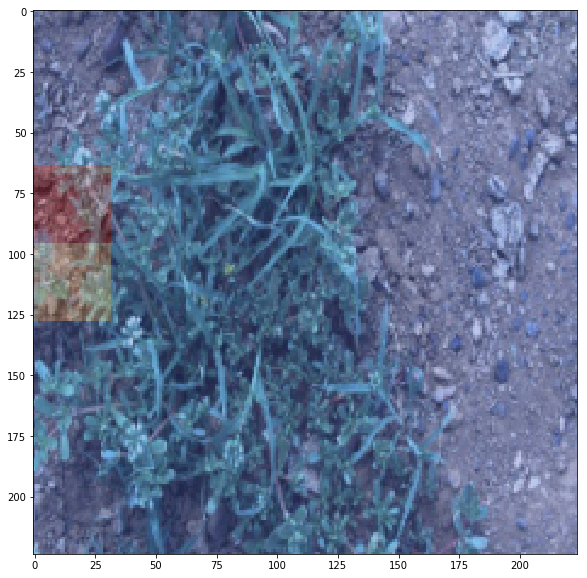

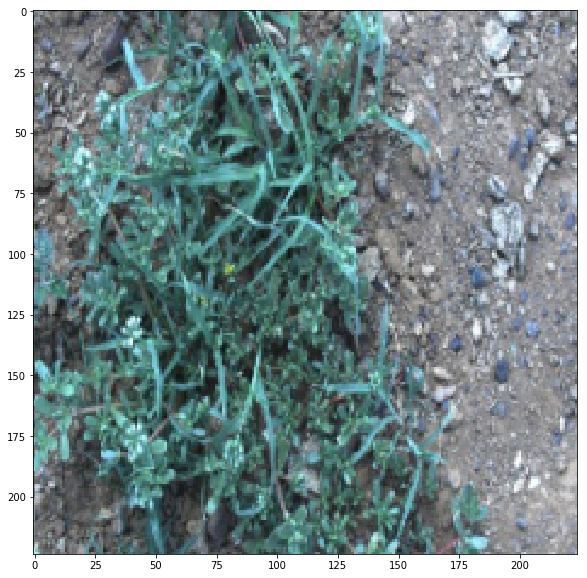

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.4095e-06, 3.2687e-06, 9.9998e-01, 3.5979e-07, 4.7685e-06, 2.9801e-07,
        4.3157e-06, 9.4893e-07, 2.4059e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([3.8973e-06, 2.6803e-05, 9.9992e-01, 4.1035e-06, 1.2467e-05, 1.0835e-06,
        1.1049e-05, 9.9409e-06, 6.3723e-06], device='cuda:0')
Class predictions according to model:  tensor([1.4095e-06, 3.2687e-06, 9.9998e-01, 3.5979e-07, 4.7685e-06, 2.9801e-07,
        4.3157e-06, 9.4892e-07, 2.4059e-06], device='cuda:0')
tensor([[4.6015e-05, 4.6015e-05, 4.6015e-05,  ..., 9.9164e-04, 9.9164e-04,
         9.9164e-04],
        [4.6015e-05, 4.6015e-05, 4.6015e-05,  ..., 9.9164e-04, 9.9164e-04,
         9.9164e-04],
        [4.6015e-05, 4.6015e-05, 4.6015e-05,  ..., 9.9164e-04, 9.9164e-04,
         9.9164e-04],
        ...,
        [8.7738e-05, 8.7738e-05, 8.7738e-05,  ..., 1.8358e-05, 1.8

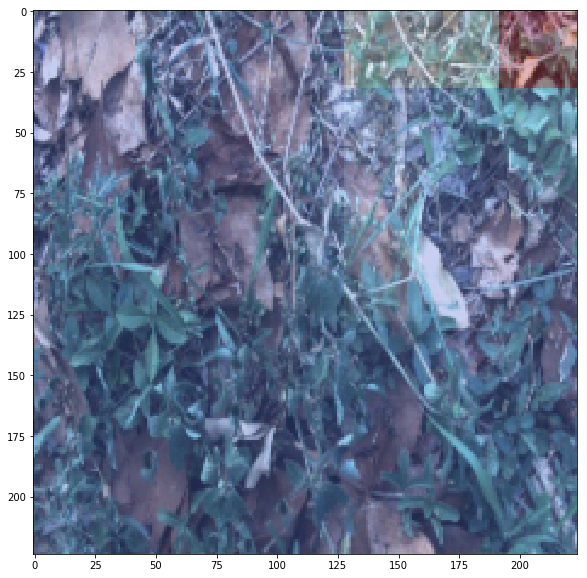

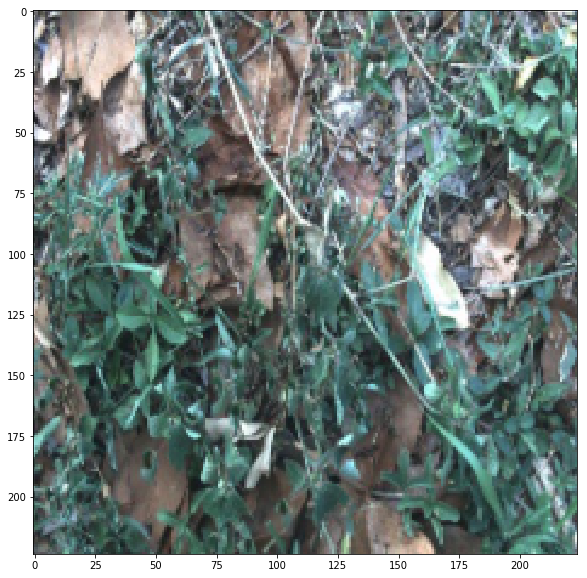

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([7.8507e-05, 1.4340e-04, 9.9933e-01, 2.6264e-05, 2.1732e-04, 7.2928e-05,
        1.7109e-05, 8.0462e-06, 1.0502e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.8470e-04, 4.0270e-04, 9.9539e-01, 3.0328e-04, 1.2139e-03, 1.1186e-03,
        5.3876e-05, 4.0123e-05, 1.1953e-03], device='cuda:0')
Class predictions according to model:  tensor([7.8507e-05, 1.4340e-04, 9.9933e-01, 2.6264e-05, 2.1732e-04, 7.2928e-05,
        1.7109e-05, 8.0462e-06, 1.0502e-04], device='cuda:0')
tensor([[0.0330, 0.0330, 0.0330,  ..., 0.0065, 0.0065, 0.0065],
        [0.0330, 0.0330, 0.0330,  ..., 0.0065, 0.0065, 0.0065],
        [0.0330, 0.0330, 0.0330,  ..., 0.0065, 0.0065, 0.0065],
        ...,
        [0.0494, 0.0494, 0.0494,  ..., 0.0004, 0.0004, 0.0004],
        [0.0494, 0.0494, 0.0494,  ..., 0.0004, 0.0004, 0.0004],
        [0.0494, 0.0494, 0.0494,  ...

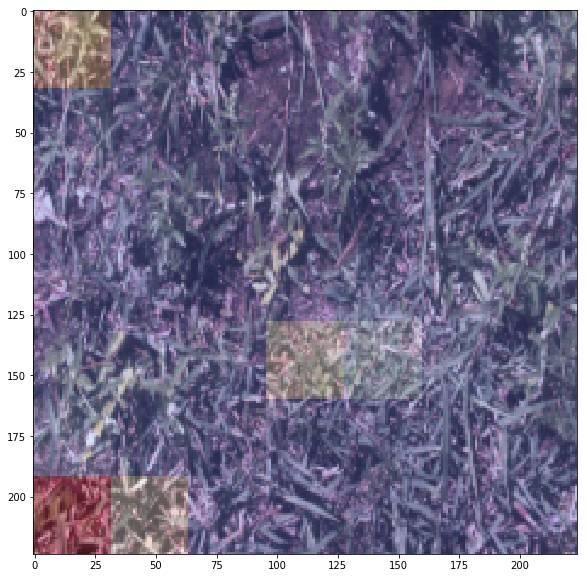

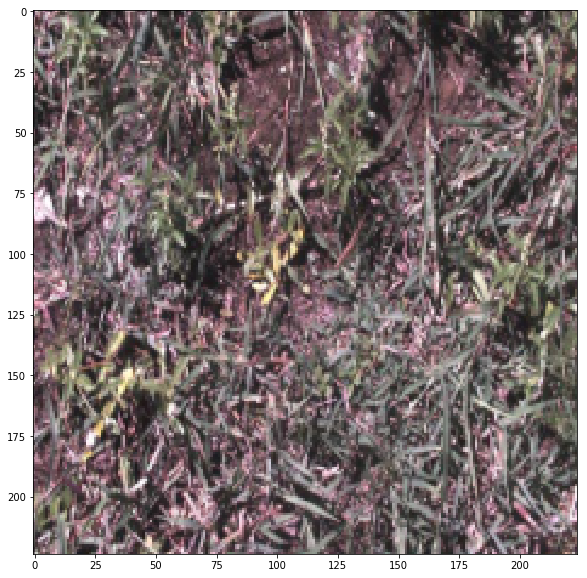

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.4503e-04, 1.9404e-05, 9.9973e-01, 1.4198e-05, 1.1998e-05, 9.5179e-06,
        2.0445e-05, 5.6363e-06, 4.8521e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.4703e-02, 1.5914e-03, 9.1664e-01, 2.1944e-03, 2.6302e-04, 3.4832e-04,
        1.1046e-03, 2.1398e-04, 2.2942e-02], device='cuda:0')
Class predictions according to model:  tensor([1.4503e-04, 1.9404e-05, 9.9973e-01, 1.4198e-05, 1.1998e-05, 9.5179e-06,
        2.0445e-05, 5.6363e-06, 4.8521e-05], device='cuda:0')
tensor([[8.9092e-02, 8.9092e-02, 8.9092e-02,  ..., 1.7589e-04, 1.7589e-04,
         1.7589e-04],
        [8.9092e-02, 8.9092e-02, 8.9092e-02,  ..., 1.7589e-04, 1.7589e-04,
         1.7589e-04],
        [8.9092e-02, 8.9092e-02, 8.9092e-02,  ..., 1.7589e-04, 1.7589e-04,
         1.7589e-04],
        ...,
        [9.0842e-01, 9.0842e-01, 9.0842e-01,  ..., 2.0784e-04, 2.0

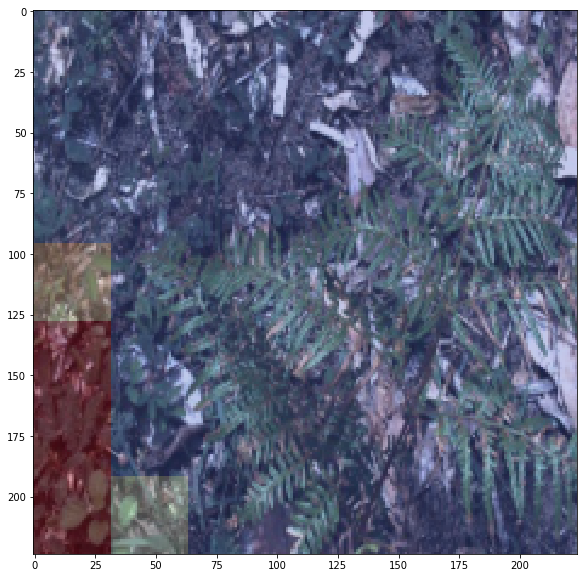

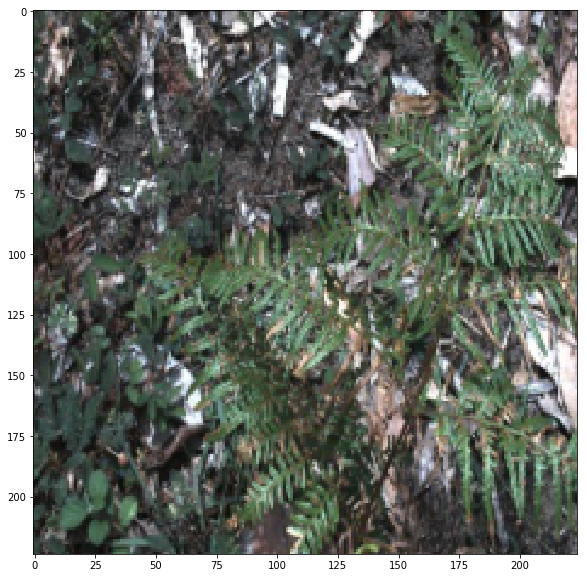

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([3.4750e-03, 2.0078e-04, 9.9561e-01, 5.5638e-05, 1.3453e-04, 2.6229e-04,
        1.7559e-05, 6.6060e-05, 1.7774e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.0270e-01, 4.8868e-03, 8.5048e-01, 2.4722e-04, 5.4125e-03, 1.5151e-02,
        3.1029e-04, 1.2384e-03, 1.9572e-02], device='cuda:0')
Class predictions according to model:  tensor([3.4750e-03, 2.0078e-04, 9.9561e-01, 5.5638e-05, 1.3453e-04, 2.6229e-04,
        1.7559e-05, 6.6060e-05, 1.7774e-04], device='cuda:0')
tensor([[2.1739e-02, 2.1739e-02, 2.1739e-02,  ..., 6.9022e-05, 6.9022e-05,
         6.9022e-05],
        [2.1739e-02, 2.1739e-02, 2.1739e-02,  ..., 6.9022e-05, 6.9022e-05,
         6.9022e-05],
        [2.1739e-02, 2.1739e-02, 2.1739e-02,  ..., 6.9022e-05, 6.9022e-05,
         6.9022e-05],
        ...,
        [3.4019e-01, 3.4019e-01, 3.4019e-01,  ..., 8.4036e-03, 8.4

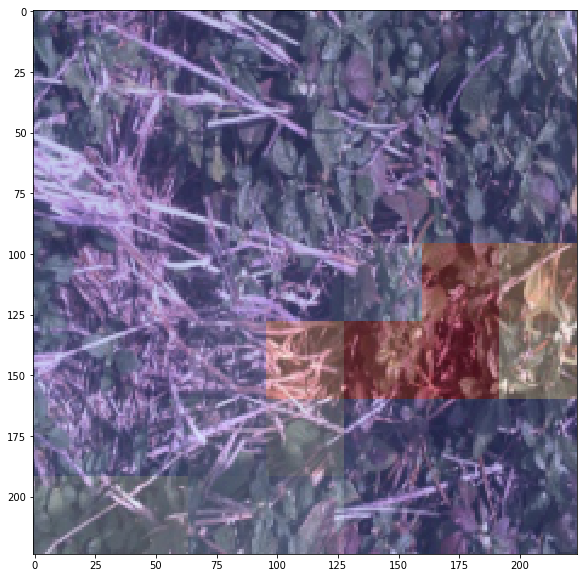

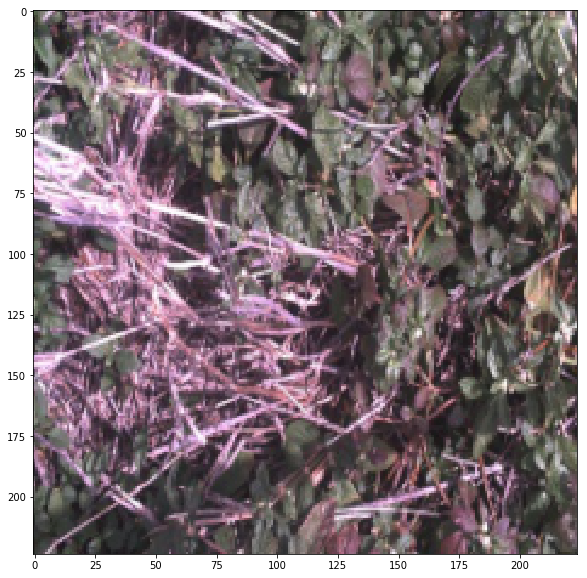

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([5.2950e-06, 2.9782e-06, 9.9994e-01, 3.1495e-06, 6.8468e-06, 2.4601e-06,
        5.5803e-06, 3.0329e-05, 6.4771e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([9.5393e-04, 1.6835e-04, 9.9019e-01, 4.9155e-04, 1.2960e-04, 1.0329e-03,
        3.9477e-04, 6.0225e-03, 6.1770e-04], device='cuda:0')
Class predictions according to model:  tensor([5.2950e-06, 2.9782e-06, 9.9994e-01, 3.1495e-06, 6.8468e-06, 2.4601e-06,
        5.5803e-06, 3.0329e-05, 6.4771e-06], device='cuda:0')
tensor([[0.0021, 0.0021, 0.0021,  ..., 0.0510, 0.0510, 0.0510],
        [0.0021, 0.0021, 0.0021,  ..., 0.0510, 0.0510, 0.0510],
        [0.0021, 0.0021, 0.0021,  ..., 0.0510, 0.0510, 0.0510],
        ...,
        [0.0342, 0.0342, 0.0342,  ..., 0.3089, 0.3089, 0.3089],
        [0.0342, 0.0342, 0.0342,  ..., 0.3089, 0.3089, 0.3089],
        [0.0342, 0.0342, 0.0342,  ...

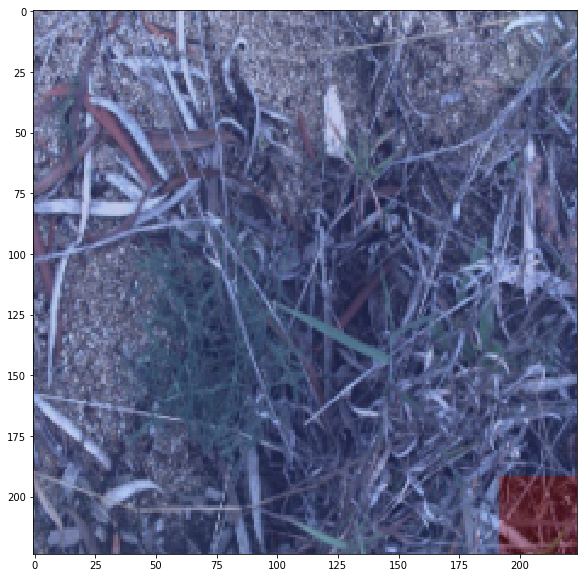

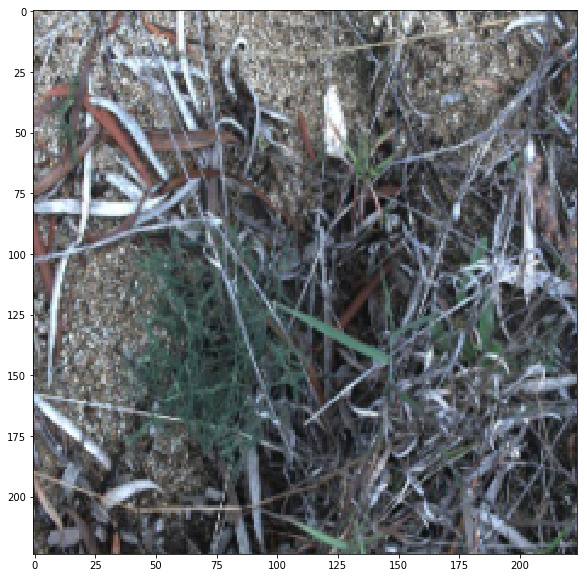

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([8.4967e-05, 1.2445e-05, 9.9969e-01, 5.8855e-06, 3.2006e-05, 3.8883e-06,
        1.8864e-06, 4.3648e-05, 1.2740e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.5109e-03, 2.0975e-03, 9.8711e-01, 2.0613e-04, 3.8355e-03, 5.2277e-04,
        2.5381e-05, 4.1340e-04, 4.2784e-03], device='cuda:0')
Class predictions according to model:  tensor([8.4967e-05, 1.2445e-05, 9.9969e-01, 5.8855e-06, 3.2006e-05, 3.8883e-06,
        1.8864e-06, 4.3648e-05, 1.2740e-04], device='cuda:0')
tensor([[1.5038e-01, 1.5038e-01, 1.5038e-01,  ..., 3.7909e-05, 3.7909e-05,
         3.7909e-05],
        [1.5038e-01, 1.5038e-01, 1.5038e-01,  ..., 3.7909e-05, 3.7909e-05,
         3.7909e-05],
        [1.5038e-01, 1.5038e-01, 1.5038e-01,  ..., 3.7909e-05, 3.7909e-05,
         3.7909e-05],
        ...,
        [4.4650e-04, 4.4650e-04, 4.4650e-04,  ..., 4.6552e-03, 4.6

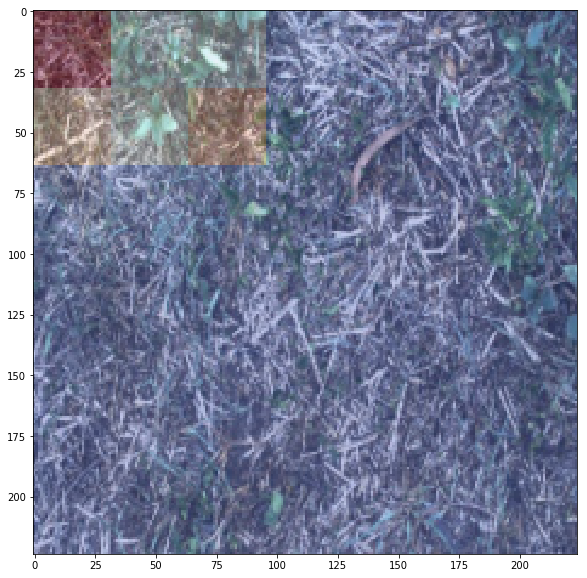

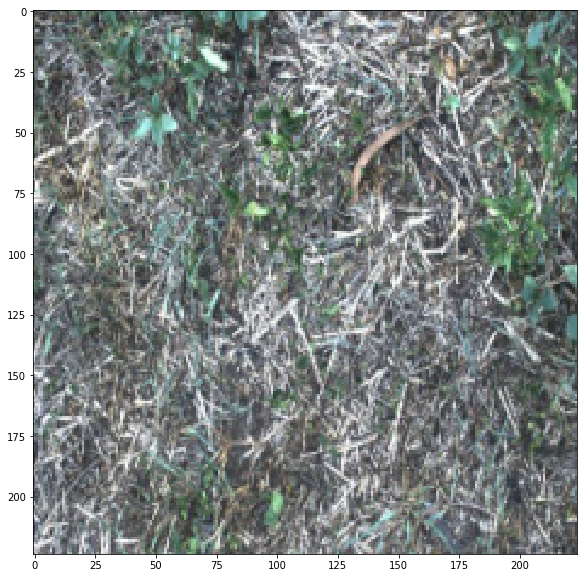

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([5.6990e-03, 3.3560e-05, 9.9417e-01, 1.4475e-05, 2.8066e-05, 5.2884e-06,
        1.5763e-05, 1.8690e-06, 3.6845e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.7306e-01, 2.1244e-04, 8.2619e-01, 8.6456e-05, 2.1138e-04, 2.1722e-05,
        4.4594e-05, 6.5188e-06, 1.7551e-04], device='cuda:0')
Class predictions according to model:  tensor([5.6990e-03, 3.3560e-05, 9.9417e-01, 1.4475e-05, 2.8066e-05, 5.2884e-06,
        1.5763e-05, 1.8690e-06, 3.6845e-05], device='cuda:0')
tensor([[0.0086, 0.0086, 0.0086,  ..., 0.0024, 0.0024, 0.0024],
        [0.0086, 0.0086, 0.0086,  ..., 0.0024, 0.0024, 0.0024],
        [0.0086, 0.0086, 0.0086,  ..., 0.0024, 0.0024, 0.0024],
        ...,
        [0.0113, 0.0113, 0.0113,  ..., 0.0307, 0.0307, 0.0307],
        [0.0113, 0.0113, 0.0113,  ..., 0.0307, 0.0307, 0.0307],
        [0.0113, 0.0113, 0.0113,  ...

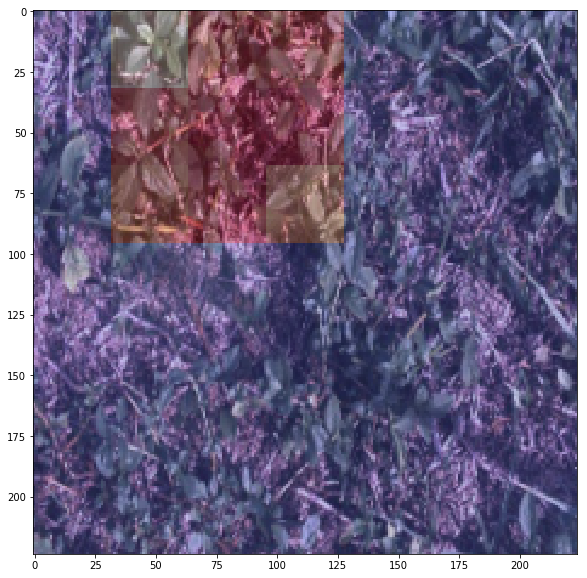

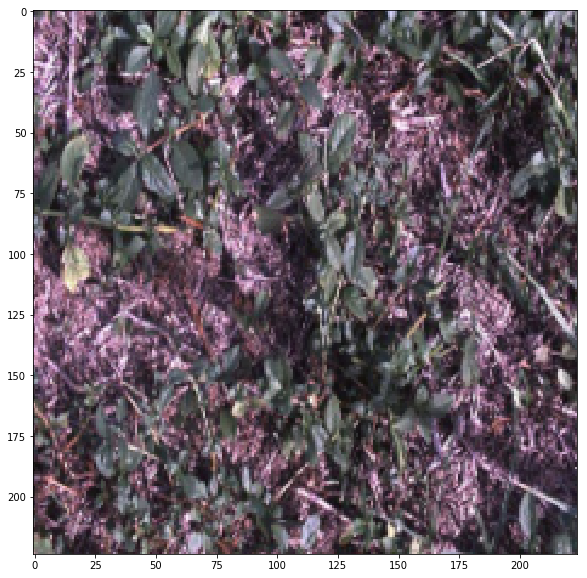

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.7372e-05, 9.9349e-06, 9.9972e-01, 1.5996e-04, 2.9048e-05, 7.5964e-06,
        3.4306e-05, 6.2166e-06, 1.7349e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([5.6934e-05, 3.7242e-05, 9.9567e-01, 3.0434e-03, 6.4292e-04, 1.6695e-04,
        2.7127e-04, 2.8889e-05, 7.9489e-05], device='cuda:0')
Class predictions according to model:  tensor([1.7372e-05, 9.9349e-06, 9.9972e-01, 1.5996e-04, 2.9048e-05, 7.5964e-06,
        3.4306e-05, 6.2166e-06, 1.7349e-05], device='cuda:0')
tensor([[0.0281, 0.0281, 0.0281,  ..., 0.0623, 0.0623, 0.0623],
        [0.0281, 0.0281, 0.0281,  ..., 0.0623, 0.0623, 0.0623],
        [0.0281, 0.0281, 0.0281,  ..., 0.0623, 0.0623, 0.0623],
        ...,
        [0.0052, 0.0052, 0.0052,  ..., 0.0013, 0.0013, 0.0013],
        [0.0052, 0.0052, 0.0052,  ..., 0.0013, 0.0013, 0.0013],
        [0.0052, 0.0052, 0.0052,  ...

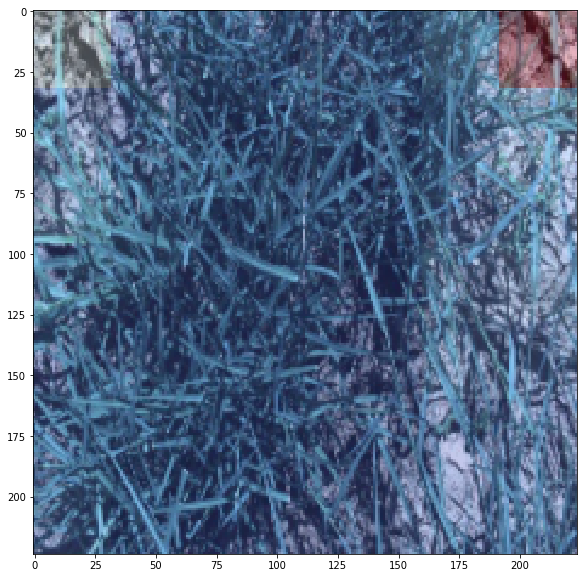

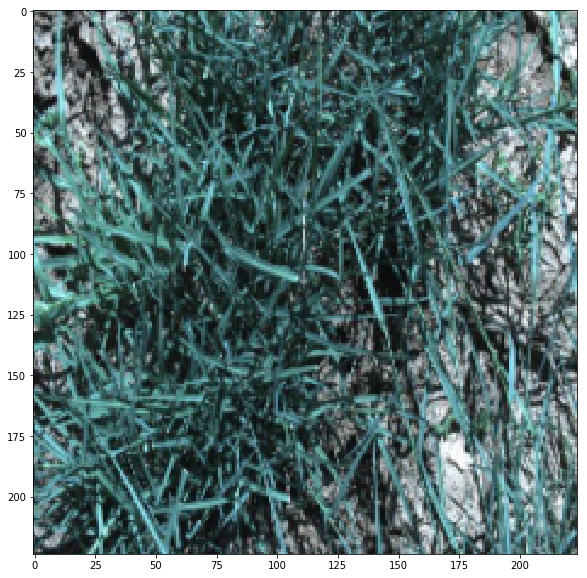

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.2864e-06, 2.7689e-06, 9.9999e-01, 6.8309e-07, 1.3901e-06, 5.6355e-07,
        8.3389e-07, 7.1319e-07, 1.6211e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.1693e-05, 6.4431e-05, 9.9972e-01, 1.5319e-05, 8.4560e-05, 1.7234e-05,
        1.8775e-05, 3.5897e-05, 3.2567e-05], device='cuda:0')
Class predictions according to model:  tensor([1.2864e-06, 2.7689e-06, 9.9999e-01, 6.8309e-07, 1.3901e-06, 5.6355e-07,
        8.3389e-07, 7.1319e-07, 1.6211e-06], device='cuda:0')
tensor([[7.5758e-03, 7.5758e-03, 7.5758e-03,  ..., 1.9073e-06, 1.9073e-06,
         1.9073e-06],
        [7.5758e-03, 7.5758e-03, 7.5758e-03,  ..., 1.9073e-06, 1.9073e-06,
         1.9073e-06],
        [7.5758e-03, 7.5758e-03, 7.5758e-03,  ..., 1.9073e-06, 1.9073e-06,
         1.9073e-06],
        ...,
        [2.6226e-05, 2.6226e-05, 2.6226e-05,  ..., 4.3750e-05, 4.3

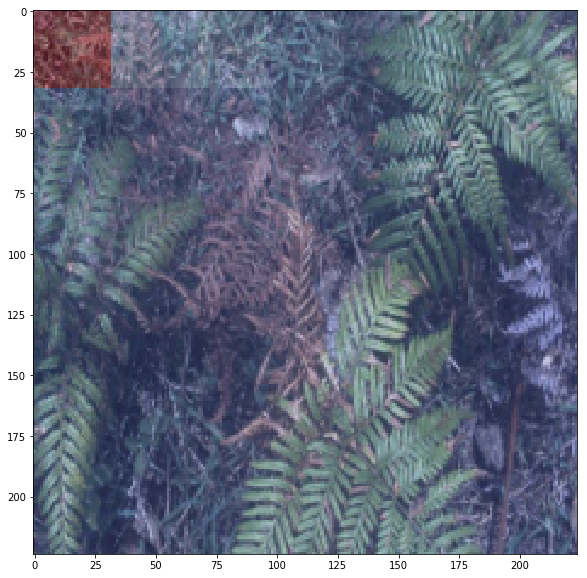

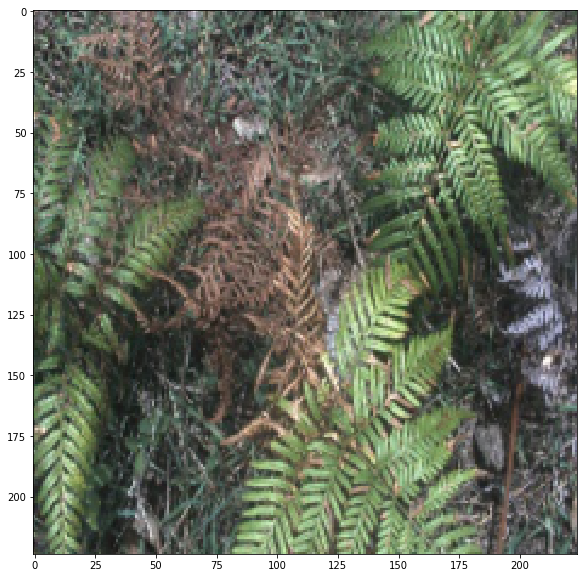

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([1.1617e-05, 1.1754e-05, 9.9986e-01, 5.7538e-06, 1.4650e-05, 2.6199e-06,
        1.6352e-05, 6.9556e-05, 1.2219e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.2695e-04, 4.7623e-04, 9.6171e-01, 1.1955e-03, 5.8590e-03, 2.4164e-04,
        2.3971e-03, 2.7008e-02, 3.8802e-04], device='cuda:0')
Class predictions according to model:  tensor([1.1617e-05, 1.1754e-05, 9.9986e-01, 5.7537e-06, 1.4650e-05, 2.6199e-06,
        1.6352e-05, 6.9556e-05, 1.2219e-05], device='cuda:0')
tensor([[0.0444, 0.0444, 0.0444,  ..., 0.0043, 0.0043, 0.0043],
        [0.0444, 0.0444, 0.0444,  ..., 0.0043, 0.0043, 0.0043],
        [0.0444, 0.0444, 0.0444,  ..., 0.0043, 0.0043, 0.0043],
        ...,
        [0.3919, 0.3919, 0.3919,  ..., 0.6800, 0.6800, 0.6800],
        [0.3919, 0.3919, 0.3919,  ..., 0.6800, 0.6800, 0.6800],
        [0.3919, 0.3919, 0.3919,  ...

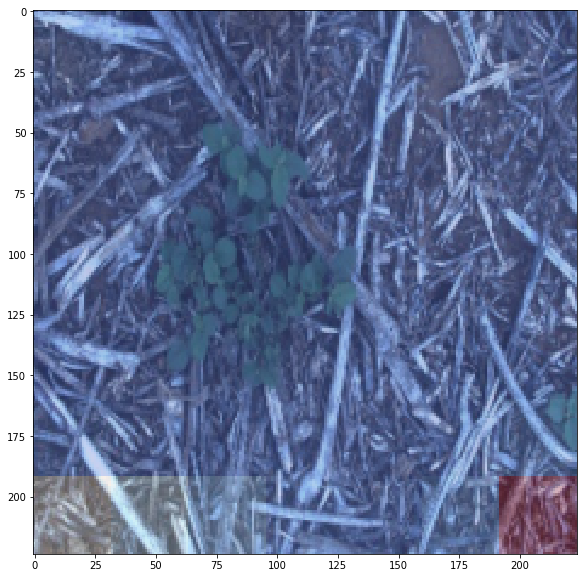

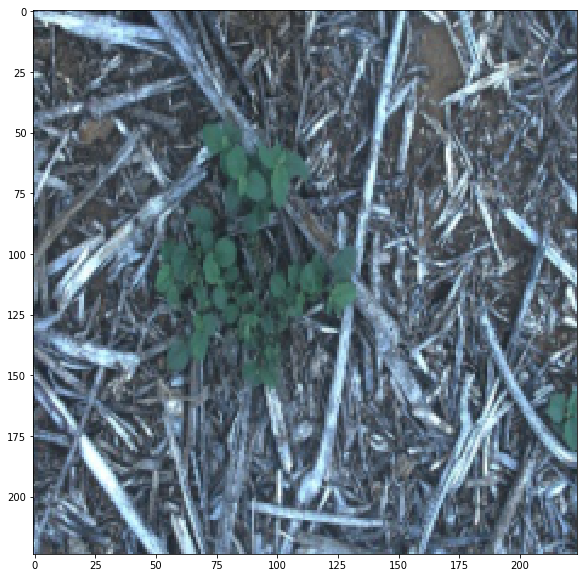

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([8.4421e-04, 6.2234e-03, 9.9254e-01, 3.9872e-05, 3.1913e-05, 6.1753e-06,
        1.2179e-04, 4.6466e-05, 1.4721e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.3310e-01, 9.2787e-02, 7.6514e-01, 2.5230e-04, 2.1843e-04, 4.1898e-05,
        1.0980e-03, 3.3841e-04, 7.0274e-03], device='cuda:0')
Class predictions according to model:  tensor([8.4421e-04, 6.2234e-03, 9.9254e-01, 3.9872e-05, 3.1913e-05, 6.1753e-06,
        1.2179e-04, 4.6466e-05, 1.4721e-04], device='cuda:0')
tensor([[0.1737, 0.1737, 0.1737,  ..., 0.0477, 0.0477, 0.0477],
        [0.1737, 0.1737, 0.1737,  ..., 0.0477, 0.0477, 0.0477],
        [0.1737, 0.1737, 0.1737,  ..., 0.0477, 0.0477, 0.0477],
        ...,
        [0.7998, 0.7998, 0.7998,  ..., 0.3159, 0.3159, 0.3159],
        [0.7998, 0.7998, 0.7998,  ..., 0.3159, 0.3159, 0.3159],
        [0.7998, 0.7998, 0.7998,  ...

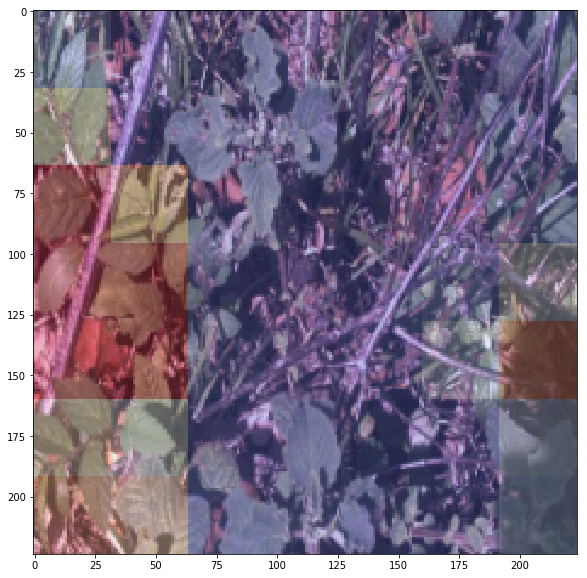

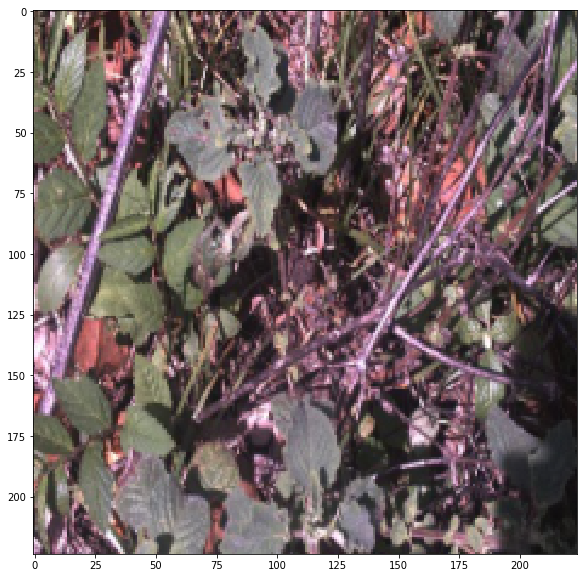

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([4.0242e-05, 2.5970e-05, 9.9974e-01, 9.0837e-05, 2.7011e-05, 9.6914e-06,
        1.7079e-05, 7.8659e-06, 4.3404e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([4.2028e-03, 3.6167e-04, 9.6529e-01, 1.7488e-02, 3.3032e-04, 8.6138e-03,
        2.8974e-04, 4.0510e-04, 3.0157e-03], device='cuda:0')
Class predictions according to model:  tensor([4.0242e-05, 2.5970e-05, 9.9974e-01, 9.0837e-05, 2.7011e-05, 9.6914e-06,
        1.7079e-05, 7.8659e-06, 4.3404e-05], device='cuda:0')
tensor([[3.4190e-01, 3.4190e-01, 3.4190e-01,  ..., 1.3555e-03, 1.3555e-03,
         1.3555e-03],
        [3.4190e-01, 3.4190e-01, 3.4190e-01,  ..., 1.3555e-03, 1.3555e-03,
         1.3555e-03],
        [3.4190e-01, 3.4190e-01, 3.4190e-01,  ..., 1.3555e-03, 1.3555e-03,
         1.3555e-03],
        ...,
        [8.2237e-03, 8.2237e-03, 8.2237e-03,  ..., 1.5008e-04, 1.5

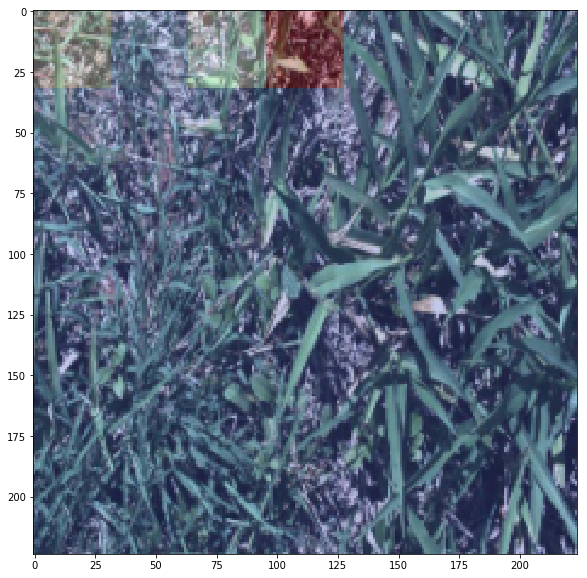

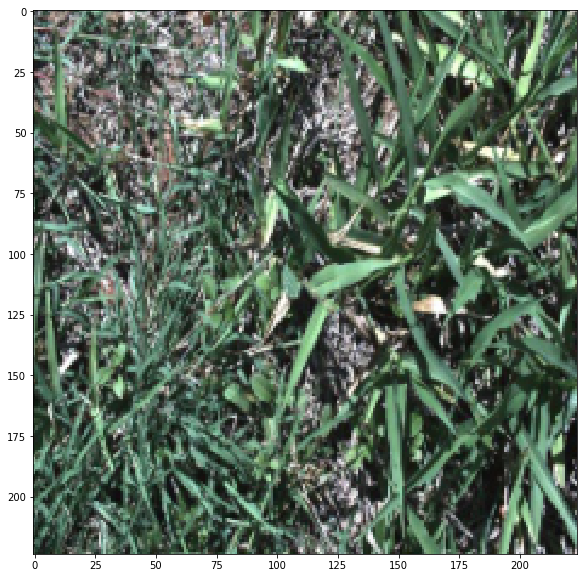

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([7.0678e-06, 1.0032e-05, 9.9993e-01, 6.1228e-06, 7.7059e-06, 2.4292e-06,
        1.0503e-05, 9.3794e-06, 1.2985e-05], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([1.0310e-04, 1.2839e-04, 9.9894e-01, 2.1147e-04, 8.0528e-05, 8.1666e-05,
        1.0036e-04, 1.0831e-04, 2.4293e-04], device='cuda:0')
Class predictions according to model:  tensor([7.0678e-06, 1.0032e-05, 9.9993e-01, 6.1228e-06, 7.7059e-06, 2.4292e-06,
        1.0503e-05, 9.3794e-06, 1.2985e-05], device='cuda:0')
tensor([[2.0934e-02, 2.0934e-02, 2.0934e-02,  ..., 1.1206e-05, 1.1206e-05,
         1.1206e-05],
        [2.0934e-02, 2.0934e-02, 2.0934e-02,  ..., 1.1206e-05, 1.1206e-05,
         1.1206e-05],
        [2.0934e-02, 2.0934e-02, 2.0934e-02,  ..., 1.1206e-05, 1.1206e-05,
         1.1206e-05],
        ...,
        [2.8358e-03, 2.8358e-03, 2.8358e-03,  ..., 3.0994e-06, 3.0

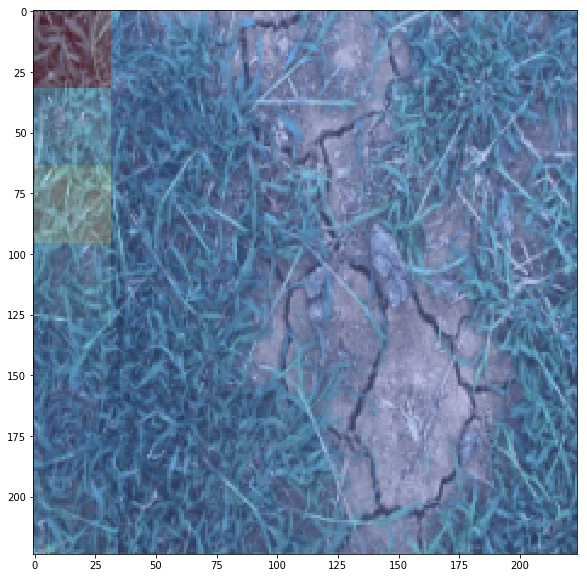

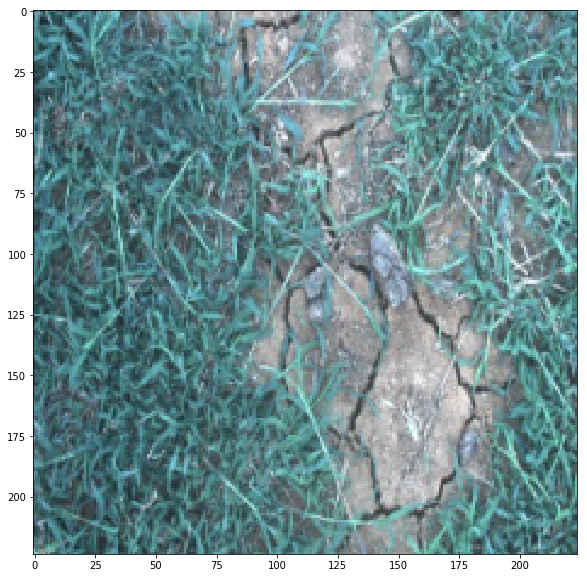

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([6.9984e-06, 2.3376e-06, 9.9992e-01, 3.5012e-06, 8.9875e-06, 3.4945e-06,
        4.1484e-05, 3.0587e-06, 8.2200e-06], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([2.4746e-05, 9.5656e-06, 9.9971e-01, 2.3725e-05, 7.6988e-05, 1.5438e-05,
        7.9835e-05, 2.4599e-05, 3.2777e-05], device='cuda:0')
Class predictions according to model:  tensor([6.9984e-06, 2.3376e-06, 9.9992e-01, 3.5012e-06, 8.9875e-06, 3.4945e-06,
        4.1484e-05, 3.0587e-06, 8.2200e-06], device='cuda:0')
tensor([[0.0014, 0.0014, 0.0014,  ..., 0.0073, 0.0073, 0.0073],
        [0.0014, 0.0014, 0.0014,  ..., 0.0073, 0.0073, 0.0073],
        [0.0014, 0.0014, 0.0014,  ..., 0.0073, 0.0073, 0.0073],
        ...,
        [0.0001, 0.0001, 0.0001,  ..., 0.0005, 0.0005, 0.0005],
        [0.0001, 0.0001, 0.0001,  ..., 0.0005, 0.0005, 0.0005],
        [0.0001, 0.0001, 0.0001,  ...

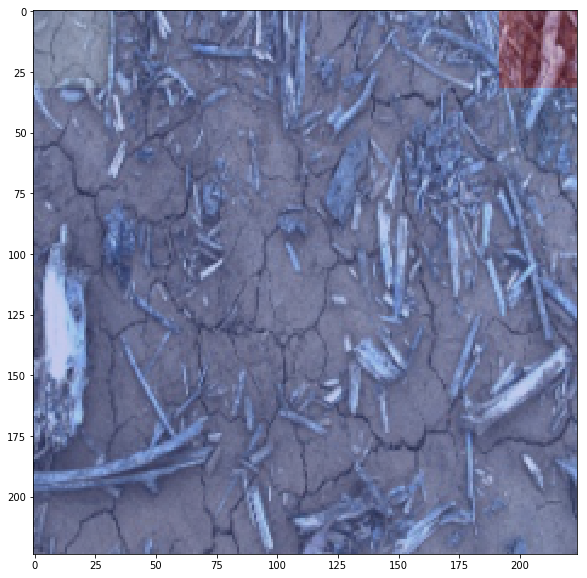

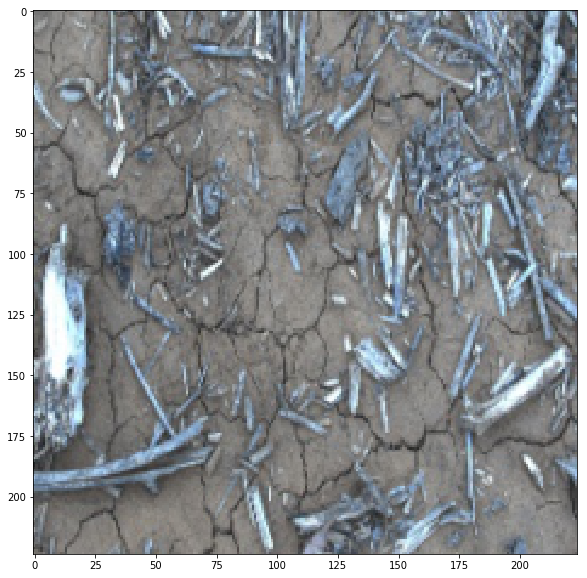

torch.Size([1, 3, 224, 224]) negatives tensor([2], device='cuda:0')
torch.Size([9, 7, 7])
Class predictions:  tensor([2.0565e-03, 5.0197e-06, 9.9761e-01, 3.7594e-05, 3.6629e-05, 3.4863e-06,
        8.2572e-06, 3.2635e-06, 2.4274e-04], device='cuda:0')
Class predictions avged over pixels (should be same):  tensor([7.5869e-02, 3.0556e-04, 9.0932e-01, 7.5617e-04, 1.6629e-03, 1.5683e-04,
        1.4026e-04, 7.3421e-05, 1.1720e-02], device='cuda:0')
Class predictions according to model:  tensor([2.0565e-03, 5.0197e-06, 9.9761e-01, 3.7594e-05, 3.6629e-05, 3.4863e-06,
        8.2572e-06, 3.2635e-06, 2.4274e-04], device='cuda:0')
tensor([[0.0310, 0.0310, 0.0310,  ..., 0.5907, 0.5907, 0.5907],
        [0.0310, 0.0310, 0.0310,  ..., 0.5907, 0.5907, 0.5907],
        [0.0310, 0.0310, 0.0310,  ..., 0.5907, 0.5907, 0.5907],
        ...,
        [0.8847, 0.8847, 0.8847,  ..., 0.0012, 0.0012, 0.0012],
        [0.8847, 0.8847, 0.8847,  ..., 0.0012, 0.0012, 0.0012],
        [0.8847, 0.8847, 0.8847,  ...

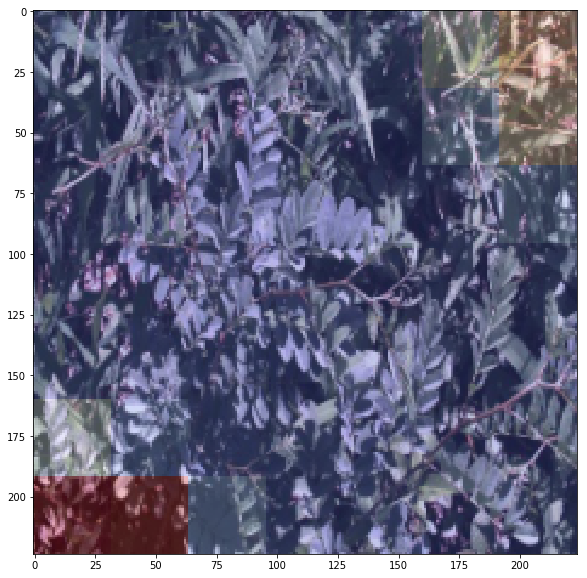

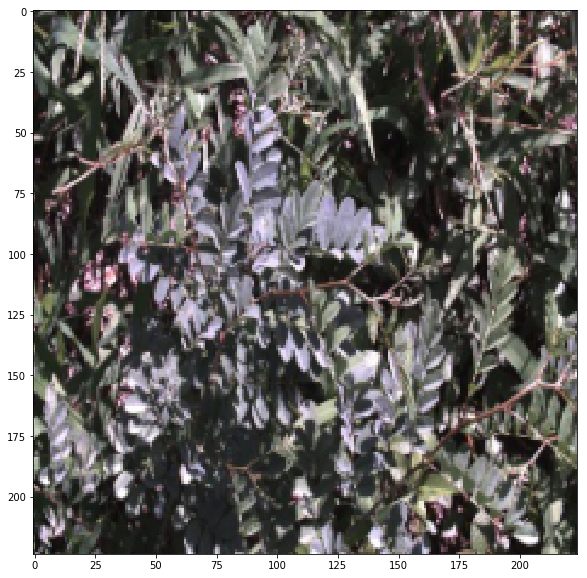

In [45]:

negative_class = class_names.index('negatives')

negative_weed_prob_preds = []

num_done = 0

for img, label in dataloader_test_1:
    if int(label) != negative_class: continue
    num_done += 1
    if num_done > 40: break
    
    img = img.to(device)
    label = label.to(device)
    img_rgb = img.squeeze()
    print(img.shape, class_names[label], label)
    std = torch.Tensor([.229, .224, .225]).reshape(3,1,1).to(device)
    mean = torch.Tensor([.485, .456, .406]).reshape(3,1,1).to(device)
    rescaled_image = img_rgb * std + mean

    grid_activations = final_model.model.forward(img, True).squeeze().detach()
    true_predictions = final_model.model.forward(img).squeeze().detach()
    print(grid_activations.shape)

    per_pixel_class_probs = torch.nn.Softmax(dim=(0))(grid_activations.squeeze())


    class_predictions = torch.nn.Softmax(dim=0)(torch.mean(grid_activations, dim=(1,2)))
    print('Class predictions: ', class_predictions)
    print('Class predictions avged over pixels (should be same): ', 
          per_pixel_class_probs.mean(dim=(1,2)))
    print('Class predictions according to model: ', torch.nn.Softmax(dim=0)(true_predictions))

    show(rescaled_image.cpu())
    per_pixel_prob_weed = 1. - per_pixel_class_probs[negative_class,:,:]
    weed_mask = per_pixel_prob_weed.reshape(7,1,7,1) * torch.ones((7,32,7,32)).to(device)
    weed_mask = weed_mask.reshape((224,224)).cpu()
    #weed_mask = weed_mask * (weed_mask > 0.5).float()
    print(weed_mask, weed_mask.mean())
    plt.imshow(weed_mask, cmap='coolwarm', alpha=0.3)
    negative_weed_prob_preds.append(per_pixel_prob_weed)
    plt.show()

    show(rescaled_image.cpu())
    plt.show()

In [46]:
negative_preds = np.array(torch.stack(negative_weed_prob_preds).cpu()).reshape(-1)
negative_labels = np.zeros_like(negative_preds)

In [47]:
all_preds = np.concatenate((weed_preds.reshape(-1), negative_preds))
all_labels = np.concatenate((true_labels.reshape(-1), negative_labels))
print(all_preds.shape, all_labels.shape)

(3920,) (3920,)


In [48]:
all_auc_score = roc_auc_score(y_score=all_preds, y_true=all_labels)
print(all_auc_score)
fpr, tpr, thresholds = roc_curve(all_labels, all_preds)

0.8992144071509152


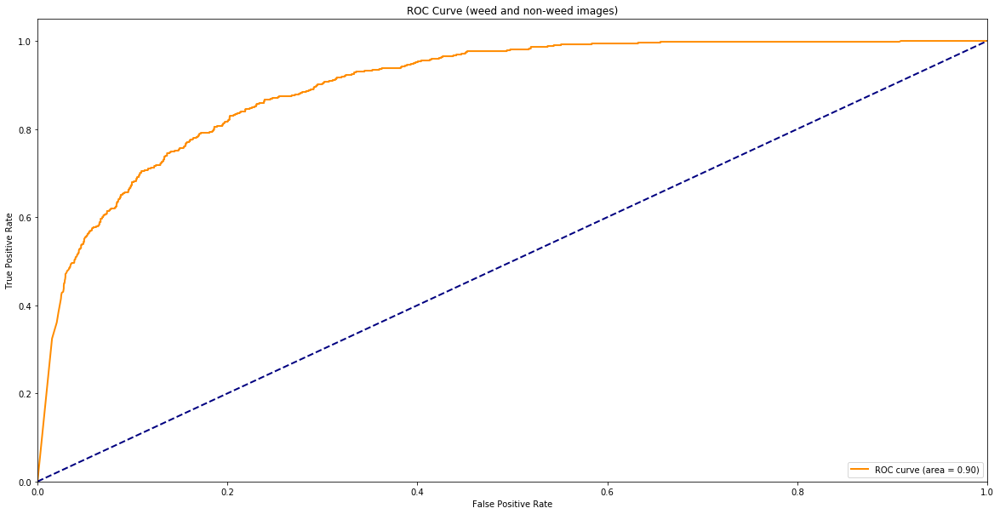

In [49]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % all_auc_score)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve (weed and non-weed images)')
plt.legend(loc="lower right")
plt.show()

In [60]:
i = 415
fpr[i], tpr[i], thresholds[i]

(0.39300411522633744, 0.9459459459459459, 0.2563054)

In [51]:
precisions_all, recalls_all, thresholds_all = precision_recall_curve(
    y_true=all_labels, probas_pred=all_preds)

In [68]:
j = 1596
precisions_all[j], recalls_all[j], thresholds_all[j]

(0.2681992337164751, 0.9459459459459459, 0.2563054)